Cyna Shirazinejad, 7/7/21

# Notebook 15: analyze scission-present ARPC3+ CCPs, 'zero' padding

outline:
* comparison of lifetimes of ARPC3+/- CCPs
* comparison of aligned intensities of ARPC3+/- CCPs

##### import all necessary Python modules

In [119]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
import numpy as np
import pandas as pd
import sys
import matplotlib.pyplot as plt
import pickle
from IPython.display import Image
from scipy import signal
import scipy.stats as stats
import seaborn as sns
import matplotlib as mpl
analysis_metadata = np.load('analysis_metadata.npy', allow_pickle=True)
sys.path.append(analysis_metadata.item().get('path_notebook')+'/cmeAnalysisPostProcessingSimplified') # add custom Python scripts to the local path
import generate_index_dictionary
import return_track_attributes
import display_tracks
index_dictionary = generate_index_dictionary.return_index_dictionary()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# load files

In [120]:
path_outputs = analysis_metadata.item().get('path_outputs')

In [121]:
experiment = 'ada_wildtype'

with open(path_outputs+'/dataframes/'+experiment+'_merged_ccp_attributes', 'rb') as f:
    merged_results = pickle.load(f)  

sig_arpc3_dnm2_peak = merged_results['significant_arpc3_at_dnm2_peak_arpc3_positive']
indices_sig_arpc3_dnm2_peak = np.where(np.array(sig_arpc3_dnm2_peak)==1)[0]

experiment_number_arpc3_positive_sigdnm2_wt = merged_results['experiment_number_arpc3_positive_sigdnm2']
ap2_arpc3_separation_at_dnm2_peak_arpc3_positive_wt = list(np.array(merged_results['ap2_arpc3_separation_at_dnm2_peak_arpc3_positive'])[indices_sig_arpc3_dnm2_peak])
absolute_ap2_x_position_arpc3_positive_wt = list(np.array(merged_results['absolute_ap2_x_position_arpc3_positive'], dtype='object'))
absolute_ap2_y_position_arpc3_positive_wt = list(np.array(merged_results['absolute_ap2_y_position_arpc3_positive'], dtype='object'))
time_ap2_appearance_to_dnm2_peak_arpc3_positive_wt = list(np.array(merged_results['time_ap2_appearance_to_dnm2_peak_arpc3_positive'])[indices_sig_arpc3_dnm2_peak])
max_ap2_int_wt = list(np.array(merged_results['maximum_ap2_intensity_arpc3_positive'])[indices_sig_arpc3_dnm2_peak])

print(len(experiment_number_arpc3_positive_sigdnm2_wt),
      len(ap2_arpc3_separation_at_dnm2_peak_arpc3_positive_wt), 
      len(absolute_ap2_x_position_arpc3_positive_wt))

1385 1385 1385


In [122]:
merged_results.keys()

dict_keys(['ch0_vectors_arpc3_positive', 'ch1_vectors_arpc3_positive', 'ch2_vectors_arpc3_positive', 'channel_0_1_separations_arpc3_positive', 'channel_0_2_separations_arpc3_positive', 'channel_1_2_separations_arpc3_positive', 'final_separations_ap2arpc3_arpc3_positive', 'initial_separations_ap2arpc3_arpc3_positive', 'ap2_arpc3_separation_at_dnm2_peak_arpc3_positive', 'ap2_arpc3_separation_at_arpc3_peak_arpc3_positive', 'ap2_arpc3_separation_at_ap2_peak_arpc3_positive', 'ap2_lifetime_arpc3_positive', 'arpc3_lifetime_arpc3_positive', 'max_separation_ap2_arpc3_arpc3_positive', 'max_separation_ap2_dnm2_arpc3_positive', 'max_separation_dnm2_arpc3_arpc3_positive', 'num_frames_associated_arpc3_positive', 'time_ap2_appearance_to_dnm2_peak_arpc3_positive', 'maximum_ap2_intensity_arpc3_positive', 'maximum_dnm2_intensity_arpc3_positive', 'maximum_arpc3_intensity_arpc3_positive', 'pval_arpc3_ccps_arpc3_positive', 'time_arpc3_appearance_to_dnm2_peak_arpc3_positive', 'fraction_arpc3_positive', 'ccp

In [123]:
channel_amplitudes_arpc3_positive = []
for i in range(len(merged_results['ch0_vectors_arpc3_positive'])):
    channel_amplitudes_arpc3_positive.append([merged_results['ch0_vectors_arpc3_positive'][i],
                                              merged_results['ch1_vectors_arpc3_positive'][i],
                                              merged_results['ch2_vectors_arpc3_positive'][i],
                                              merged_results['channel_0_1_separations_arpc3_positive'][i],
                                              merged_results['channel_0_2_separations_arpc3_positive'][i],
                                              merged_results['channel_1_2_separations_arpc3_positive'][i]])
channel_amplitudes_arpc3_positive_wt = np.array(channel_amplitudes_arpc3_positive, dtype='object')[indices_sig_arpc3_dnm2_peak]

In [124]:
experiment = 'ada_ck666_nt'

with open(path_outputs+'/dataframes/'+experiment+'_merged_ccp_attributes', 'rb') as f:
    merged_results = pickle.load(f)  

sig_arpc3_dnm2_peak = merged_results['significant_arpc3_at_dnm2_peak_arpc3_positive']
indices_sig_arpc3_dnm2_peak = np.where(np.array(sig_arpc3_dnm2_peak)==1)[0]

experiment_number_arpc3_positive_sigdnm2_ck666_nt = merged_results['experiment_number_arpc3_positive_sigdnm2']
ap2_arpc3_separation_at_dnm2_peak_arpc3_positive_ck666_nt = list(np.array(merged_results['ap2_arpc3_separation_at_dnm2_peak_arpc3_positive'])[indices_sig_arpc3_dnm2_peak])
absolute_ap2_x_position_arpc3_positive_ck666_nt = list(np.array(merged_results['absolute_ap2_x_position_arpc3_positive'], dtype='object'))
absolute_ap2_y_position_arpc3_positive_ck666_nt = list(np.array(merged_results['absolute_ap2_y_position_arpc3_positive'], dtype='object'))
time_ap2_appearance_to_dnm2_peak_arpc3_positive_nt = list(np.array(merged_results['time_ap2_appearance_to_dnm2_peak_arpc3_positive'])[indices_sig_arpc3_dnm2_peak])
max_ap2_int_nt = list(np.array(merged_results['maximum_ap2_intensity_arpc3_positive'])[indices_sig_arpc3_dnm2_peak])

print(len(experiment_number_arpc3_positive_sigdnm2_ck666_nt),
      len(ap2_arpc3_separation_at_dnm2_peak_arpc3_positive_ck666_nt), 
      len(absolute_ap2_x_position_arpc3_positive_ck666_nt))

1352 1352 1352


In [125]:
channel_amplitudes_arpc3_positive = []
for i in range(len(merged_results['ch0_vectors_arpc3_positive'])):
    channel_amplitudes_arpc3_positive.append([merged_results['ch0_vectors_arpc3_positive'][i],
                                              merged_results['ch1_vectors_arpc3_positive'][i],
                                              merged_results['ch2_vectors_arpc3_positive'][i],
                                              merged_results['channel_0_1_separations_arpc3_positive'][i],
                                              merged_results['channel_0_2_separations_arpc3_positive'][i],
                                              merged_results['channel_1_2_separations_arpc3_positive'][i]])
channel_amplitudes_arpc3_positive_nt = np.array(channel_amplitudes_arpc3_positive, dtype='object')[indices_sig_arpc3_dnm2_peak]

In [126]:
experiment = 'ada_hypotonic_before'

with open(path_outputs+'/dataframes/'+experiment+'_merged_ccp_attributes', 'rb') as f:
    merged_results = pickle.load(f)  

sig_arpc3_dnm2_peak = merged_results['significant_arpc3_at_dnm2_peak_arpc3_positive']
indices_sig_arpc3_dnm2_peak = np.where(np.array(sig_arpc3_dnm2_peak)==1)[0]

experiment_number_arpc3_positive_sigdnm2_hypotonic_before = merged_results['experiment_number_arpc3_positive_sigdnm2']
ap2_arpc3_separation_at_dnm2_peak_arpc3_positive_hypotonic_before = list(np.array(merged_results['ap2_arpc3_separation_at_dnm2_peak_arpc3_positive'])[indices_sig_arpc3_dnm2_peak])
absolute_ap2_x_position_arpc3_positive_hypotonic_before = list(np.array(merged_results['absolute_ap2_x_position_arpc3_positive'], dtype='object'))
absolute_ap2_y_position_arpc3_positive_hypotonic_before = list(np.array(merged_results['absolute_ap2_y_position_arpc3_positive'], dtype='object'))
time_ap2_appearance_to_dnm2_peak_arpc3_positive_before = list(np.array(merged_results['time_ap2_appearance_to_dnm2_peak_arpc3_positive'])[indices_sig_arpc3_dnm2_peak])
max_ap2_int_before = list(np.array(merged_results['maximum_ap2_intensity_arpc3_positive'])[indices_sig_arpc3_dnm2_peak])

print(len(experiment_number_arpc3_positive_sigdnm2_hypotonic_before),
      len(ap2_arpc3_separation_at_dnm2_peak_arpc3_positive_hypotonic_before), 
      len(absolute_ap2_x_position_arpc3_positive_hypotonic_before))

1175 1175 1175


In [127]:
channel_amplitudes_arpc3_positive = []
for i in range(len(merged_results['ch0_vectors_arpc3_positive'])):
    channel_amplitudes_arpc3_positive.append([merged_results['ch0_vectors_arpc3_positive'][i],
                                              merged_results['ch1_vectors_arpc3_positive'][i],
                                              merged_results['ch2_vectors_arpc3_positive'][i],
                                              merged_results['channel_0_1_separations_arpc3_positive'][i],
                                              merged_results['channel_0_2_separations_arpc3_positive'][i],
                                              merged_results['channel_1_2_separations_arpc3_positive'][i]])
channel_amplitudes_arpc3_positive_before = np.array(channel_amplitudes_arpc3_positive, dtype='object')[indices_sig_arpc3_dnm2_peak]

In [128]:
channel_amplitudes_arpc3_positive = np.concatenate((channel_amplitudes_arpc3_positive_wt, 
                                                    channel_amplitudes_arpc3_positive_nt,
                                                    channel_amplitudes_arpc3_positive_before))

In [129]:
len(channel_amplitudes_arpc3_positive[-1])

6

In [130]:
channel_amplitudes_arpc3_positive.shape

(3912, 6)

In [131]:
exp_num_merged = experiment_number_arpc3_positive_sigdnm2_wt + experiment_number_arpc3_positive_sigdnm2_ck666_nt + experiment_number_arpc3_positive_sigdnm2_hypotonic_before
separation_merged = ap2_arpc3_separation_at_dnm2_peak_arpc3_positive_wt + ap2_arpc3_separation_at_dnm2_peak_arpc3_positive_ck666_nt + ap2_arpc3_separation_at_dnm2_peak_arpc3_positive_hypotonic_before
absolute_x_merged = absolute_ap2_x_position_arpc3_positive_wt + absolute_ap2_x_position_arpc3_positive_ck666_nt + absolute_ap2_x_position_arpc3_positive_hypotonic_before
absolute_y_merged = absolute_ap2_y_position_arpc3_positive_wt + absolute_ap2_y_position_arpc3_positive_ck666_nt + absolute_ap2_y_position_arpc3_positive_hypotonic_before
ccp_lifetime_merged = time_ap2_appearance_to_dnm2_peak_arpc3_positive_wt + time_ap2_appearance_to_dnm2_peak_arpc3_positive_nt + time_ap2_appearance_to_dnm2_peak_arpc3_positive_before
max_ap2_merged = max_ap2_int_wt + max_ap2_int_nt + max_ap2_int_before

In [132]:
# separation_quantiles = pd.qcut(separation_merged, 
#                                q=[0, .25, .5, .75, 1.], 
#                                labels=False)

In [133]:
np.arange(0,1.1,0.1)

array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ])

In [134]:
separation_quantiles = pd.qcut(separation_merged, 
                               q=[0, .25, .5, .75, 1.], 
                               labels=False)

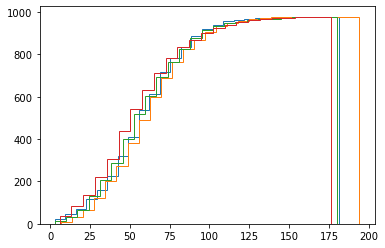

In [135]:
for group in set(separation_quantiles):
    
    indices_group = np.where(separation_quantiles==group)[0]
    ccp_lifetimes_quartile = np.array(ccp_lifetime_merged)[indices_group]
    plt.hist(ccp_lifetimes_quartile, cumulative=True, histtype='step', bins='auto')

In [136]:
distance_from_center = []

center_x = 512/2
center_y = 512/2

for i in range(len(absolute_x_merged)):
    
    x_pos = absolute_x_merged[i]
    y_pos = absolute_y_merged[i]
    
    mean_x = np.mean(x_pos)
    mean_y = np.mean(y_pos)
    
    dist = np.sqrt((mean_x-center_x)**2 + (mean_y-center_y)**2)
    distance_from_center.append(dist)

(array([ 61., 195., 327., 486., 580., 681., 720., 547., 234.,  81.]),
 array([  3.00802534,  37.38295979,  71.75789424, 106.13282868,
        140.50776313, 174.88269758, 209.25763202, 243.63256647,
        278.00750092, 312.38243536, 346.75736981]),
 <a list of 10 Patch objects>)

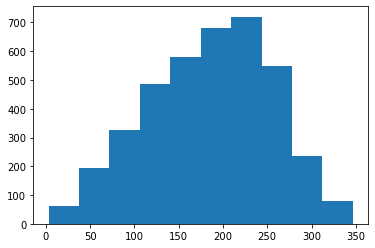

In [137]:
plt.hist(distance_from_center)

In [138]:
data_df = np.array((distance_from_center, separation_quantiles)).T

In [139]:
df_sep = pd.DataFrame(data_df, columns=['distance', 
                                        'quantile'])

In [140]:
df_sep

,distance,quantile
0,117.221692,0.0
1,139.552132,2.0
2,137.243252,2.0
3,124.826504,1.0
4,245.202765,1.0
...,...,...
3907,257.888463,3.0
3908,112.356535,0.0
3909,123.551646,0.0
3910,99.339101,0.0


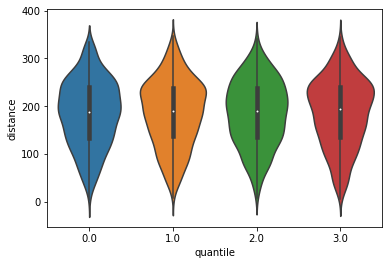

In [141]:
sns.violinplot(x="quantile", y="distance", data=df_sep)

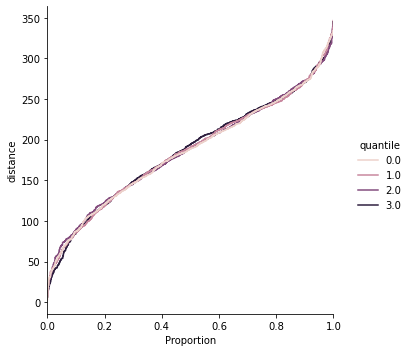

In [142]:
sns.displot(y="distance", data=df_sep, kind='ecdf', hue='quantile')

In [143]:
# channel_amplitudes_arpc3_positive = []
# for i in range(len(merged_results['ch0_vectors_arpc3_positive'])):
#     channel_amplitudes_arpc3_positive.append([merged_results['ch0_vectors_arpc3_positive'][i],
#                                               merged_results['ch1_vectors_arpc3_positive'][i],
#                                               merged_results['ch2_vectors_arpc3_positive'][i],
#                                               merged_results['channel_0_1_separations_arpc3_positive'][i],
#                                               merged_results['channel_0_2_separations_arpc3_positive'][i],
#                                               merged_results['channel_1_2_separations_arpc3_positive'][i]])
# channel_amplitudes_arpc3_positive = np.array(channel_amplitudes_arpc3_positive)[indices_sig_arpc3_dnm2_peak]

In [144]:
channel_amplitudes_arpc3_positive_quantiles = []
for group in set(separation_quantiles):
    
    indices_group = np.where(separation_quantiles==group)[0]
    channel_amplitudes_arpc3_positive_quantiles.append(channel_amplitudes_arpc3_positive[indices_group])    

In [145]:
%%capture
fig, (axes_0, axes_1, axes_2, axes_3) = plt.subplots(4, 1, dpi=500, figsize=(6,16), gridspec_kw=dict(height_ratios=[1,1,1,1]))
axes_separation_0 = axes_0.twinx()
axes_separation_1 = axes_1.twinx()
axes_separation_2 = axes_2.twinx()
axes_separation_3 = axes_3.twinx()

cohorts = [[0, 200]]

_, _, max_dnm2_cohort_indices_0 = display_tracks.plot_separated_cohorts([axes_0], 
                                                                         channel_amplitudes_arpc3_positive_quantiles[0], 
                                                                         1, 
                                                                         cohorts, 
                                                                         [0, 1], 
                                                                         [], 
                                                                         ['AP2', 'DNM2'],
                                                                         ['m', 'g'],
                                                                         line_cutoff_index=[],
                                                                         line_cutoff_regions=[[], [], [], [], []],
                                                                         horizontal_shift_index=[0, 1], 
                                                                         horizontal_shift=[-92, -92, -92])

_, _, max_dnm2_cohort_indices_1 = display_tracks.plot_separated_cohorts([axes_1], 
                                                                         channel_amplitudes_arpc3_positive_quantiles[1], 
                                                                         1, 
                                                                         cohorts, 
                                                                         [0, 1, 2], 
                                                                         [], 
                                                                         ['AP2', 'DNM2', 'ARPC3'],
                                                                         ['m', 'g', 'b'],
                                                                         line_cutoff_index=[],
                                                                         line_cutoff_regions=[[], [], []],
                                                                         horizontal_shift_index=[0, 1, 2], 
                                                                         horizontal_shift=[-90, -90, -90])                                                                           

_, _, max_dnm2_cohort_indices_2 = display_tracks.plot_separated_cohorts([axes_2], 
                                                                         channel_amplitudes_arpc3_positive_quantiles[2], 
                                                                         1, 
                                                                         cohorts, 
                                                                         [0, 1, 2], 
                                                                         [], 
                                                                         ['AP2', 'DNM2', 'ARPC3'],
                                                                         ['m', 'g', 'b'],
                                                                         line_cutoff_index=[],
                                                                         line_cutoff_regions=[[], [], []],
                                                                         horizontal_shift_index=[0, 1, 2], 
                                                                         horizontal_shift=[-90, -90, -90])                                                                           

_, _, max_dnm2_cohort_indices_3 = display_tracks.plot_separated_cohorts([axes_3], 
                                                                         channel_amplitudes_arpc3_positive_quantiles[3], 
                                                                         1, 
                                                                         cohorts, 
                                                                         [0, 1, 2], 
                                                                         [], 
                                                                         ['AP2', 'DNM2', 'ARPC3'],
                                                                         ['m', 'g', 'b'],
                                                                         line_cutoff_index=[],
                                                                         line_cutoff_regions=[[], [], []],
                                                                         horizontal_shift_index=[0, 1, 2], 
                                                                         horizontal_shift=[-90, -90, -90])                                                                           

shift_0 = max_dnm2_cohort_indices_0[0]
shift_1 = max_dnm2_cohort_indices_1[0]
shift_2 = max_dnm2_cohort_indices_2[0]
shift_3 = max_dnm2_cohort_indices_3[0]



[0]
[0]
[0]
[0]


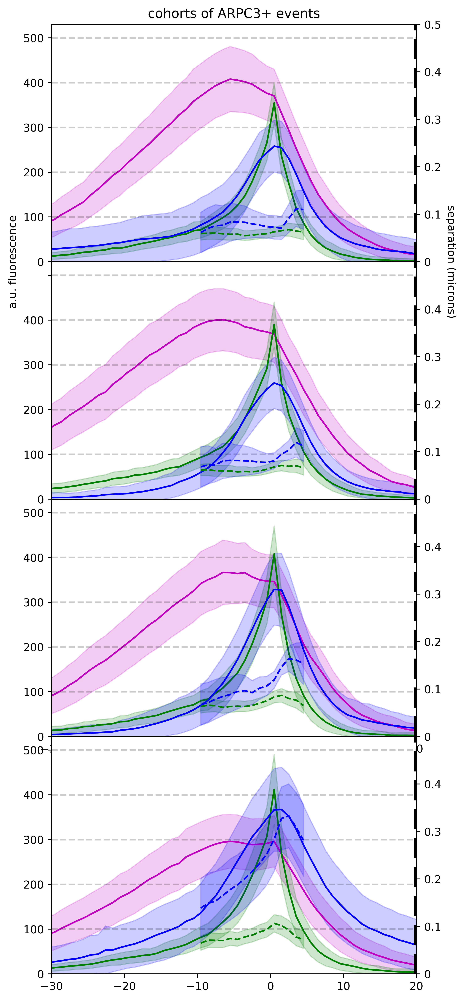

In [146]:
fig, (axes_0, axes_1, axes_2, axes_3) = plt.subplots(4, 1, dpi=500, figsize=(6,16), gridspec_kw=dict(height_ratios=[1,1,1,1]))
axes_separation_0 = axes_0.twinx()
axes_separation_1 = axes_1.twinx()
axes_separation_2 = axes_2.twinx()
axes_separation_3 = axes_3.twinx()

display_tracks.plot_separated_cohorts([axes_0, axes_separation_0], 
                                     channel_amplitudes_arpc3_positive_quantiles[0], 
                                     1, 
                                     cohorts, 
                                     [0, 1, 2], 
                                     [3, 4], 
                                     ['AP2', 'DNM2', 'ARPC3', 'AP2-DNM2', 'AP2-ARPC3'],
                                     ['m', 'g', 'b', 'g', 'b'],
                                     line_cutoff_index=[3, 4],
                                     line_cutoff_regions=[[], [], [], [[0, shift_0-10], [shift_0+5, 120]], [[0, shift_0-10], [shift_0+5, 120]]],
                                     horizontal_shift_index=[0, 1, 2, 3, 4], 
                                     horizontal_shift=[-shift_0, -shift_0, -shift_0, -shift_0, -shift_0])
                                                                        

display_tracks.plot_separated_cohorts([axes_1, axes_separation_1], 
                                     channel_amplitudes_arpc3_positive_quantiles[1], 
                                     1, 
                                     cohorts, 
                                     [0, 1, 2], 
                                     [3, 4], 
                                     ['AP2', 'DNM2', 'ARPC3', 'AP2-DNM2', 'AP2-ARPC3'],
                                     ['m', 'g', 'b', 'g', 'b'],
                                     line_cutoff_index=[3, 4],
                                     line_cutoff_regions=[[], [], [], [[0, shift_1-10], [shift_1+5, 120]], [[0, shift_1-10], [shift_1+5, 120]]],
                                     horizontal_shift_index=[0, 1, 2, 3, 4], 
                                     horizontal_shift=[-shift_1, -shift_1, -shift_1, -shift_1, -shift_1])


display_tracks.plot_separated_cohorts([axes_2, axes_separation_2], 
                                     channel_amplitudes_arpc3_positive_quantiles[2], 
                                     1, 
                                     cohorts, 
                                     [0, 1, 2], 
                                     [3, 4], 
                                     ['AP2', 'DNM2', 'ARPC3', 'AP2-DNM2', 'AP2-ARPC3'],
                                     ['m', 'g', 'b', 'g', 'b'],
                                     line_cutoff_index=[3, 4],
                                     line_cutoff_regions=[[], [], [], [[0, shift_2-10], [shift_2+5, 120]], [[0, shift_2-10], [shift_2+5, 120]]],
                                     horizontal_shift_index=[0, 1, 2, 3, 4], 
                                     horizontal_shift=[-shift_2, -shift_2, -shift_2, -shift_2, -shift_2])

display_tracks.plot_separated_cohorts([axes_3, axes_separation_3], 
                                     channel_amplitudes_arpc3_positive_quantiles[3], 
                                     1, 
                                     cohorts, 
                                     [0, 1, 2], 
                                     [3, 4], 
                                     ['AP2', 'DNM2', 'ARPC3', 'AP2-DNM2', 'AP2-ARPC3'],
                                     ['m', 'g', 'b', 'g', 'b'],
                                     line_cutoff_index=[3, 4],
                                     line_cutoff_regions=[[], [], [], [[0, shift_3-10], [shift_3+5, 120]], [[0, shift_3-10], [shift_3+5, 120]]],
                                     horizontal_shift_index=[0, 1, 2, 3, 4], 
                                     horizontal_shift=[-shift_3, -shift_3, -shift_3, -shift_3, -shift_3])


y_lines = np.arange(0,600,100)

for i in range(1,len(y_lines)):
    
    axes_0.axhline(y_lines[i], 0, 1, linestyle='--', color='black', alpha=0.2)
    axes_1.axhline(y_lines[i], 0, 1, linestyle='--', color='black', alpha=0.2)
    axes_2.axhline(y_lines[i], 0, 1, linestyle='--', color='black', alpha=0.2)
    axes_3.axhline(y_lines[i], 0, 1, linestyle='--', color='black', alpha=0.2)

axes_1.set_xlabel('time (s)') 

axes_0.set_xlim([-30, 20]) 
axes_1.set_xlim([-30, 20]) 
axes_2.set_xlim([-30, 20]) 
axes_3.set_xlim([-30, 20]) 

axes_0.set_ylim([0,530])
axes_1.set_ylim([0,530])
axes_2.set_ylim([0,530])
axes_3.set_ylim([0,530])

axes_separation_0.set_ylim([0,0.5])
axes_separation_1.set_ylim([0,0.5])
axes_separation_2.set_ylim([0,0.5])
axes_separation_3.set_ylim([0,0.5])

axes_0.set_yticks([0,100,200,300,400, 500], minor=False)
axes_0.set_yticklabels([0,100,200,300,400, 500], minor=False)

axes_1.set_yticks([0,100,200,300,400, 500], minor=False)
axes_1.set_yticklabels([0,100,200,300, 400, 500], minor=False)

axes_2.set_yticks([0,100,200,300,400, 500], minor=False)
axes_2.set_yticklabels([0,100,200,300, 400, 500], minor=False)

axes_3.set_yticks([0,100,200,300,400, 500], minor=False)
axes_3.set_yticklabels([0,100,200,300, 400, 500], minor=False)


axes_separation_0.set_yticks([0, 0.1, 0.2, 0.3, 0.4, 0.5], minor=False)
axes_separation_0.set_yticklabels([0, 0.1, 0.2, 0.3, 0.4, 0.5], minor=False)

axes_separation_1.set_yticks([0, 0.1, 0.2, 0.3, 0.4], minor=False)
axes_separation_1.set_yticklabels([0, 0.1, 0.2, 0.3, 0.4], minor=False)

axes_separation_2.set_yticks([0, 0.1, 0.2, 0.3, 0.4], minor=False)
axes_separation_2.set_yticklabels([0, 0.1, 0.2, 0.3, 0.4], minor=False)

axes_separation_3.set_yticks([0, 0.1, 0.2, 0.3, 0.4], minor=False)
axes_separation_3.set_yticklabels([0, 0.1, 0.2, 0.3, 0.4], minor=False)


plt.setp(axes_0.get_xticklabels(), visible=False)
yticks = axes_1.yaxis.get_major_ticks()
yticks[-1].label1.set_visible(False)
plt.subplots_adjust(hspace=.0)
# plt.show()
axes_0.axvline(20, color='black', linewidth=5, linestyle='--')
axes_1.axvline(20, color='black', linewidth=5, linestyle='--')
axes_2.axvline(20, color='black', linewidth=5, linestyle='--')
axes_3.axvline(20, color='black', linewidth=5, linestyle='--')

axes_0.text(-36,0, 'a.u. fluorescence', rotation="vertical", va="center", fontsize=10);
axes_0.text(24,0, 'separation (microns)', rotation=270, va="center", fontsize=10);

axes_1.set_xticks(0.5+np.array([-20, -10, 0, 10]), minor=False)
axes_1.set_xticklabels([-20, -10, 0, 10], minor=False)

axes_0.set_title('cohorts of ARPC3+ events')
# plt.show()
plt.savefig('/Users/cynashirazinejad/Desktop/test.png')

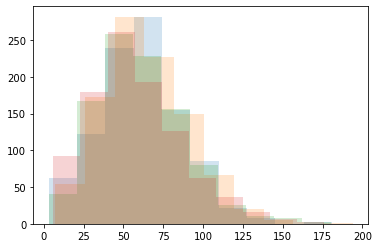

In [147]:
for group in set(separation_quantiles):
    
    indices_group = np.where(separation_quantiles==group)[0]
    ccp_lifetimes_quartile = np.array(ccp_lifetime_merged)[indices_group]
    plt.hist(ccp_lifetimes_quartile,alpha=0.2)

60.99897750511247
64.20654396728017
60.96319018404908
57.86605316973415


Text(0, 0.5, 'density frequency')

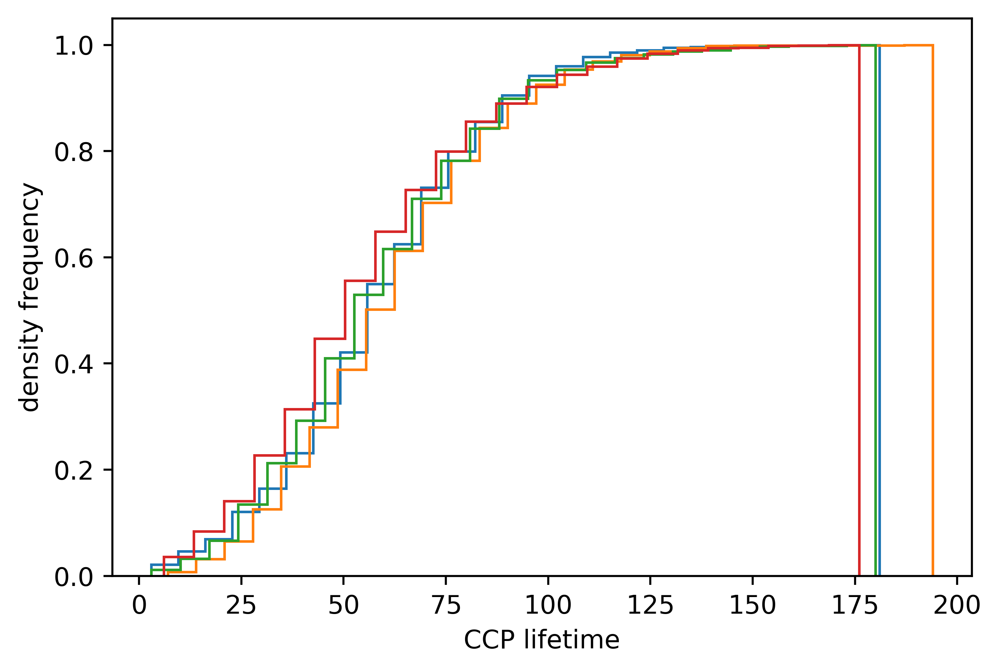

In [148]:
plt.rcParams['figure.dpi']=500
plt.rcParams['figure.figsize']=(6,4)
for group in set(separation_quantiles):
    
    indices_group = np.where(separation_quantiles==group)[0]
    ccp_lifetimes_quartile = np.array(ccp_lifetime_merged)[indices_group]
    print(np.mean(ccp_lifetimes_quartile))
    plt.hist(ccp_lifetimes_quartile, cumulative=True, histtype='step', bins='auto', density=True)
    
plt.xlabel('CCP lifetime')
plt.ylabel('density frequency')

In [149]:
df_sep['lifetime'] = ccp_lifetime_merged
df_sep['separation'] = separation_merged

In [150]:
df_sep

,distance,quantile,lifetime,separation
0,117.221692,0.0,98,0.045091
1,139.552132,2.0,115,0.138294
2,137.243252,2.0,127,0.167028
3,124.826504,1.0,60,0.081695
4,245.202765,1.0,126,0.113954
...,...,...,...,...
3907,257.888463,3.0,24,0.389715
3908,112.356535,0.0,13,0.032813
3909,123.551646,0.0,22,0.019403
3910,99.339101,0.0,6,0.000000


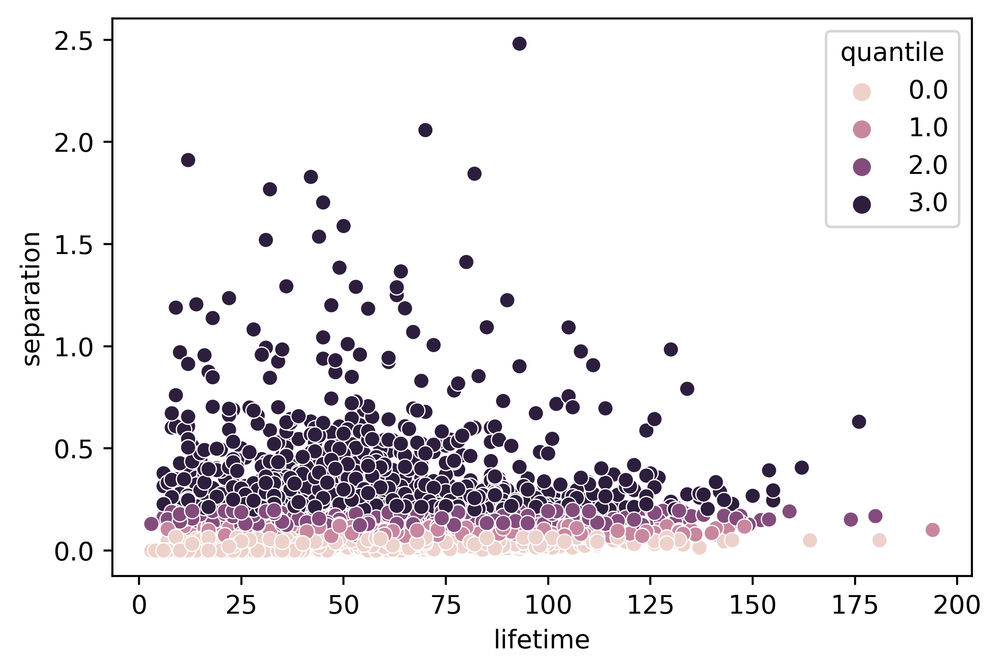

In [151]:
sns.scatterplot(data=df_sep,
                x='lifetime',
                y='separation',
                hue='quantile')

In [152]:
np.arange(0, 1.25, 0.25)

array([0.  , 0.25, 0.5 , 0.75, 1.  ])

(array([135., 186., 292., 338., 347., 304., 261., 289., 238., 183., 179.,
        175., 126., 120.,  94.,  70.,  71.,  56.,  47.,  35.,  36.,  32.,
         23.,  19.,  24.,  17.,  16.,  13.,   9.,  12.,  14.,  11.,  12.,
          2.,   7.,  10.,  12.,   5.,   5.,   5.,   4.,   6.,   7.,   2.,
          3.,   2.,   0.,   2.,   0.,   1.,   1.,   4.,   2.,   0.,   2.,
          3.,   2.,   4.,   2.,   2.,   2.,   1.,   0.,   1.,   1.,   1.,
          2.,   0.,   1.,   0.,   0.,   3.,   2.,   0.,   2.,   1.,   0.,
          1.,   2.,   0.,   0.,   0.,   1.,   1.,   0.,   1.,   0.,   0.,
          0.,   0.,   0.,   1.,   1.,   0.,   0.,   0.,   1.,   0.,   0.,
          0.,   0.,   0.,   0.,   1.,   0.,   0.,   1.,   0.,   0.,   0.,
          1.,   1.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0., 

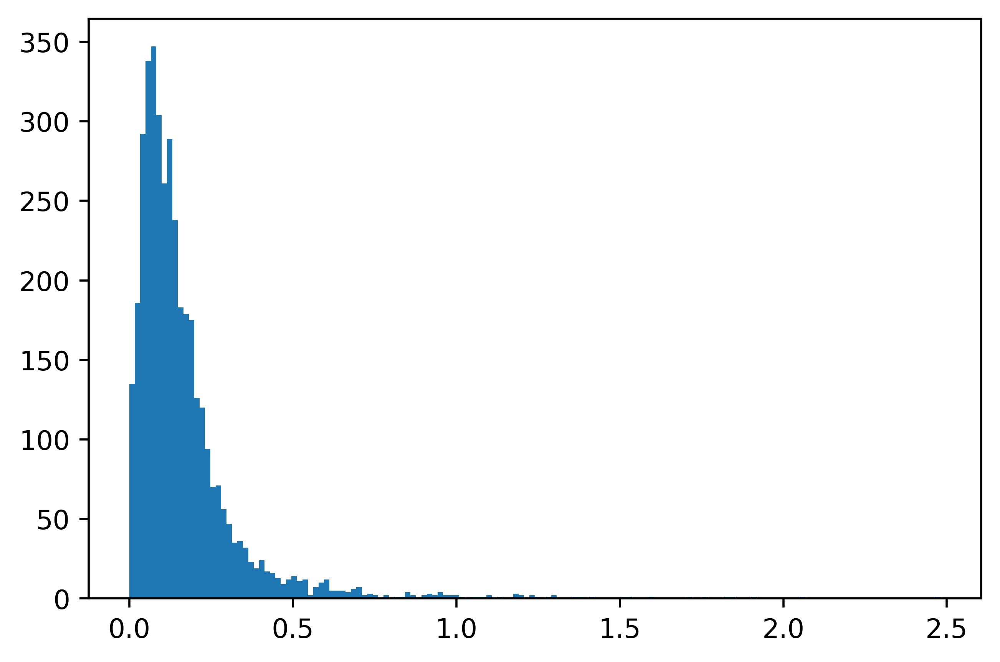

In [153]:
plt.hist(separation_merged, bins='auto')

In [154]:
separation_quantiles = pd.qcut(separation_merged, 
                               q=np.arange(0, 1.25, 0.25), 
                               labels=False)

In [155]:
for group in set(separation_quantiles):
    print(group)
    indices_group = np.where(separation_quantiles==group)[0]
    print(len(indices_group))
    ccp_lifetimes_quartile = np.array(ccp_lifetime_merged)[indices_group]
    print()

0
978

1
978

2
978

3
978



In [156]:
for num_quantiles in range(3,9):
    
    separation_quantiles = pd.qcut(separation_merged, 
                               q=np.arange(0, 1+1/num_quantiles-0.01, 1/num_quantiles), 
                               labels=False)
    print('quantiles:', list(np.arange(0, 1+1/num_quantiles-0.01, 1/num_quantiles)))
    for group in set(separation_quantiles):
        print('group:', group)
        indices_group = np.where(separation_quantiles==group)[0]
        ccp_lifetimes_quartile = np.array(ccp_lifetime_merged)[indices_group]
        print('median lifetime:', np.median(ccp_lifetimes_quartile))
    print('\n\n\n\n')

quantiles: [0.0, 0.3333333333333333, 0.6666666666666666, 1.0]
group: 0
median lifetime: 61.0
group: 1
median lifetime: 60.0
group: 2
median lifetime: 54.0





quantiles: [0.0, 0.25, 0.5, 0.75, 1.0]
group: 0
median lifetime: 61.0
group: 1
median lifetime: 62.0
group: 2
median lifetime: 58.0
group: 3
median lifetime: 54.0





quantiles: [0.0, 0.2, 0.4, 0.6000000000000001, 0.8, 1.0]
group: 0
median lifetime: 59.0
group: 1
median lifetime: 65.0
group: 2
median lifetime: 59.5
group: 3
median lifetime: 59.0
group: 4
median lifetime: 52.0





quantiles: [0.0, 0.16666666666666666, 0.3333333333333333, 0.5, 0.6666666666666666, 0.8333333333333333, 1.0]
group: 0
median lifetime: 60.0
group: 1
median lifetime: 65.0
group: 2
median lifetime: 60.0
group: 3
median lifetime: 59.0
group: 4
median lifetime: 57.0
group: 5
median lifetime: 52.0





quantiles: [0.0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857142, 0.8571428571428571, 1.0]
group: 0
med

In [157]:
for num_quantiles in range(3,9):
    
    separation_quantiles = pd.qcut(separation_merged, 
                               q=np.arange(0, 1+1/num_quantiles-0.01, 1/num_quantiles), 
                               labels=False)
    print('quantiles:', list(np.arange(0, 1+1/num_quantiles-0.01, 1/num_quantiles)))
    for group in set(separation_quantiles):
        print('group:', group)
        indices_group = np.where(separation_quantiles==group)[0]
        max_ap2_merged_quartile = np.array(max_ap2_merged)[indices_group]
        print('median lifetime:', np.median(max_ap2_merged_quartile))
    print('\n\n\n\n')

quantiles: [0.0, 0.3333333333333333, 0.6666666666666666, 1.0]
group: 0
median lifetime: 509.12467458705805
group: 1
median lifetime: 488.69097370460156
group: 2
median lifetime: 391.9597174468961





quantiles: [0.0, 0.25, 0.5, 0.75, 1.0]
group: 0
median lifetime: 506.93471943296674
group: 1
median lifetime: 489.80913689667676
group: 2
median lifetime: 469.7359881127719
group: 3
median lifetime: 385.232967051732





quantiles: [0.0, 0.2, 0.4, 0.6000000000000001, 0.8, 1.0]
group: 0
median lifetime: 506.92524908396217
group: 1
median lifetime: 510.6803430526634
group: 2
median lifetime: 469.8385376303844
group: 3
median lifetime: 454.9297817716149
group: 4
median lifetime: 378.2809314302404





quantiles: [0.0, 0.16666666666666666, 0.3333333333333333, 0.5, 0.6666666666666666, 0.8333333333333333, 1.0]
group: 0
median lifetime: 502.806347997559
group: 1
median lifetime: 512.614116525615
group: 2
median lifetime: 477.69489893264443
group: 3
median lifetime: 497.7318358990246
group: 4
med

In [158]:
dnm2_int_merged = []

for i in range(len(channel_amplitudes_arpc3_positive)):
    
    dnm2_int = channel_amplitudes_arpc3_positive[i][1]
    
    for int_temp in dnm2_int:
        
        dnm2_int_merged.append(int_temp)

(array([1., 0., 0., ..., 0., 0., 1.]),
 array([-357.57027048, -354.89231519, -352.21435989, ..., 2888.11155115,
        2890.78950645, 2893.46746175]),
 <a list of 1214 Patch objects>)

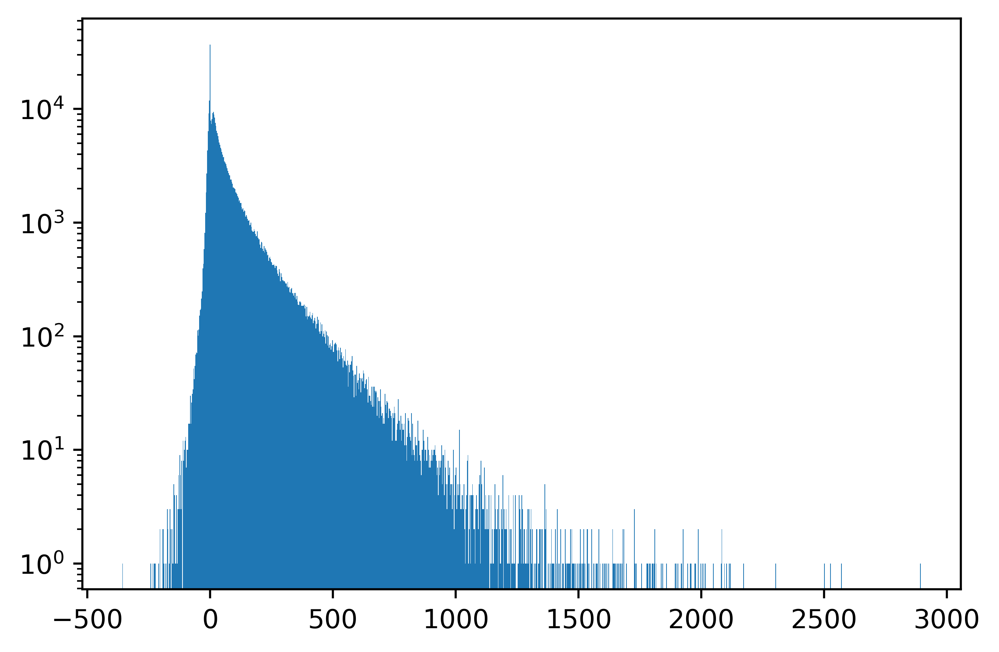

In [159]:
plt.hist(dnm2_int_merged, bins='auto', log=True)

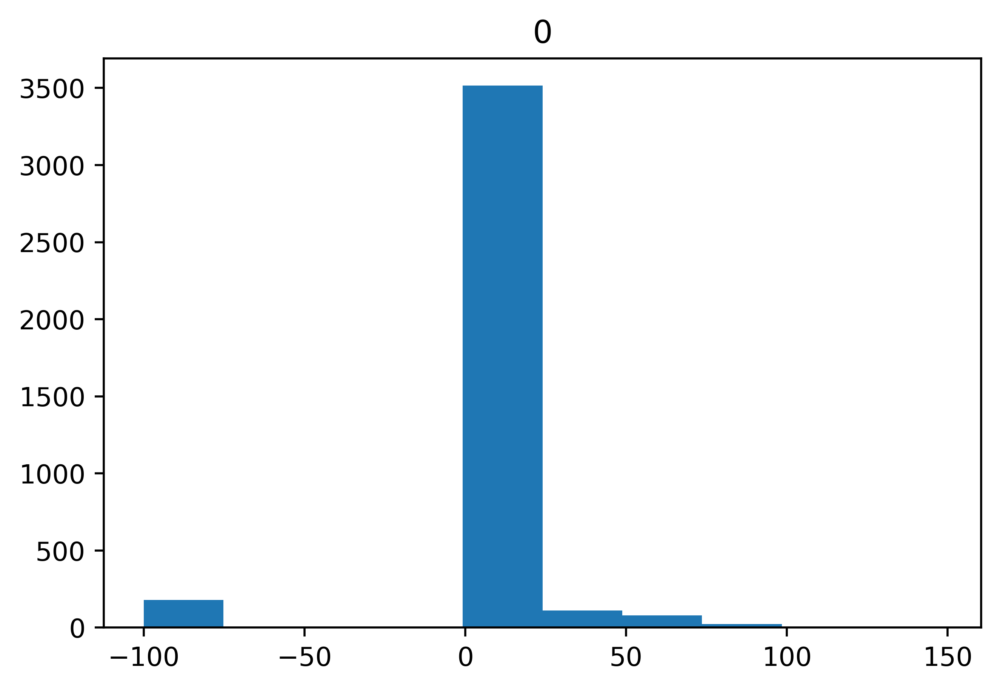

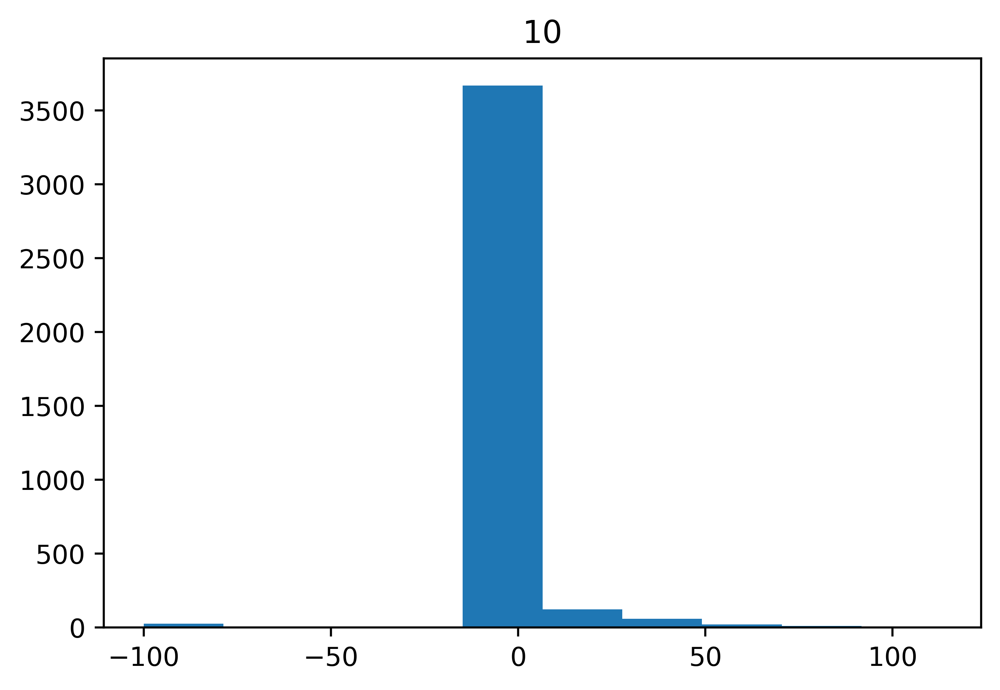

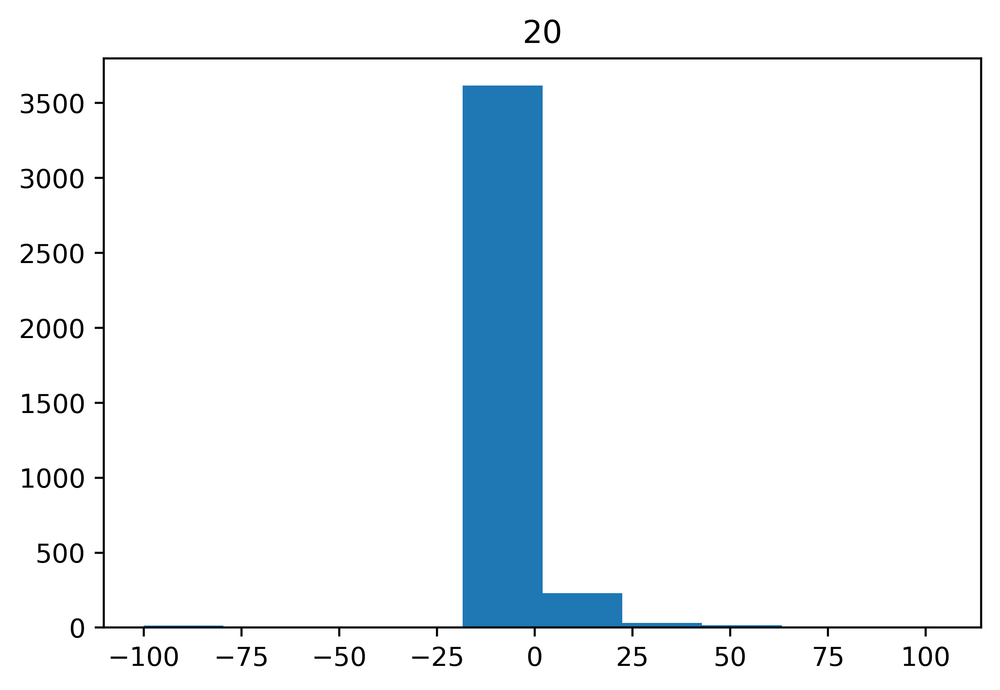

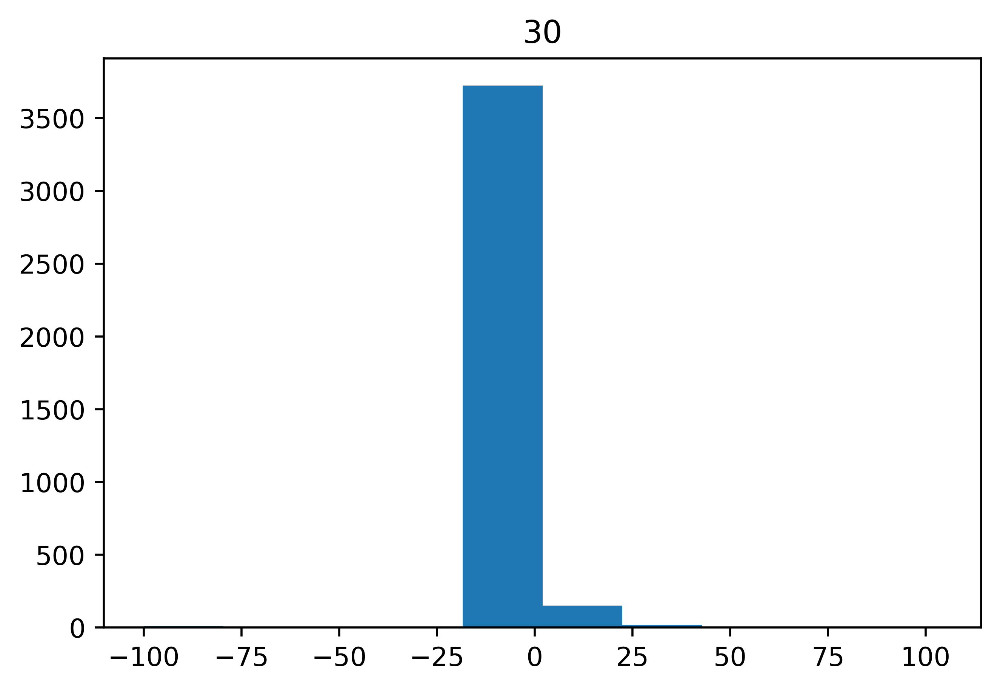

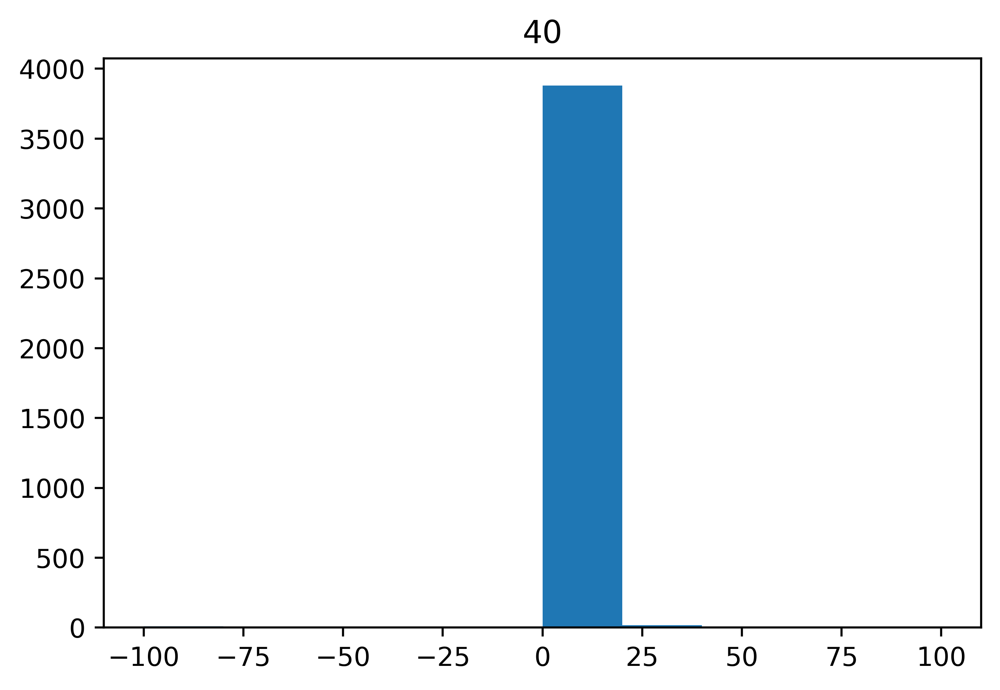

...

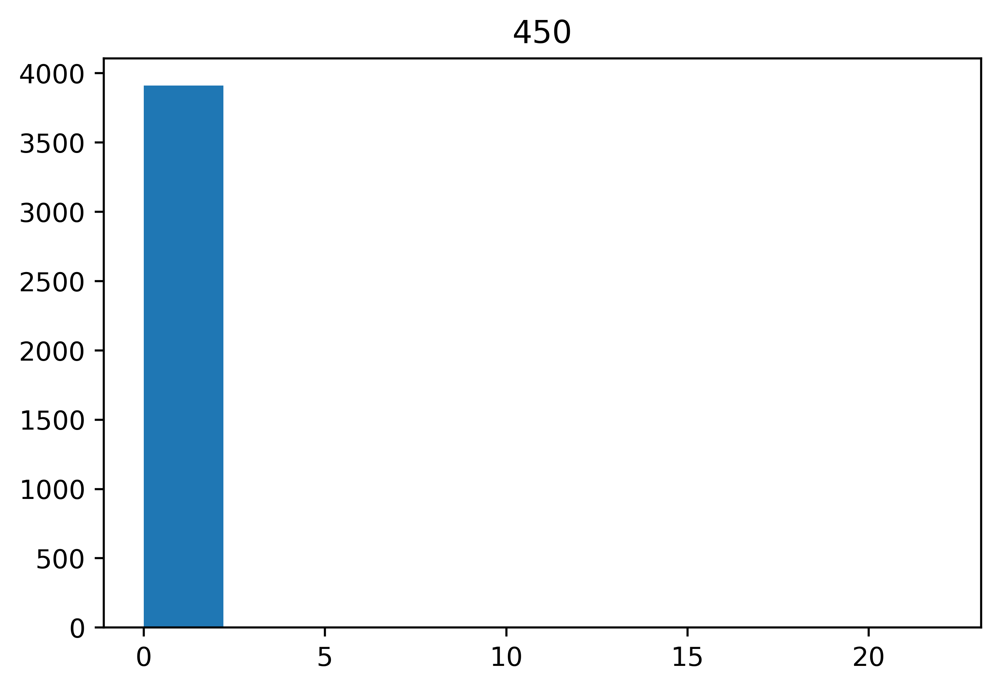

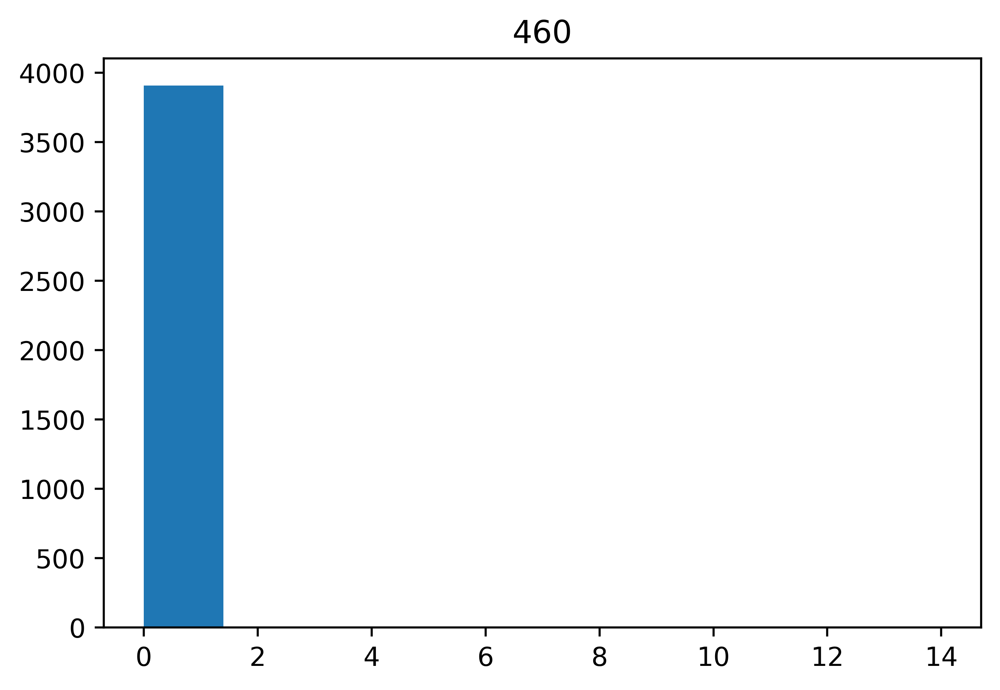

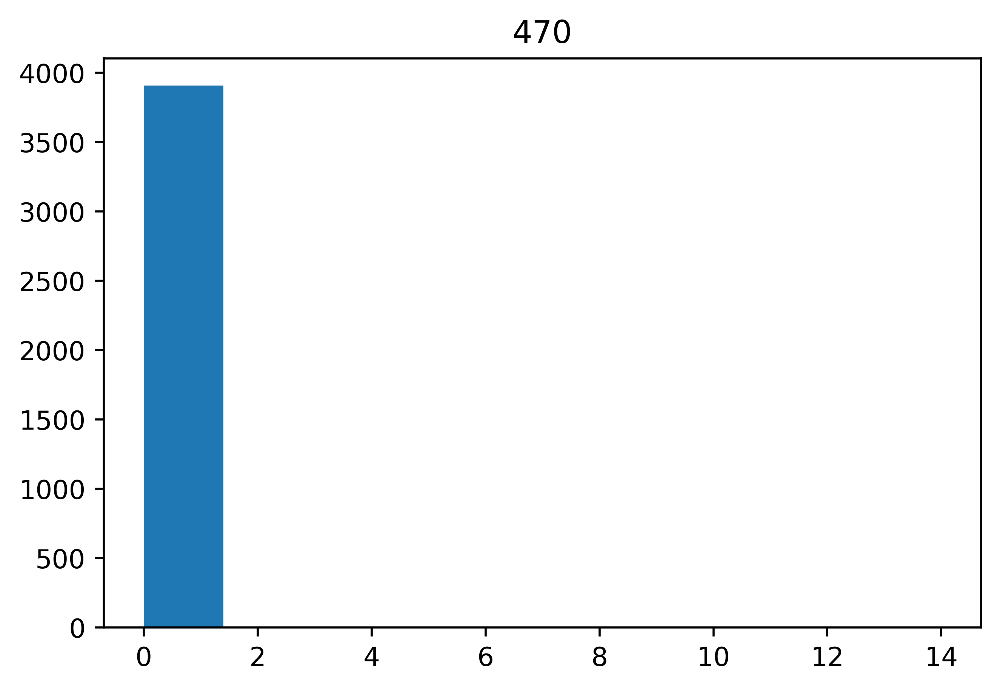

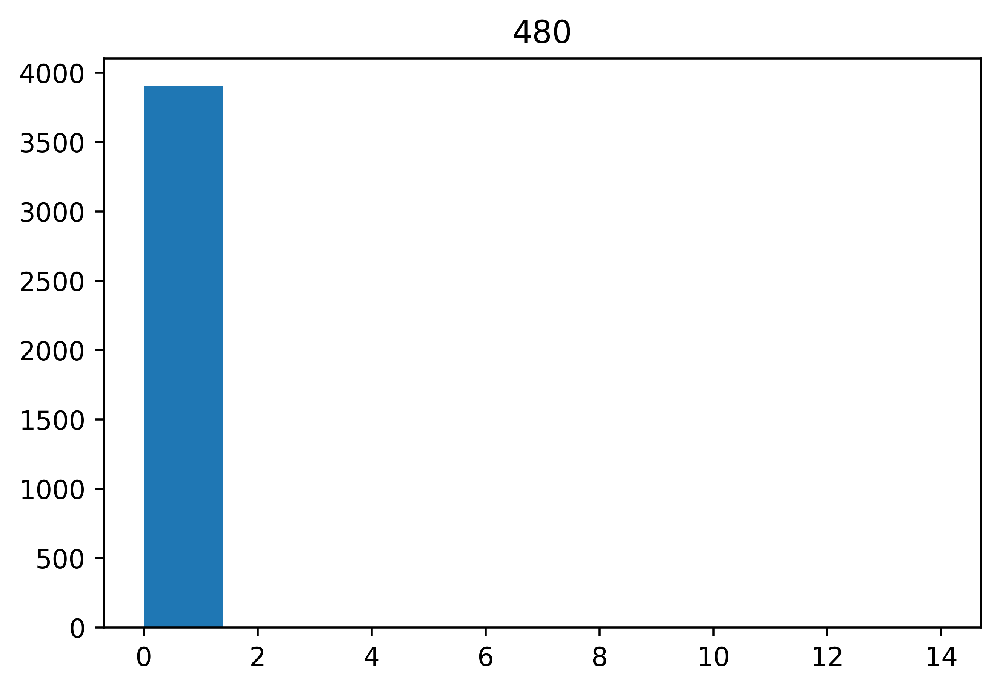

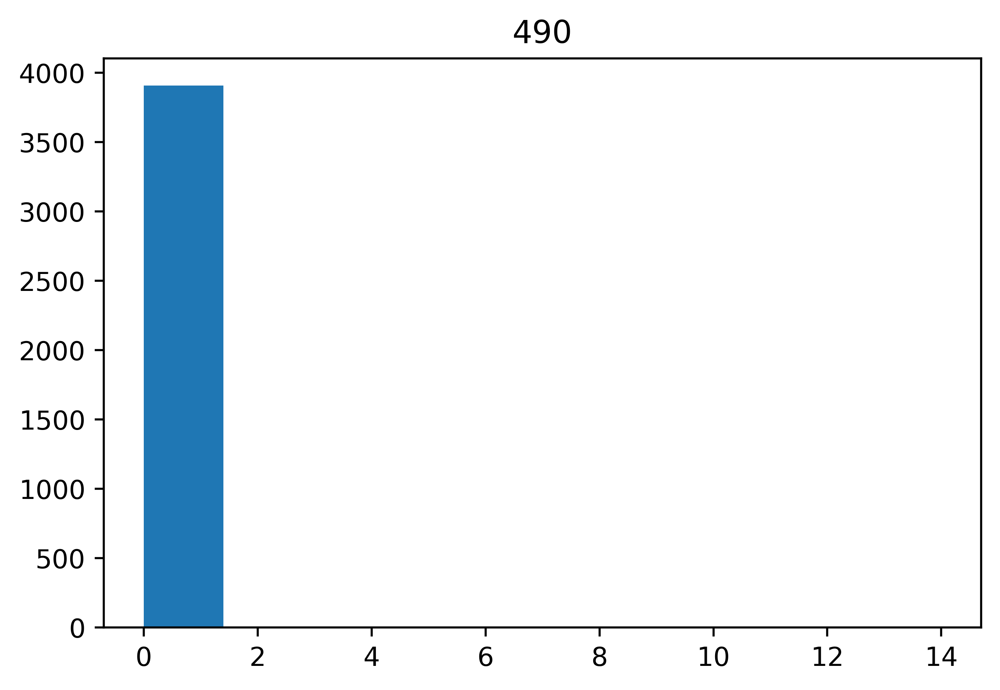

In [170]:
dnm2_max = 500
dnm2_spacing = 10
dnm2_threshold = np.arange(0, dnm2_max, dnm2_spacing)

for thresh in dnm2_threshold:
    
    time_to_thresh = []
    
    for i in range(len(channel_amplitudes_arpc3_positive)):
    
        dnm2_int = channel_amplitudes_arpc3_positive[i][1]
        
        try:
            index = next(x[0] for x in enumerate(dnm2_int) if x[1] < thresh)
        except:
            index = -100
            
        time_to_thresh.append(index)
        
    plt.hist(time_to_thresh)
    plt.title(thresh)
    plt.show()


In [161]:
from scipy.stats import linregress as linregress

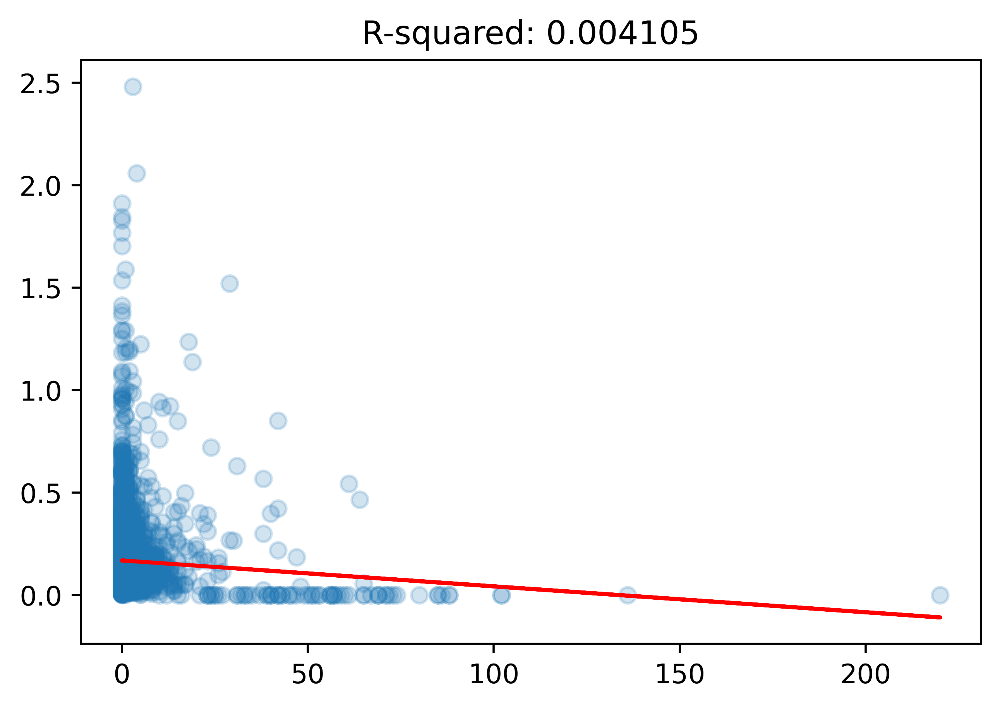

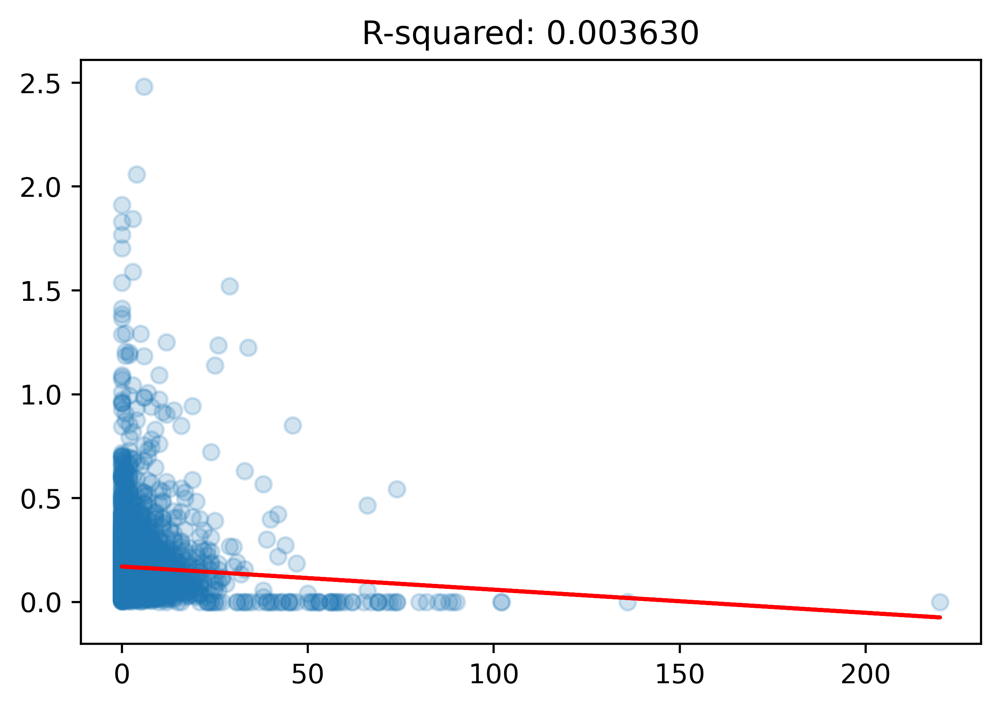

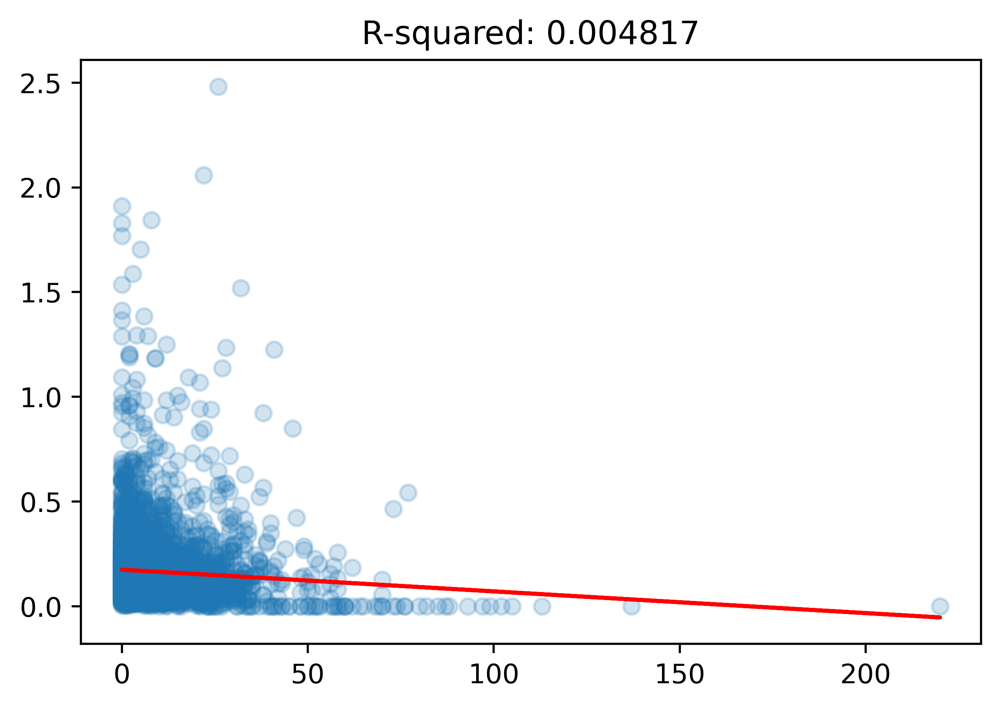

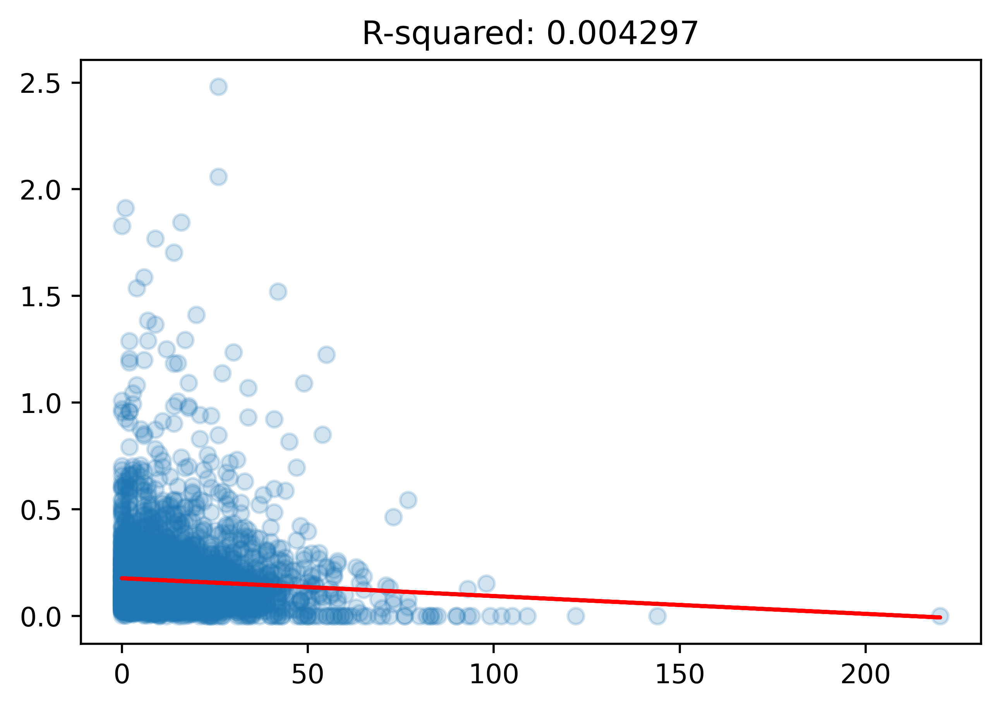

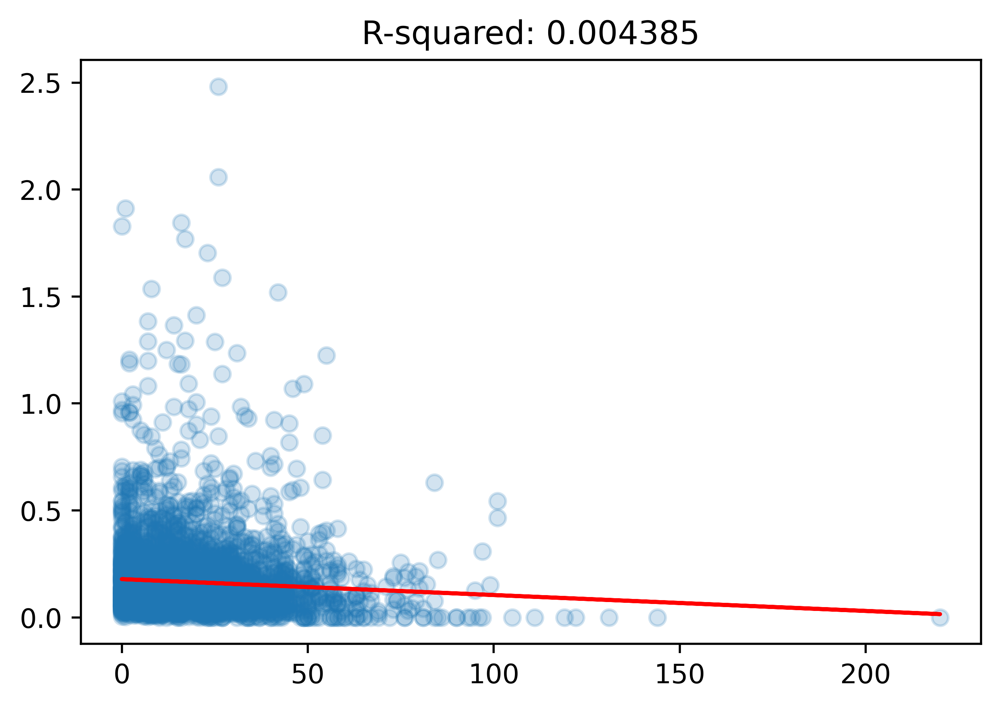

...

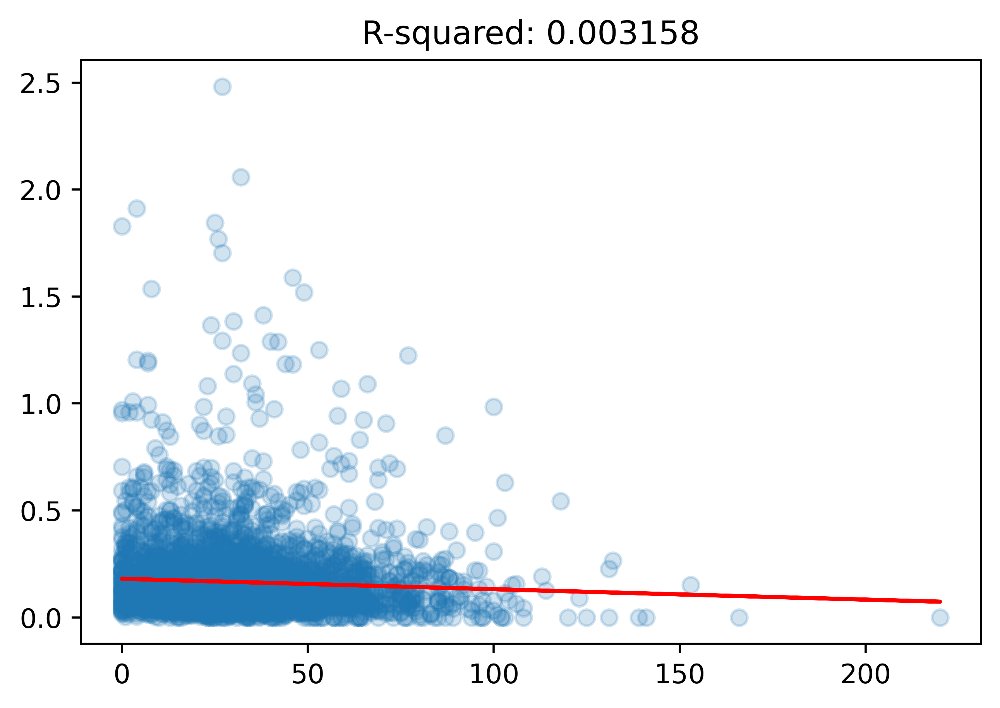

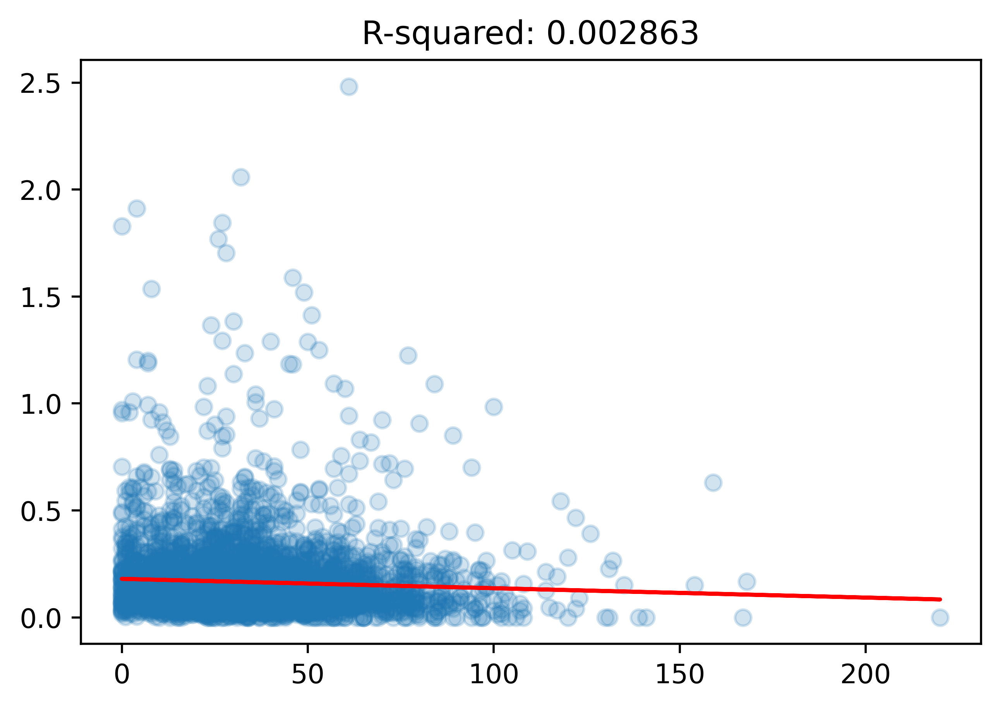

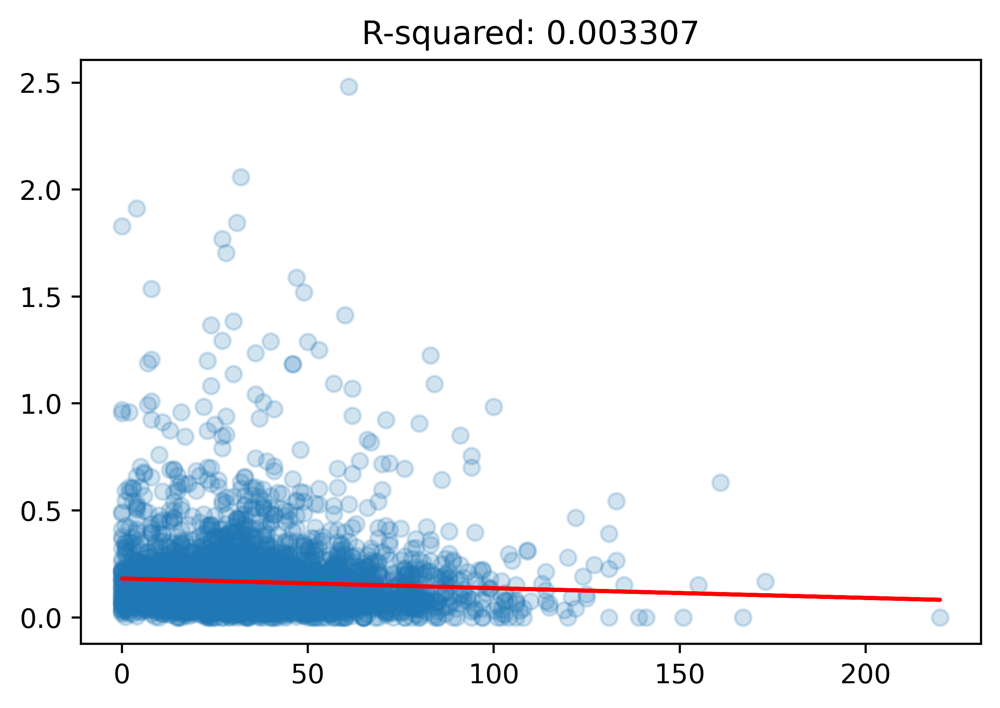

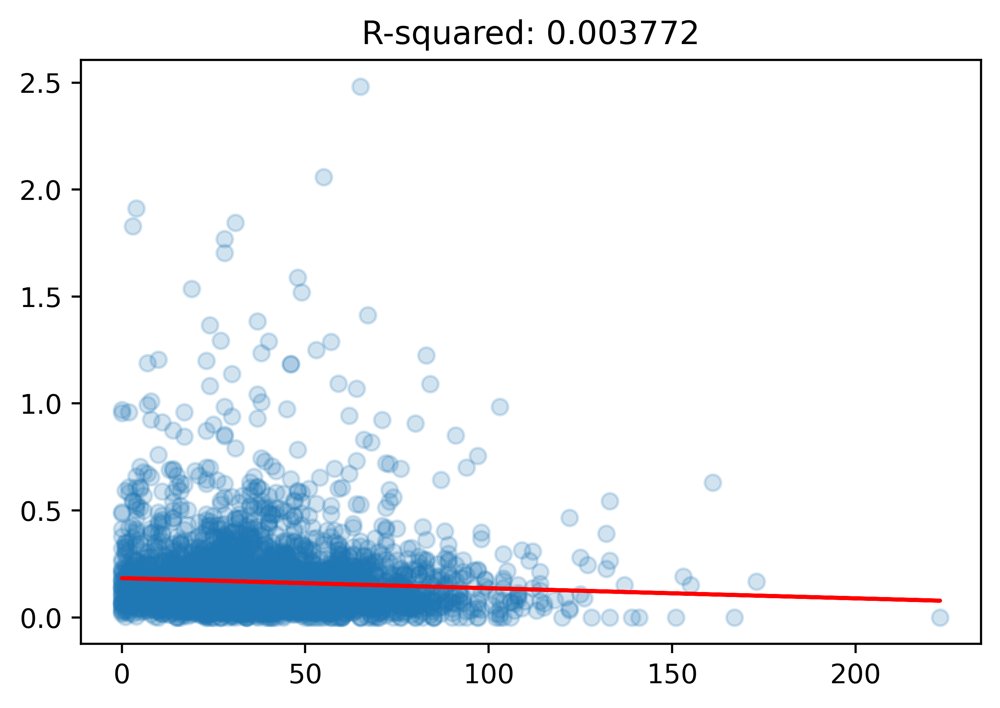

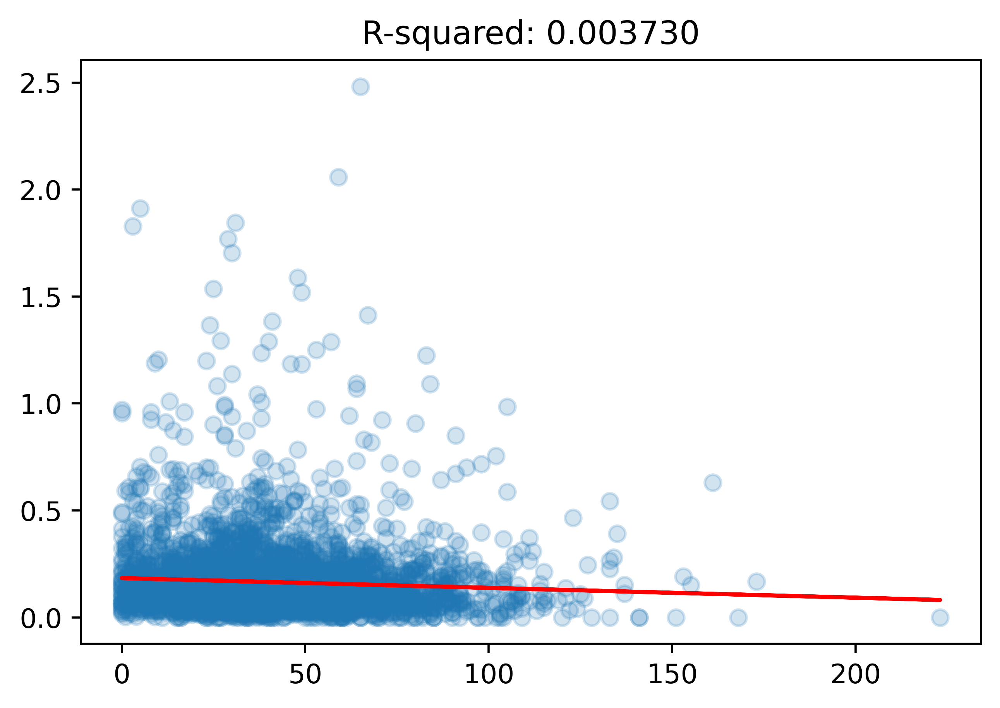

In [162]:
dnm2_max = 130
dnm2_spacing = 10
dnm2_threshold = np.arange(0, dnm2_max, dnm2_spacing)

r_vals = []

for thresh in dnm2_threshold:
    
    time_to_thresh = []
    
    for i in range(len(channel_amplitudes_arpc3_positive)):
    
        dnm2_int = channel_amplitudes_arpc3_positive[i][1]
        
        index = next(x[0] for x in enumerate(dnm2_int) if x[1] > thresh)
        
        time_to_thresh.append(index)
        
    res = stats.linregress(time_to_thresh, separation_merged)
    r_vals.append(res.pvalue)
    plt.scatter(time_to_thresh, separation_merged, alpha=0.2)
    plt.plot(time_to_thresh, res.intercept + res.slope*np.array(time_to_thresh), 'r', label='fitted line')
    plt.title(f"R-squared: {res.rvalue**2:.6f}")
    plt.show()


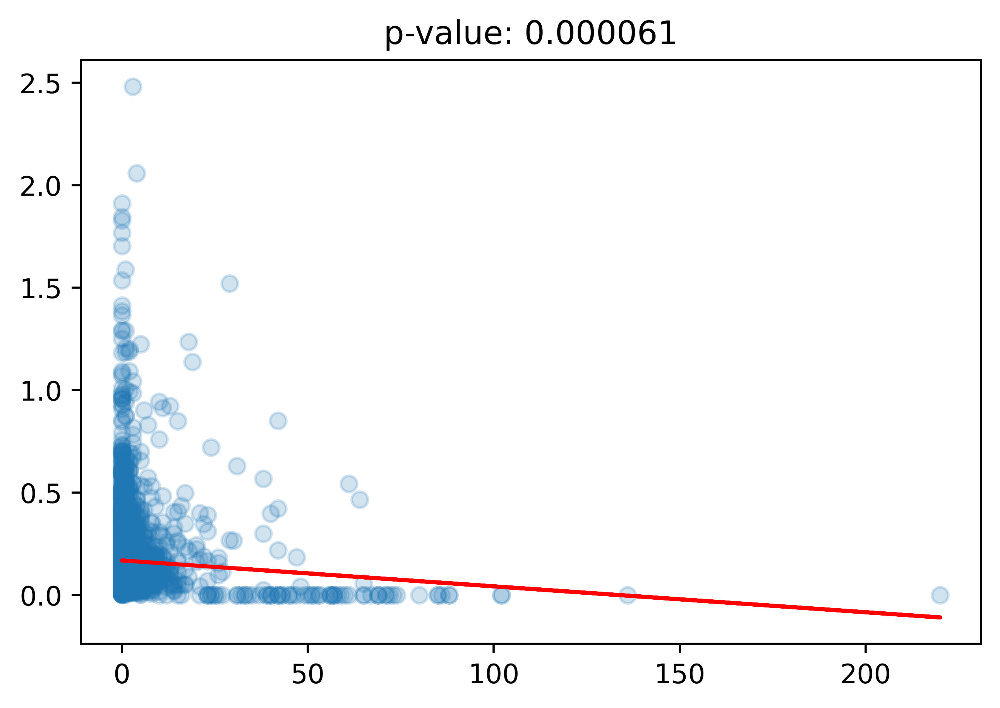

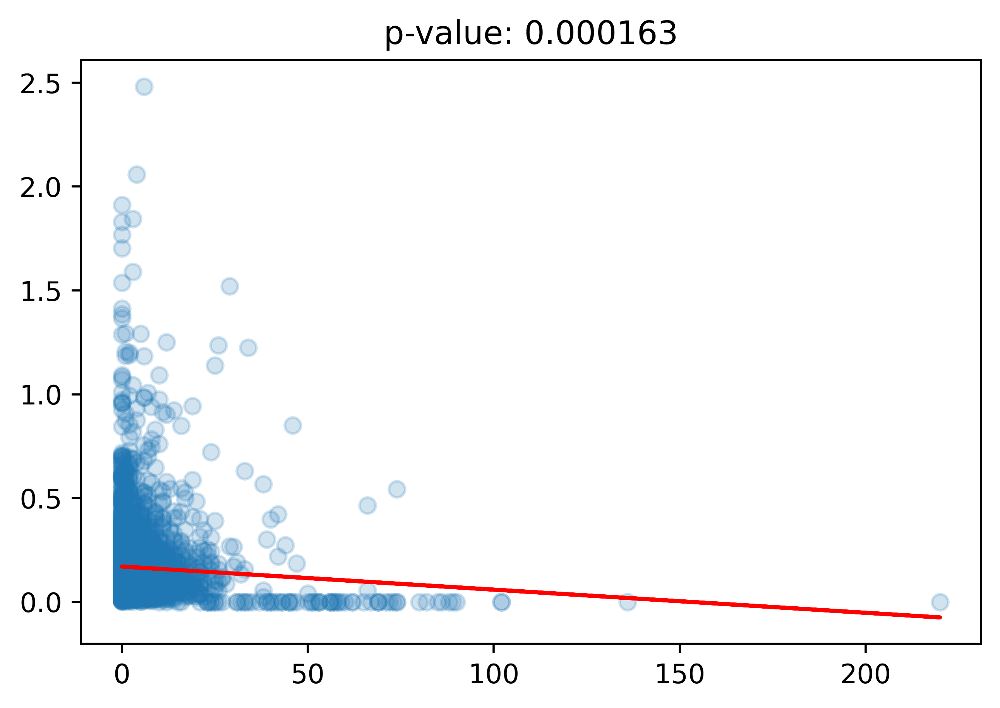

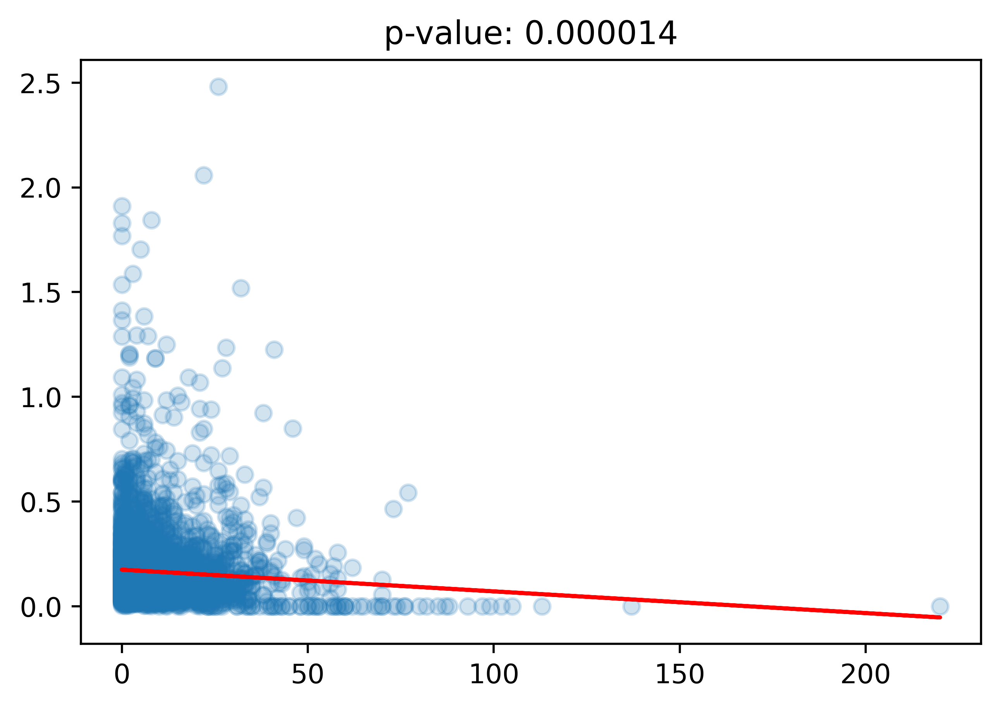

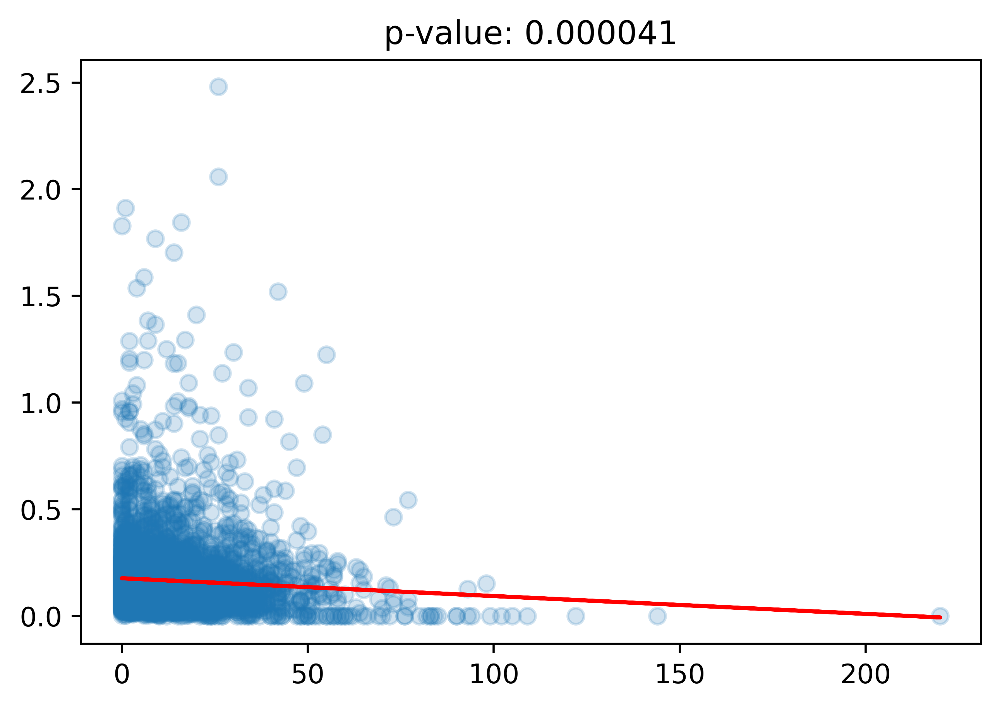

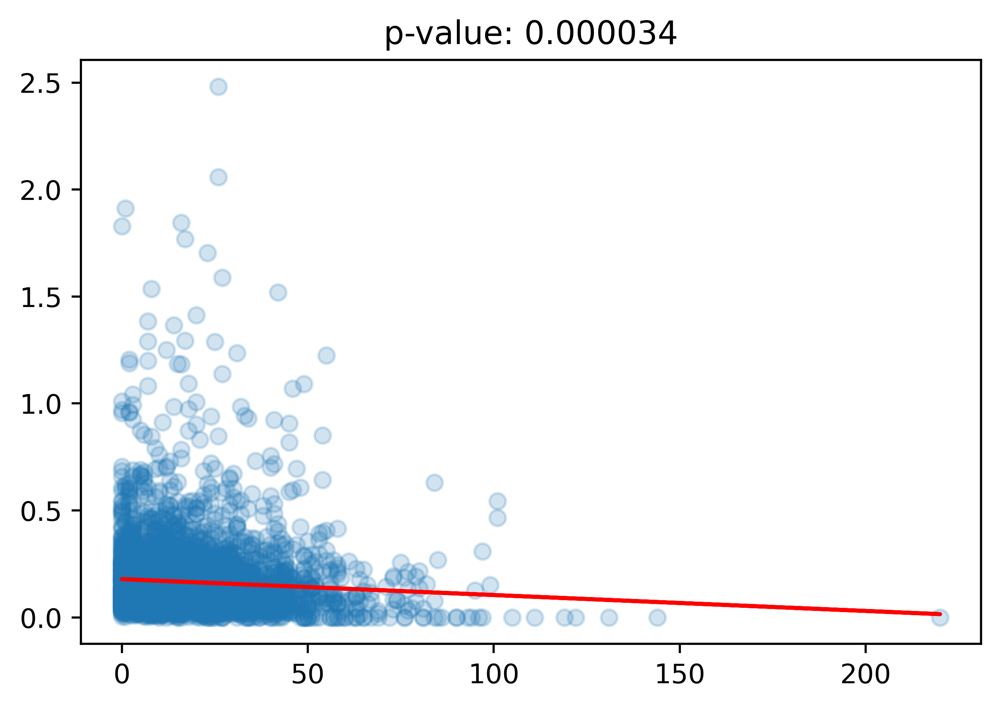

...

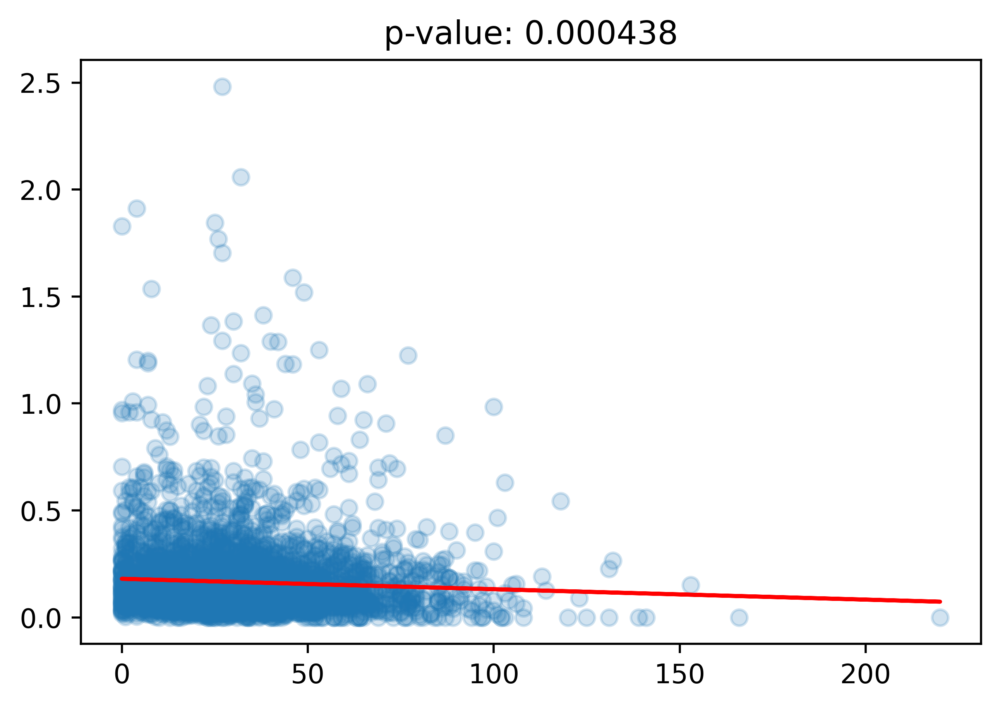

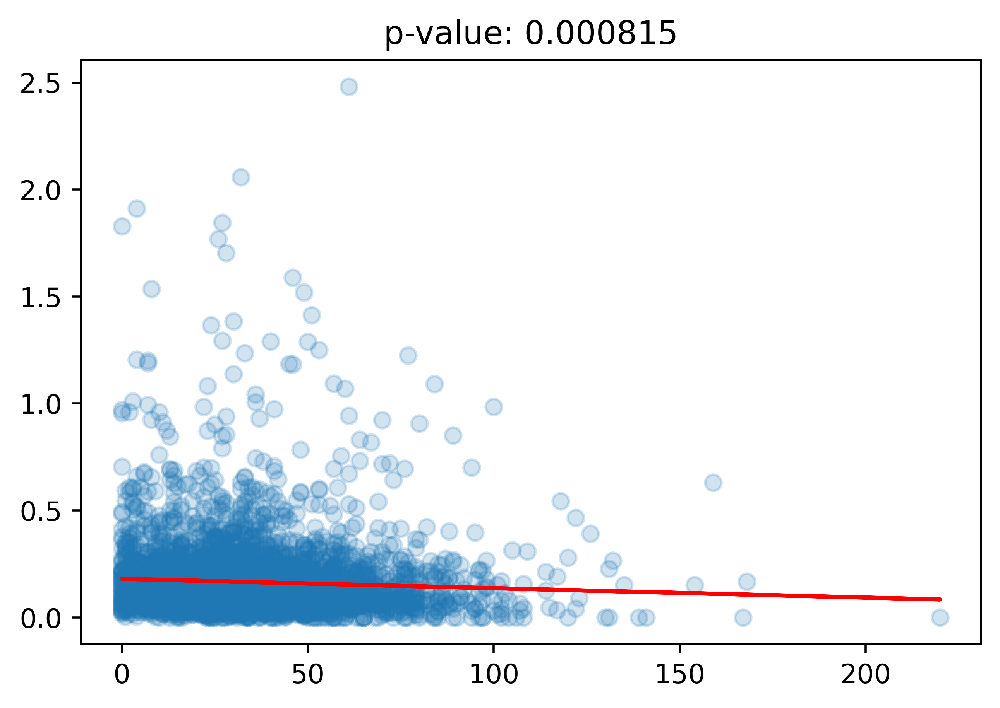

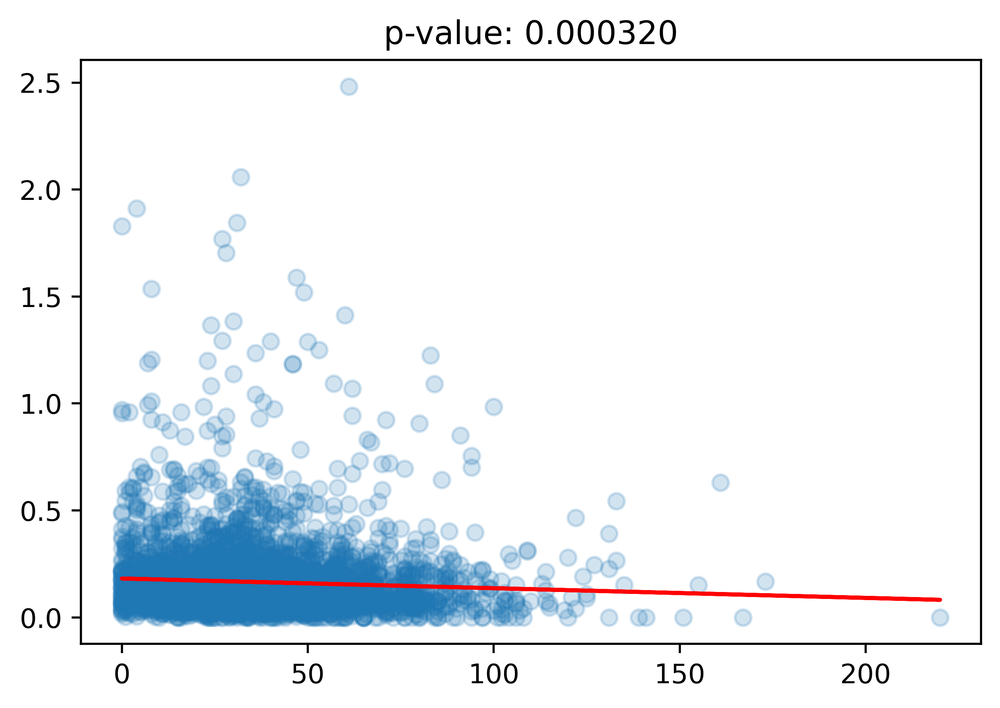

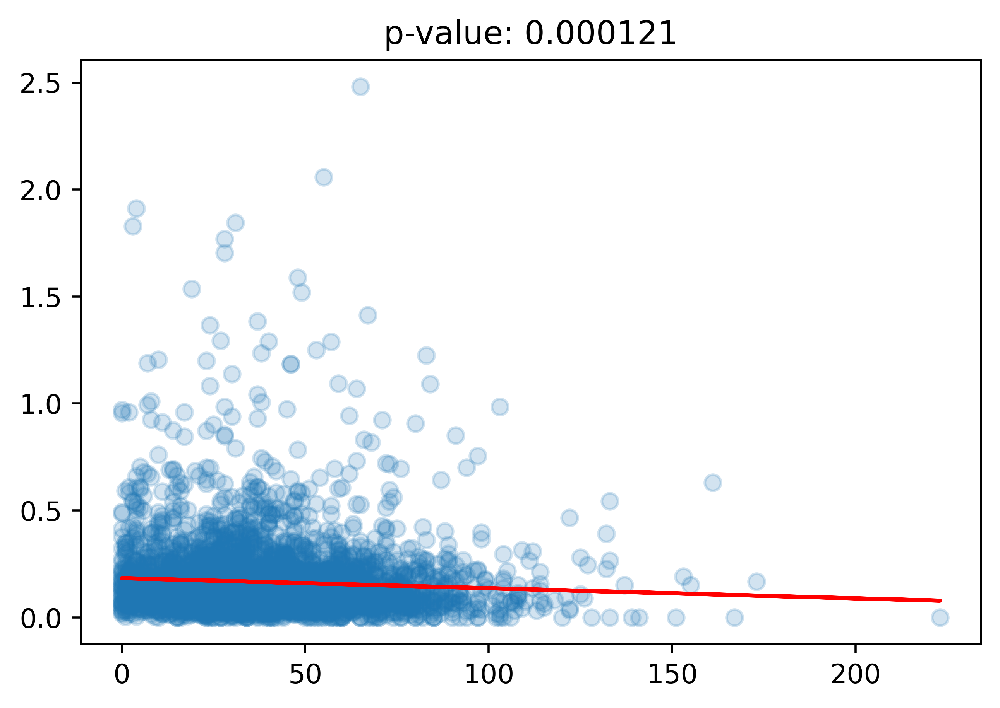

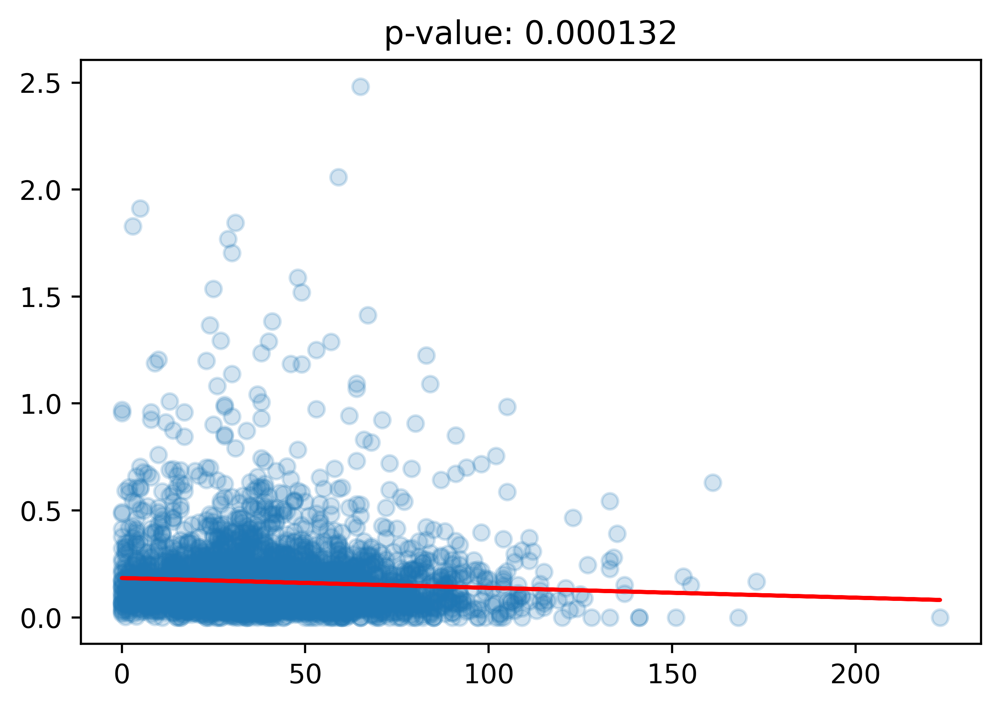

In [165]:
dnm2_max = 130
dnm2_spacing = 10
dnm2_threshold = np.arange(0, dnm2_max, dnm2_spacing)

r_vals = []

for thresh in dnm2_threshold:
    
    time_to_thresh = []
    
    for i in range(len(channel_amplitudes_arpc3_positive)):
    
        dnm2_int = channel_amplitudes_arpc3_positive[i][1]
        
        index = next(x[0] for x in enumerate(dnm2_int) if x[1] > thresh)
        
        time_to_thresh.append(index)
        
    res = stats.linregress(time_to_thresh, separation_merged)
    r_vals.append(res.pvalue)
    plt.scatter(time_to_thresh, separation_merged, alpha=0.2)
    plt.plot(time_to_thresh, res.intercept + res.slope*np.array(time_to_thresh), 'r', label='fitted line')
    plt.title(f"p-value: {res.pvalue:.6f}")
    plt.show()


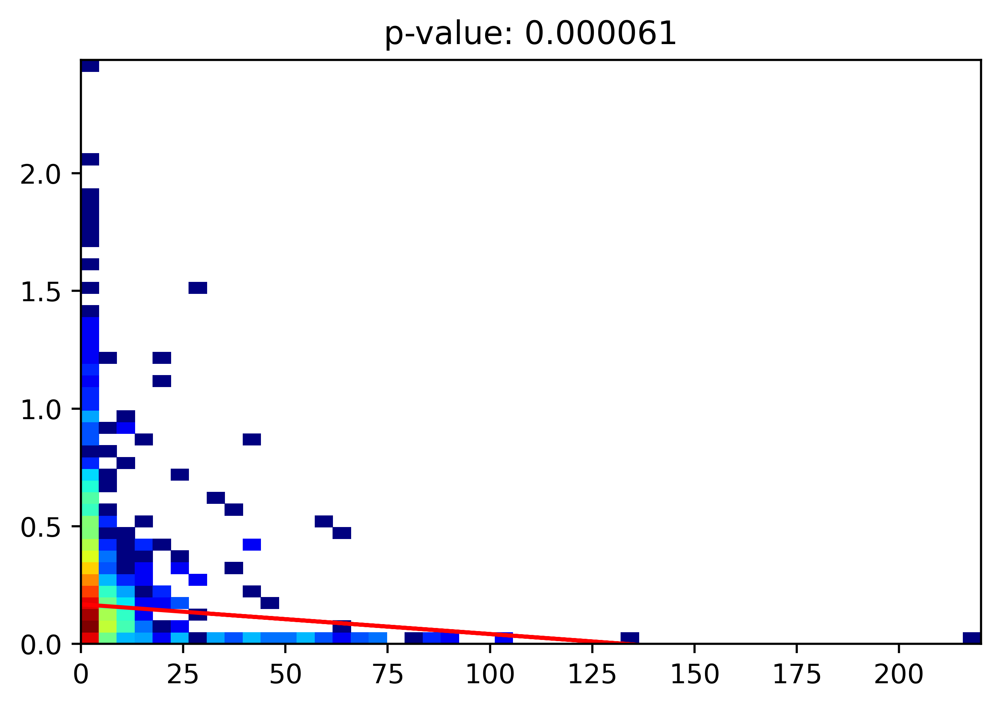

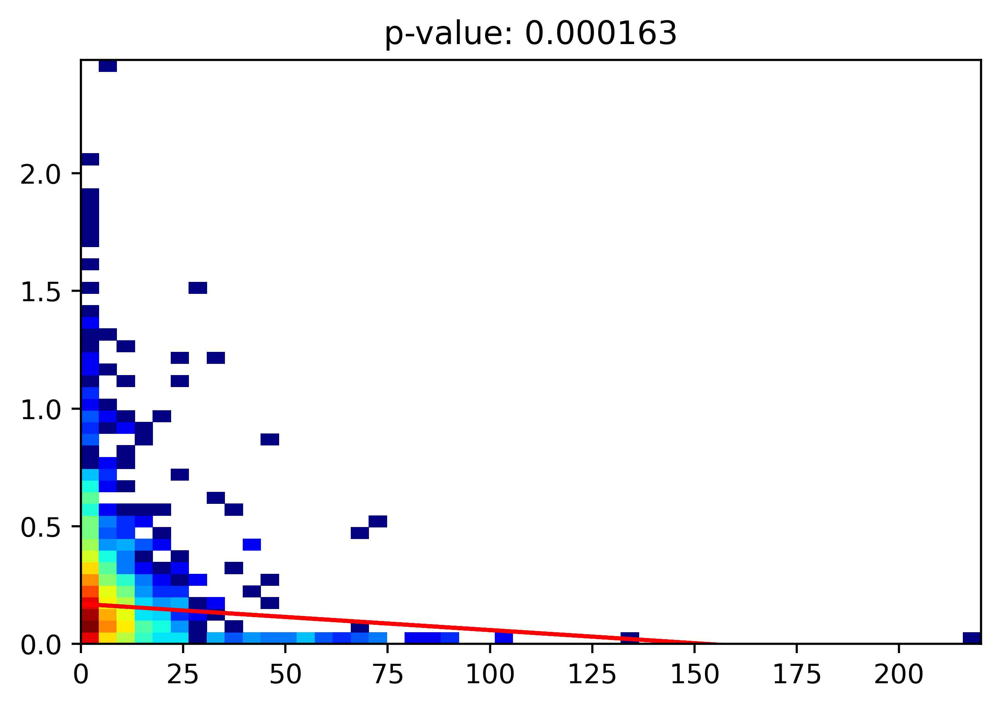

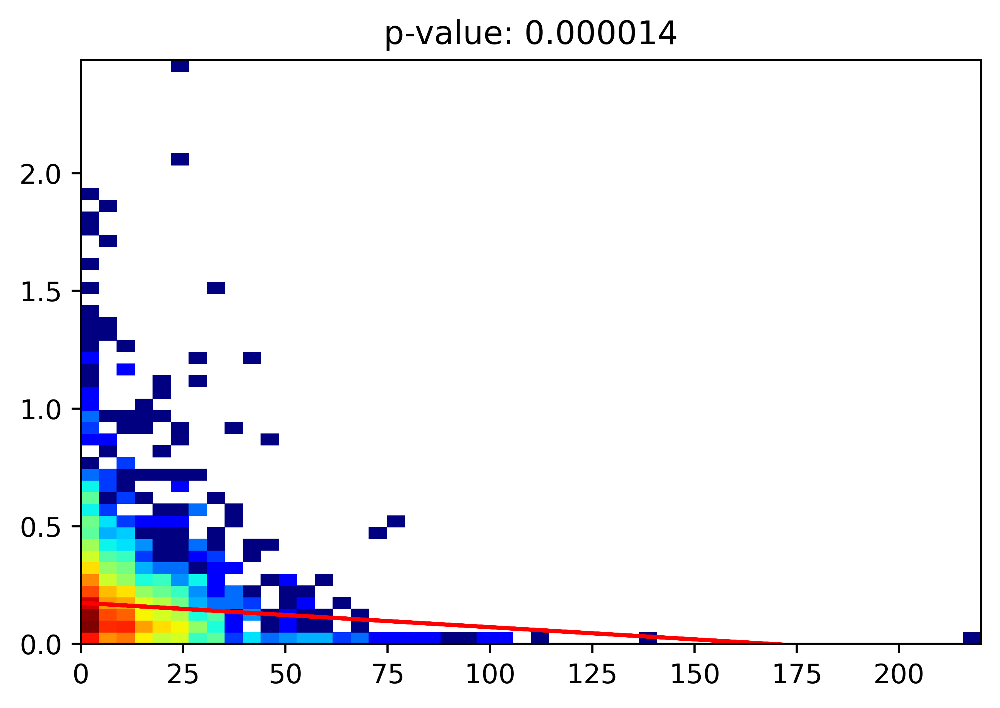

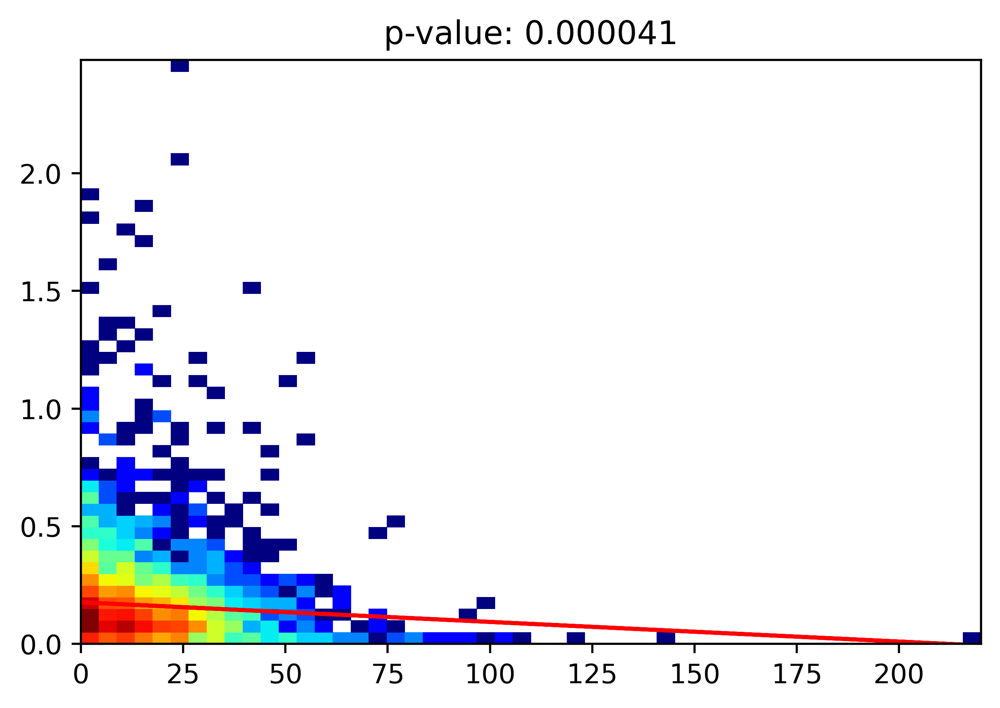

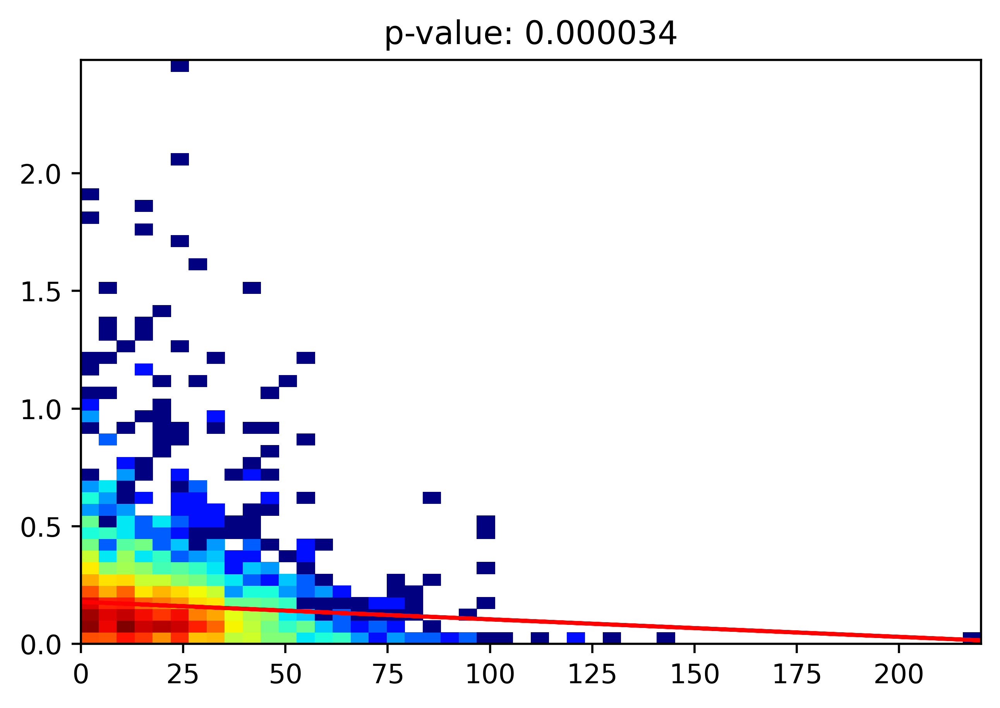

...

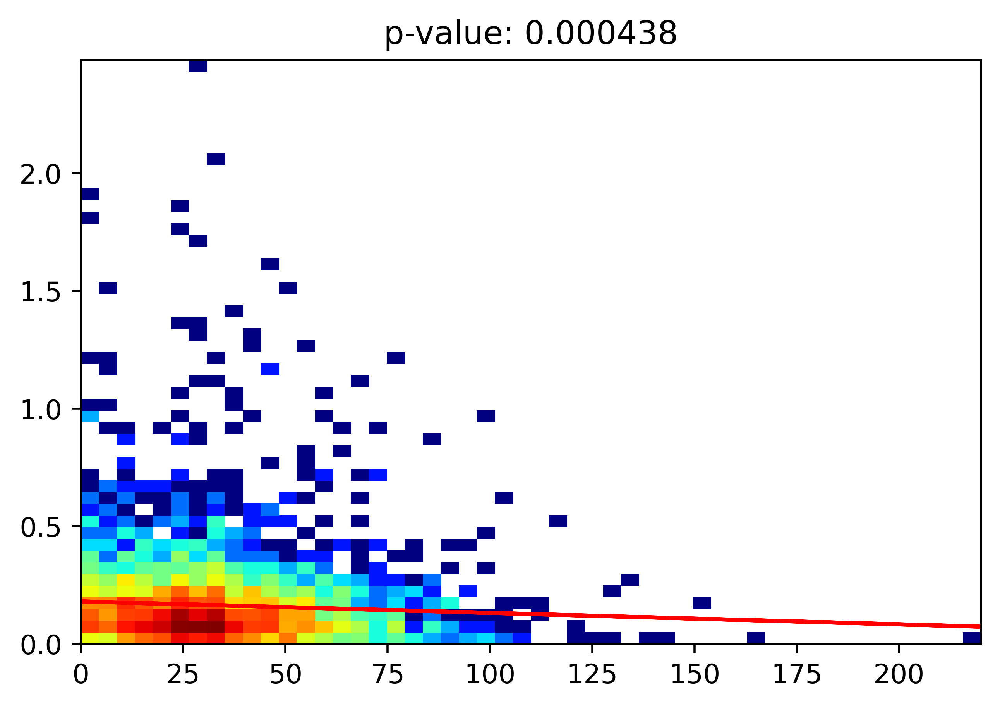

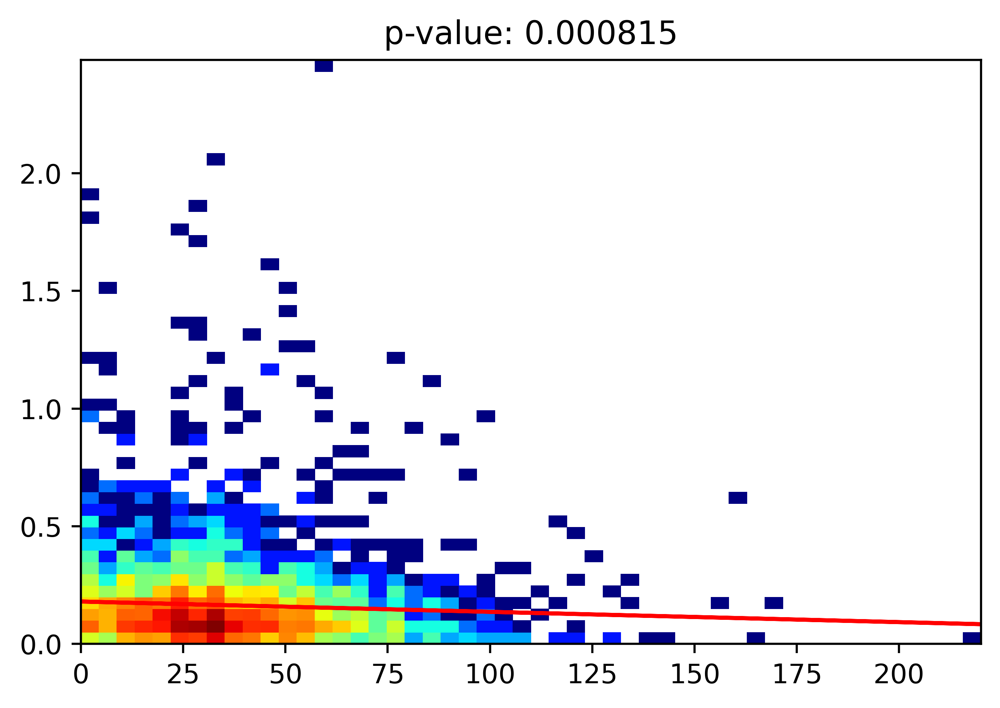

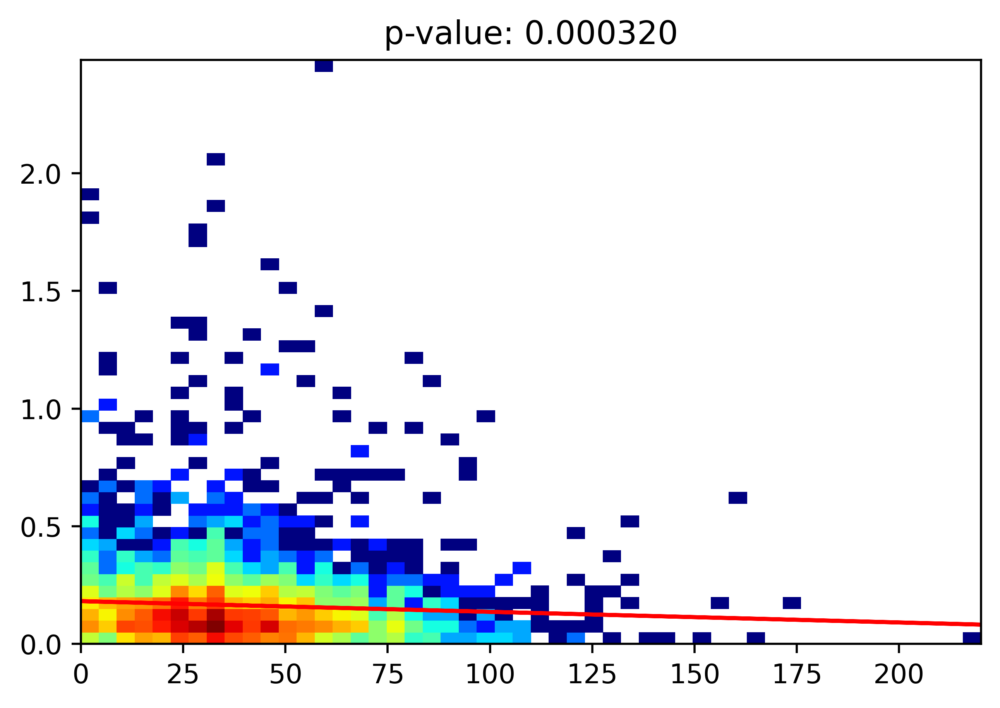

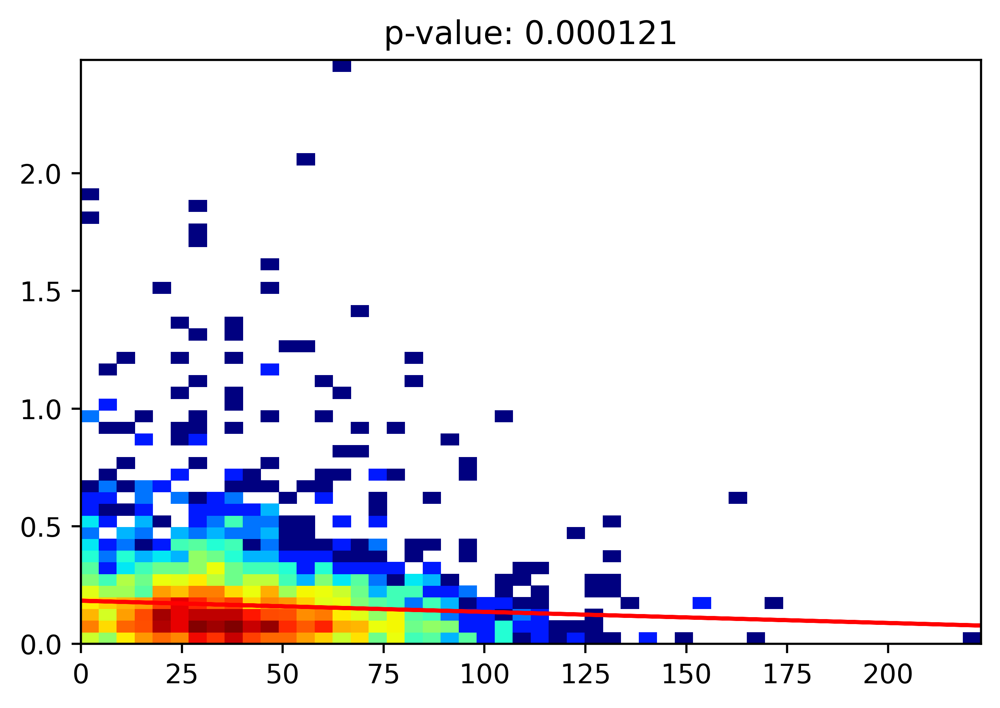

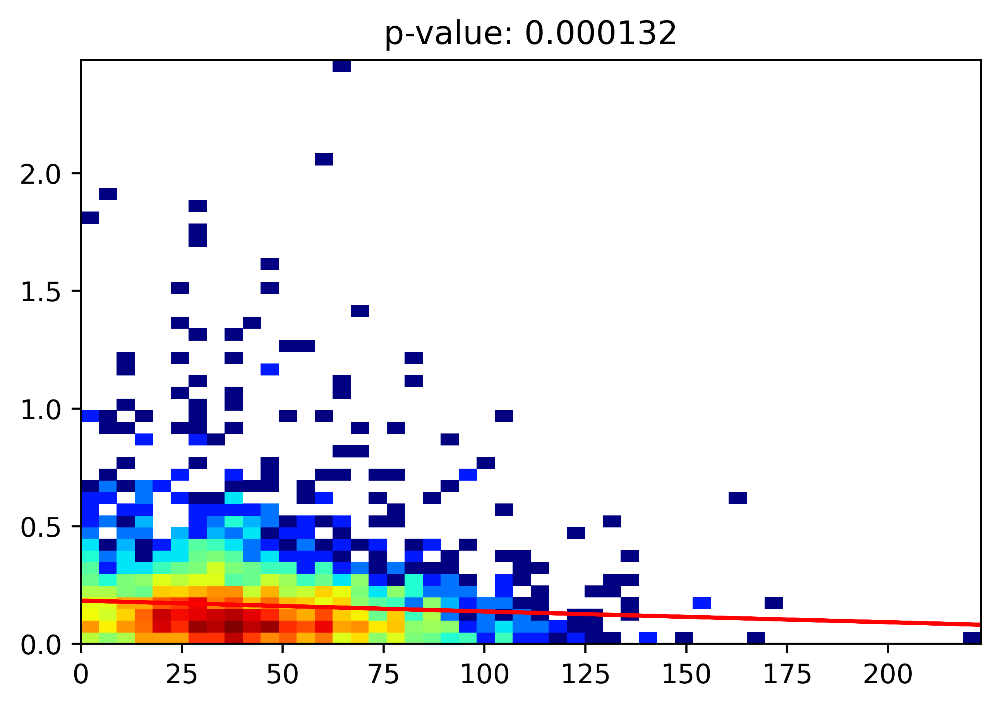

In [169]:
dnm2_max = 130
dnm2_spacing = 10
dnm2_threshold = np.arange(0, dnm2_max, dnm2_spacing)

r_vals = []

for thresh in dnm2_threshold:
    
    time_to_thresh = []
    
    for i in range(len(channel_amplitudes_arpc3_positive)):
    
        dnm2_int = channel_amplitudes_arpc3_positive[i][1]
        
        index = next(x[0] for x in enumerate(dnm2_int) if x[1] > thresh)
        
        time_to_thresh.append(index)
        
    res = stats.linregress(time_to_thresh, separation_merged)
    r_vals.append(res.pvalue)
    plt.hist2d(time_to_thresh,
             separation_merged,
             bins=50,
             norm=mpl.colors.LogNorm(),
             alpha=1,
             density=True,
             cmap='jet')
#     plt.scatter(time_to_thresh, separation_merged, alpha=0.2)
    plt.plot(time_to_thresh, res.intercept + res.slope*np.array(time_to_thresh), 'r', label='fitted line')
    plt.title(f"p-value: {res.pvalue:.6f}")
    plt.show()




0.05903404765818098
pval 8.072285838246482e-10
rval -0.2172699487055252


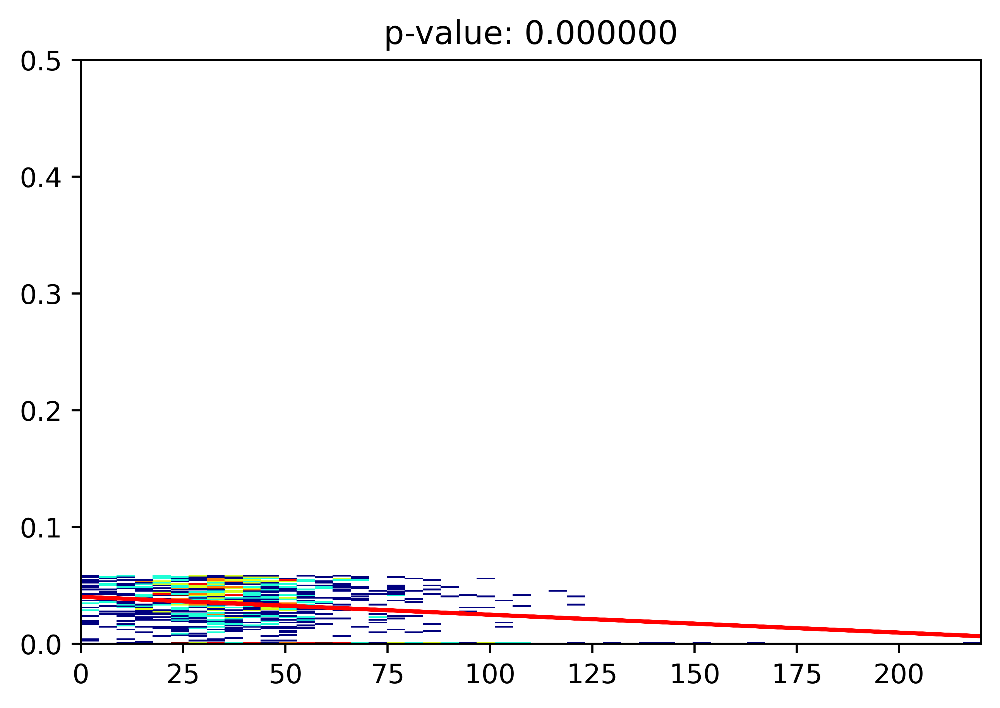

0.06058646937554424
pval 8.051403854182052e-10
rval -0.21217196132522245


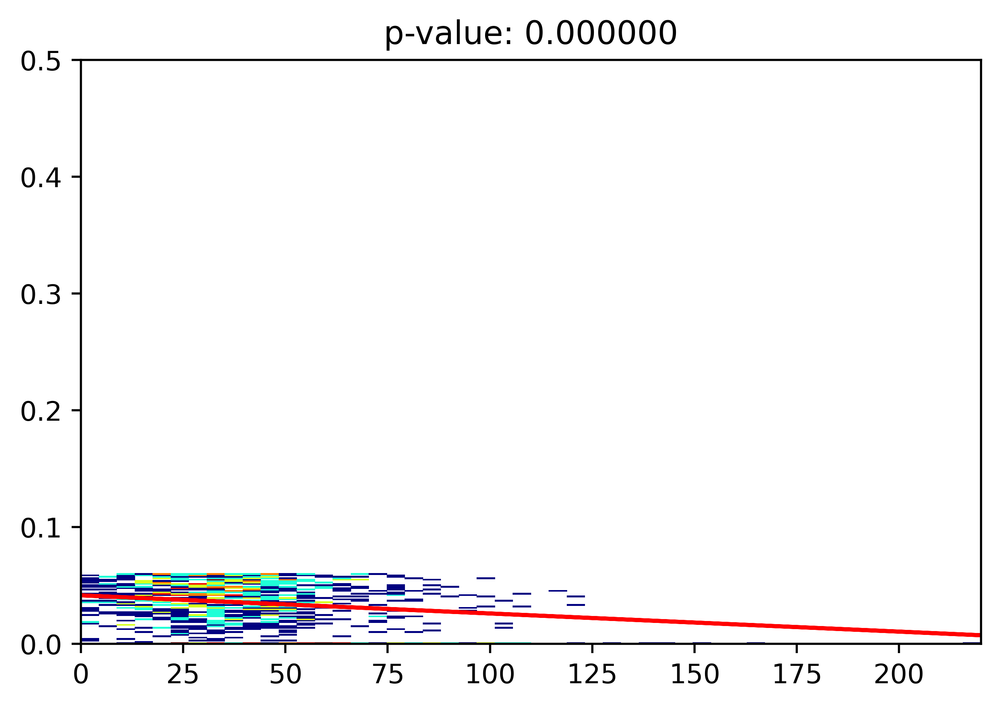

0.06261623974896828
pval 9.551947630851126e-11
rval -0.21828047342615248


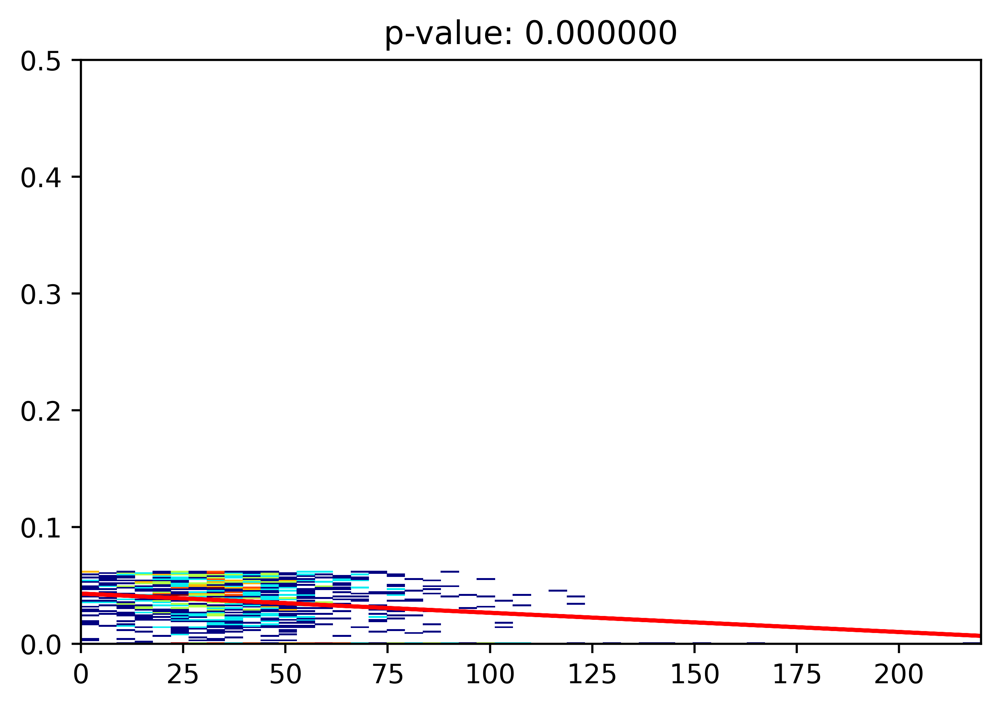

0.06426737968427113
pval 1.2521027093165765e-09
rval -0.2006637961559435


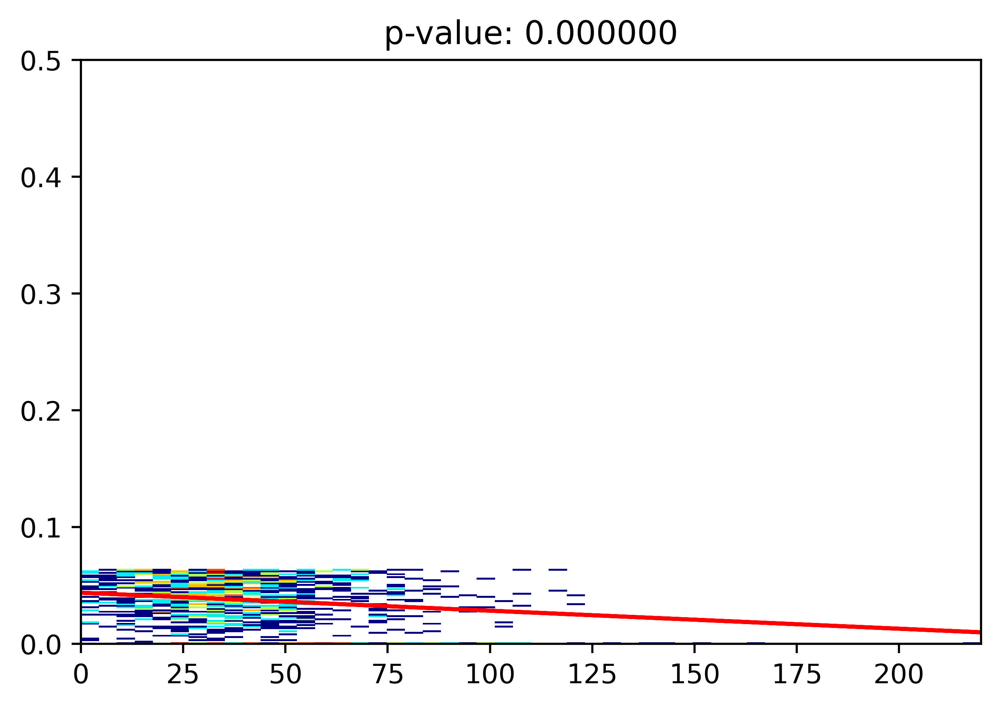

0.06575711405774862
pval 1.009809368974296e-09
rval -0.19761662988641399


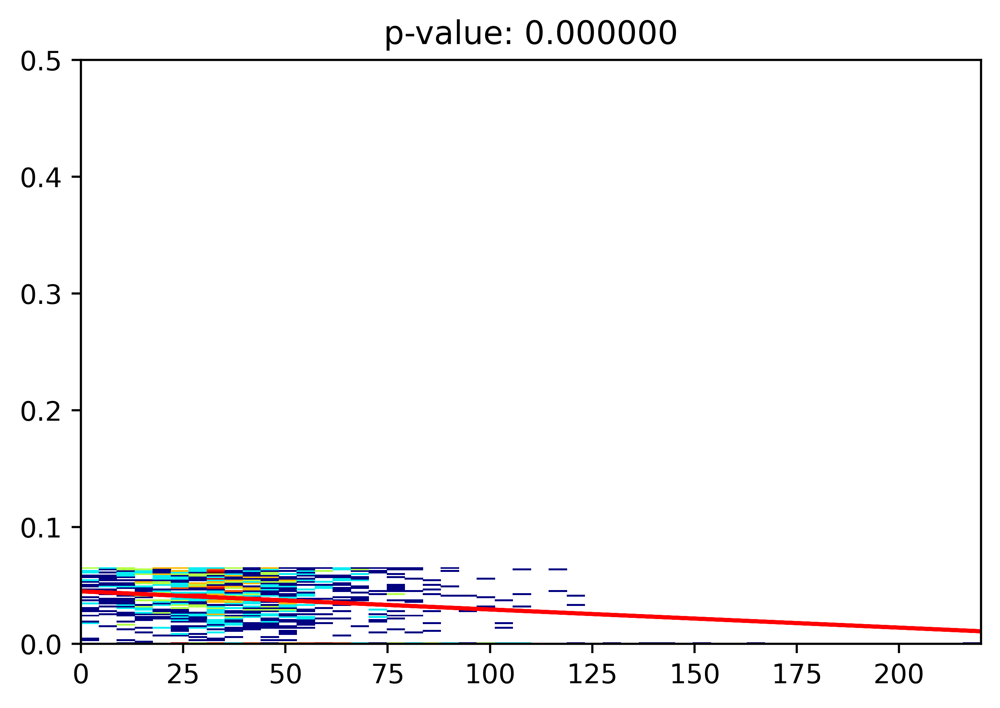

0.06787701392174683
pval 8.964678560780537e-11
rval -0.20536696269090315


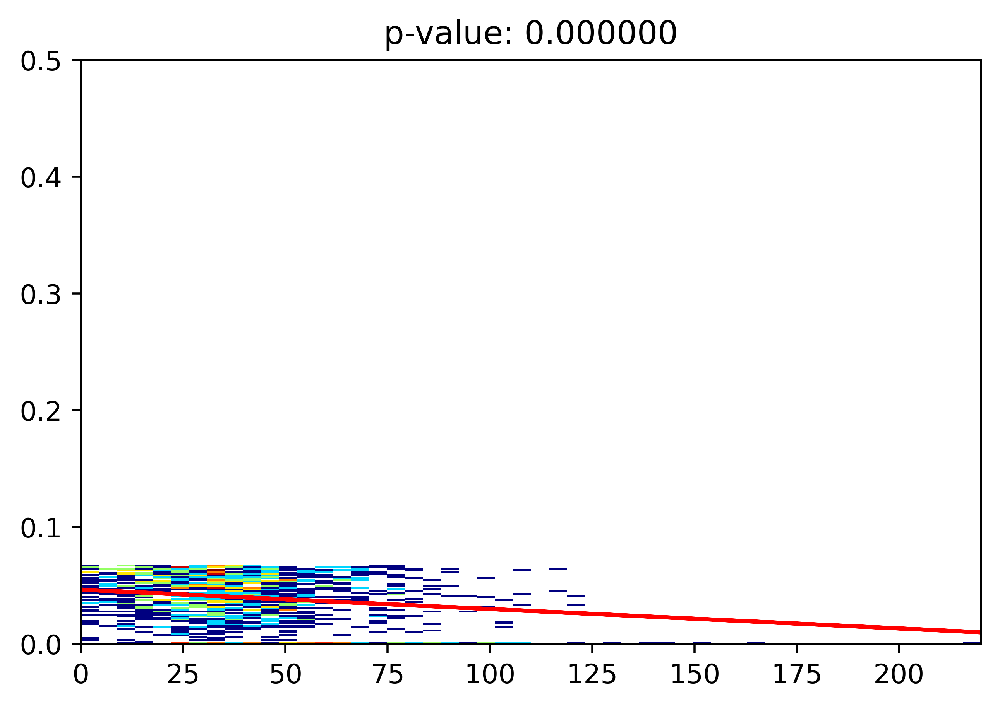

0.06973438480690554
pval 1.7254744895103854e-11
rval -0.20888367261506546


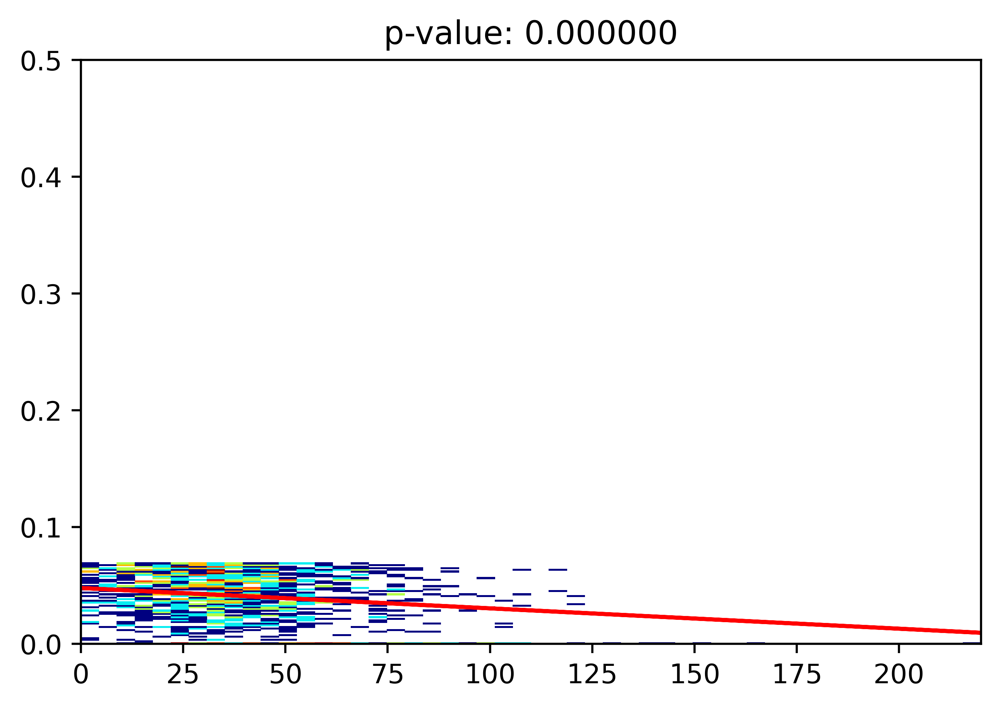

0.07164386358541086
pval 1.3090501975021421e-10
rval -0.19606001041920362


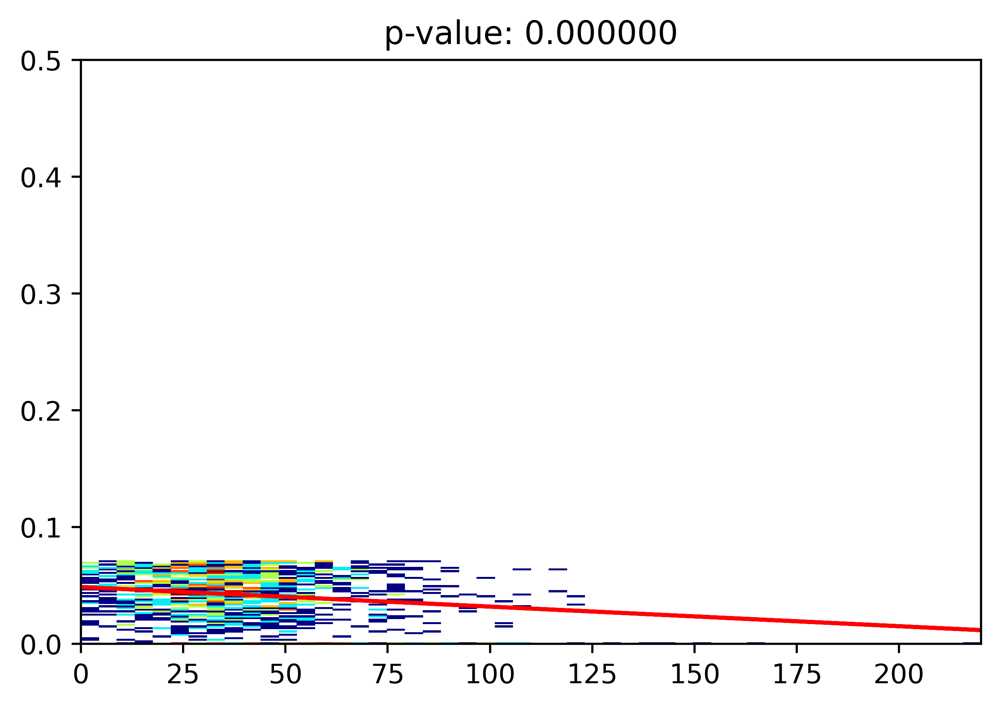

0.07347935497395551
pval 1.6567711151667008e-09
rval -0.18079567699229895


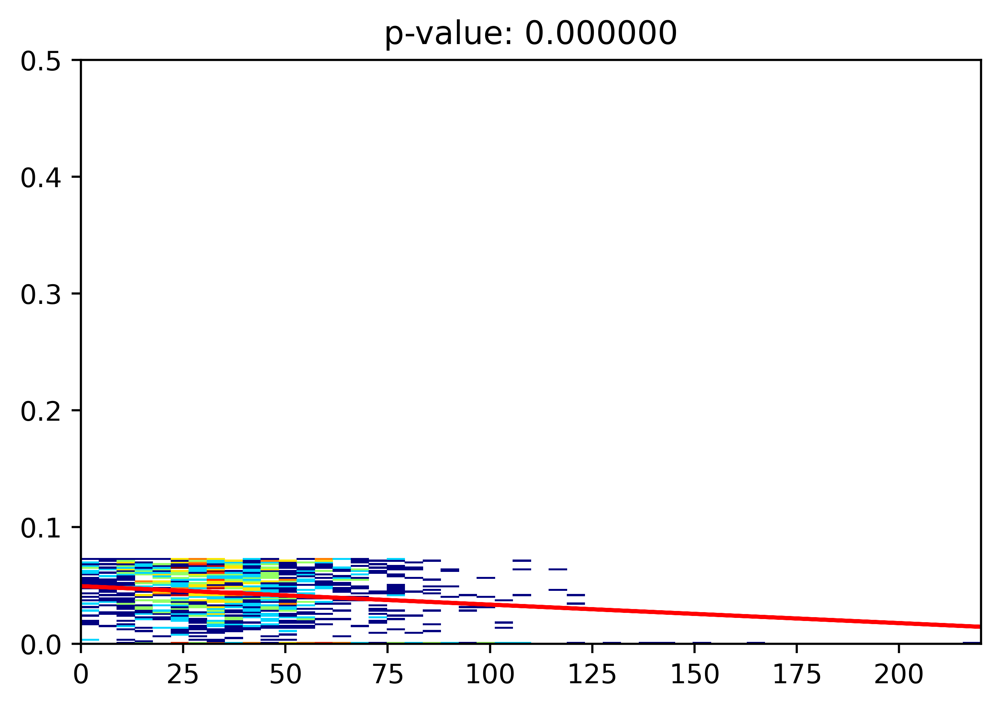

0.07510572710244486
pval 8.080267442560968e-10
rval -0.18104109989296496


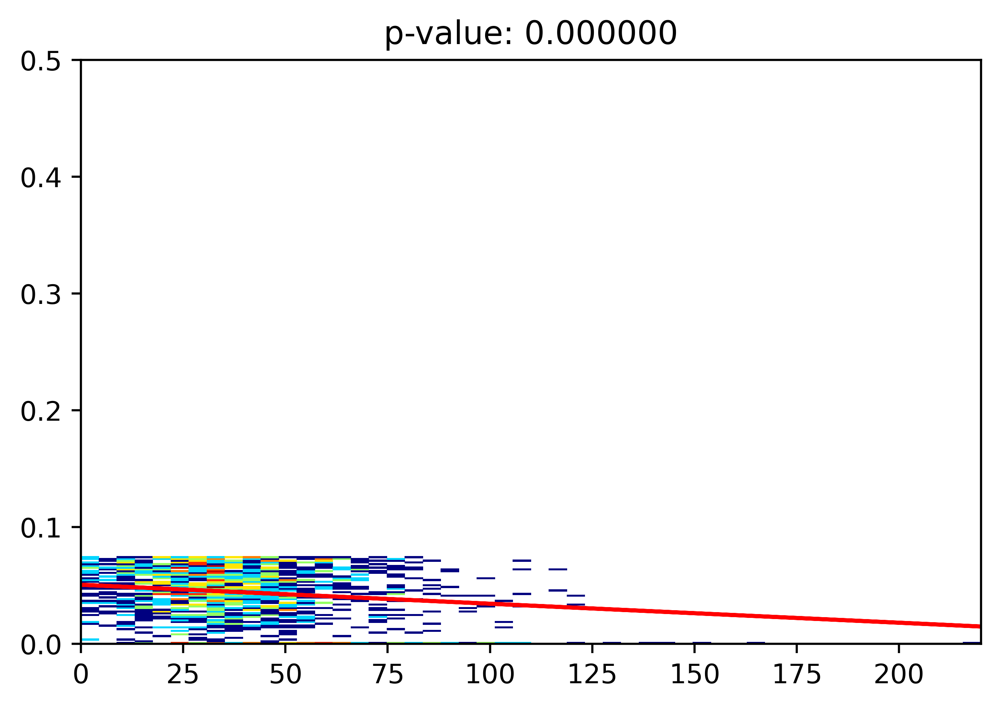

0.0767880087130757
pval 3.8930941495516746e-08
rval -0.15953403508215908


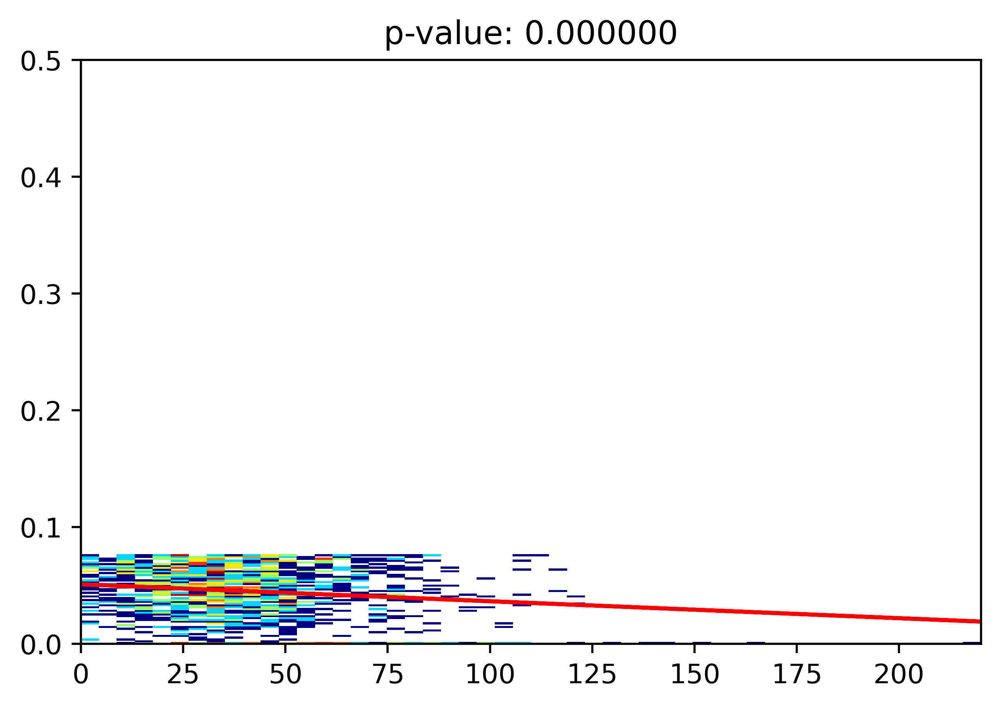

0.07864889199245016
pval 3.0619600020804648e-06
rval -0.13352711544587711


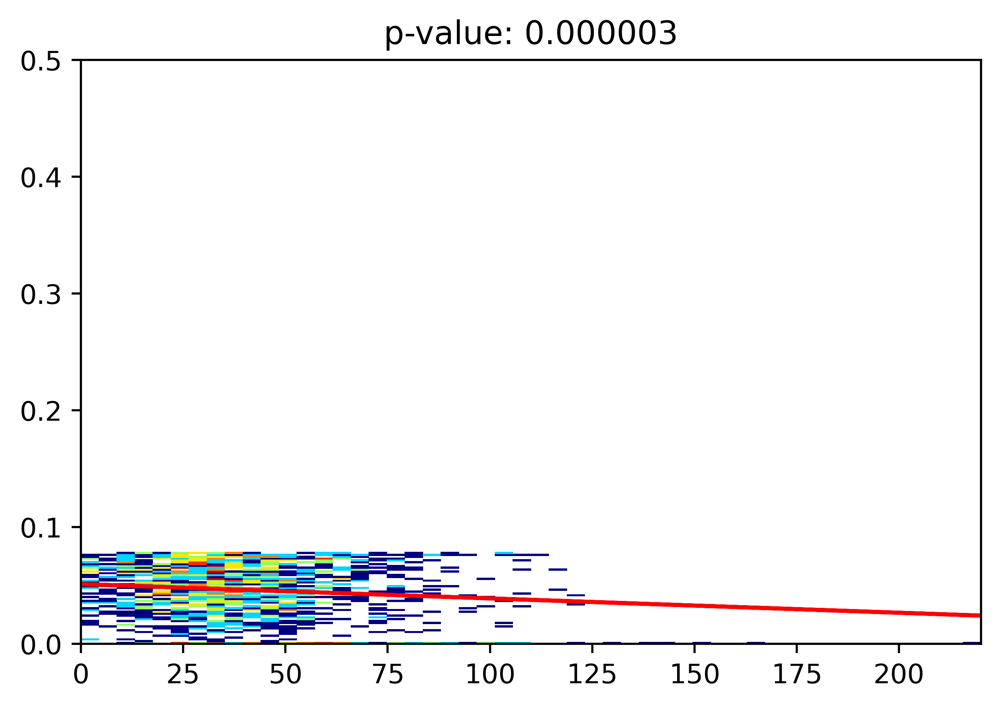

0.08079760178027459
pval 1.1664166842635985e-06
rval -0.13687692339035995


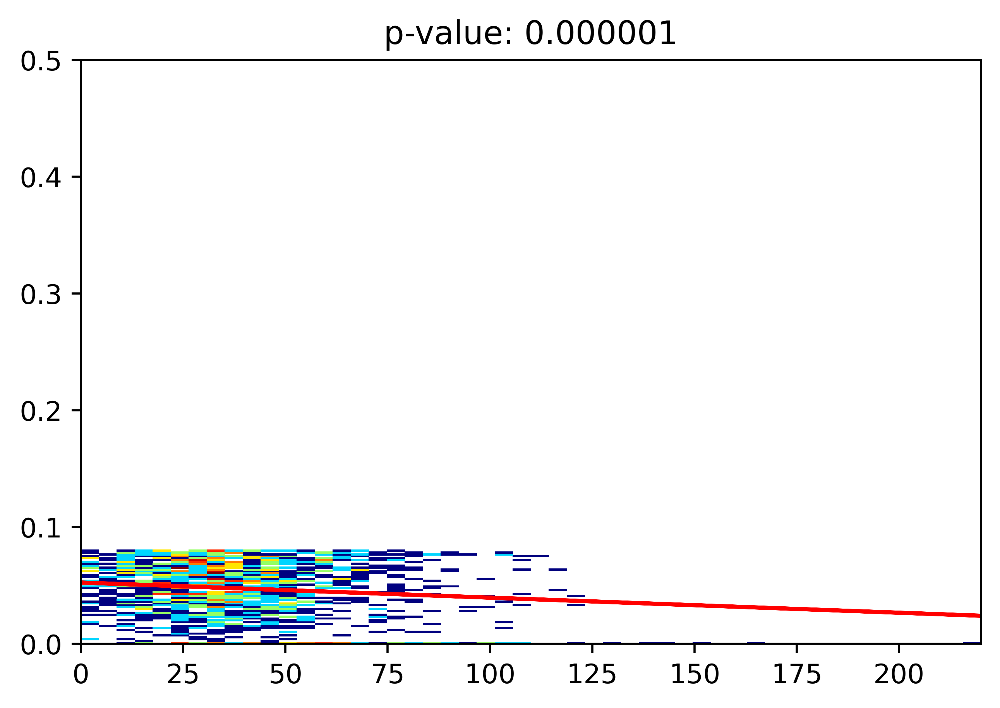

0.08244233433168335
pval 5.367201310727433e-06
rval -0.12624588637181172


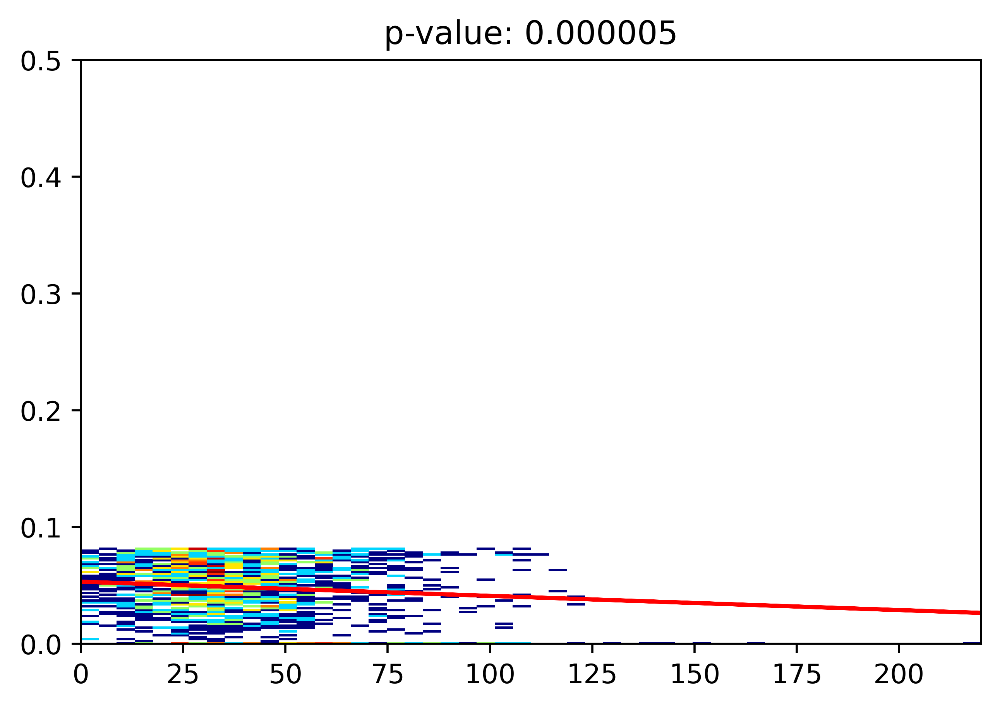

0.08411672559331122
pval 5.503928350512349e-06
rval -0.12424857312393067


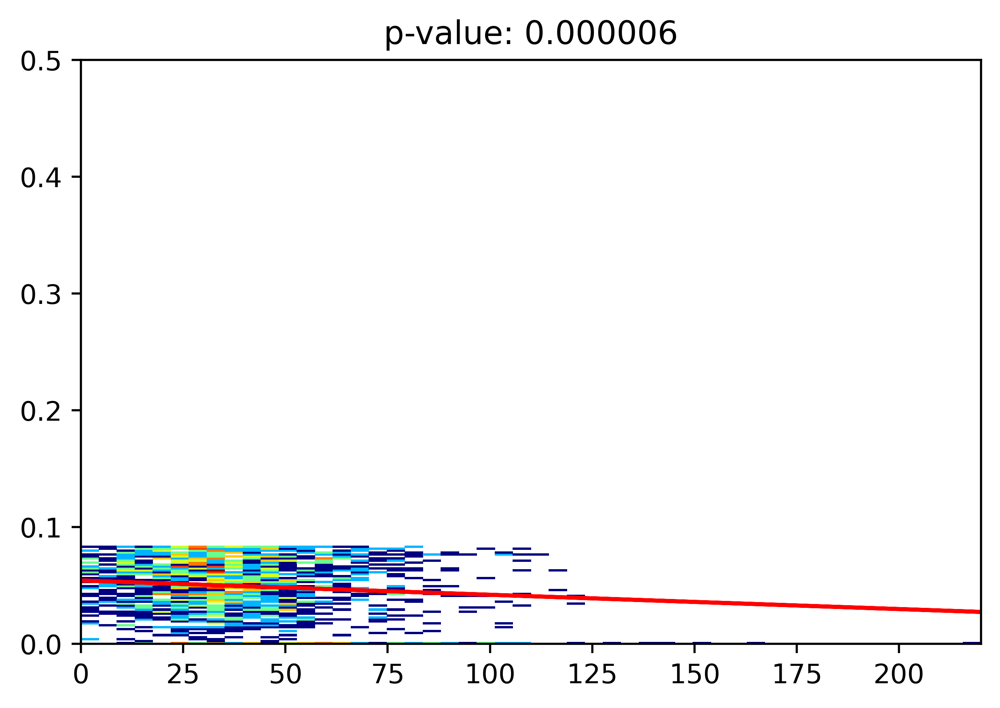

0.08637468789841135
pval 5.736117735141304e-06
rval -0.12224325090382618


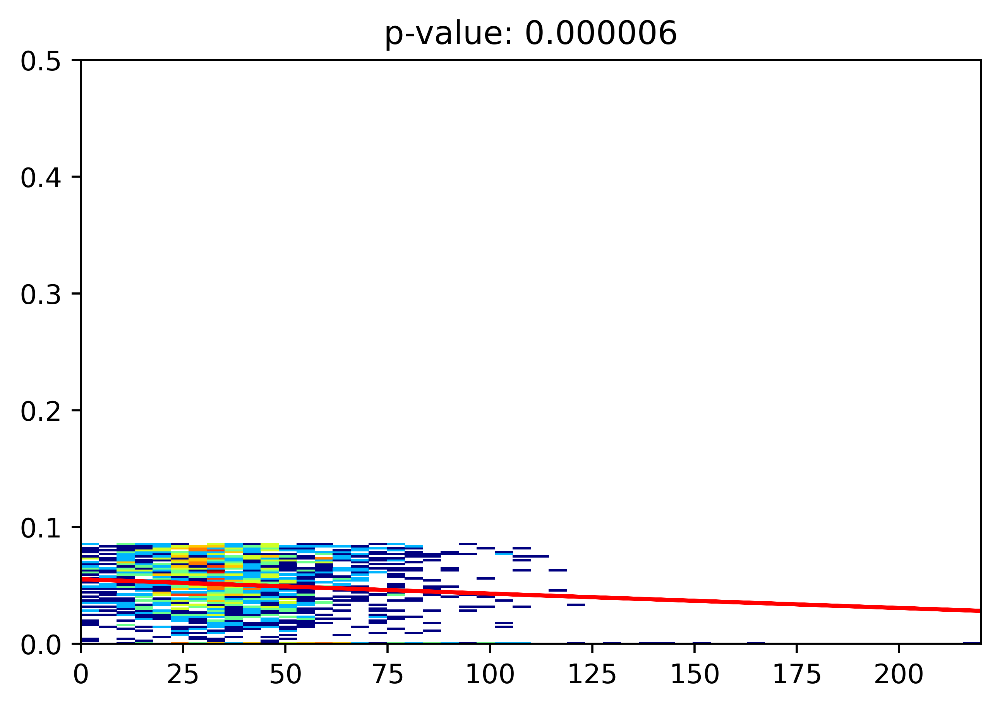

0.0883408459824239
pval 1.1305288452111563e-05
rval -0.11671270547489648


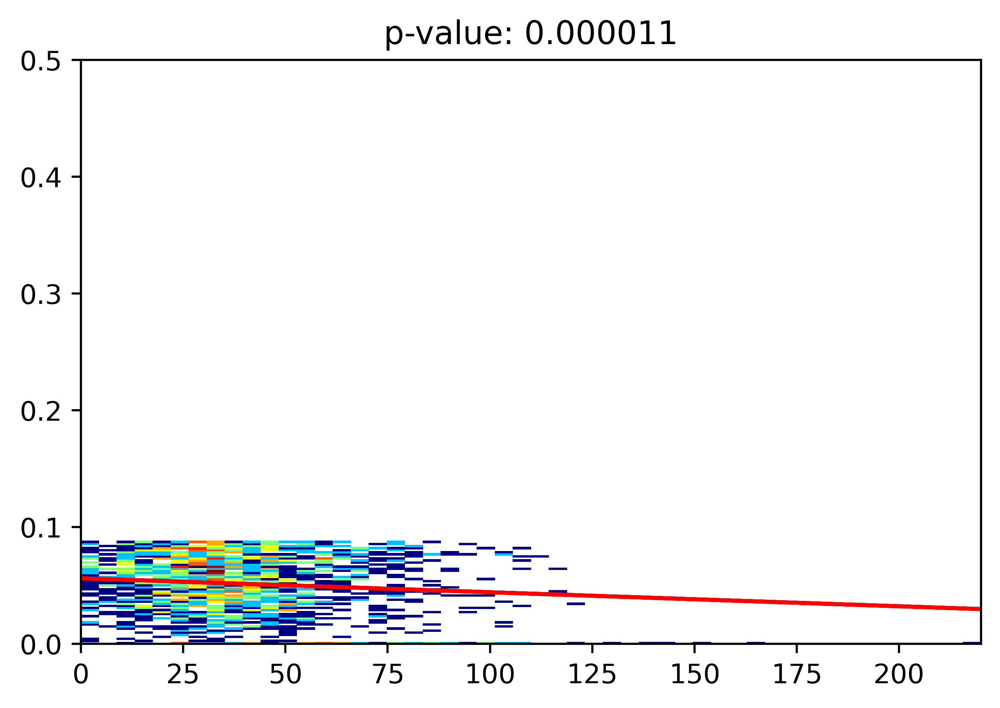

0.09059059108873799
pval 9.593189135005757e-06
rval -0.1160236966862146


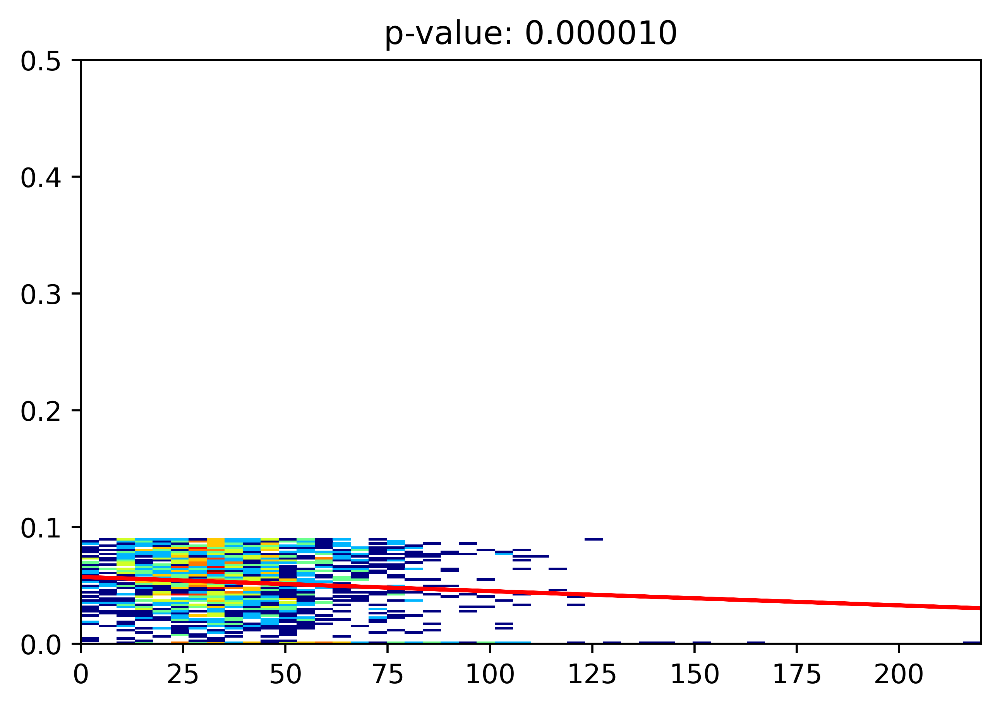

0.09231330628184599
pval 7.177254433783576e-06
rval -0.11609835068037161


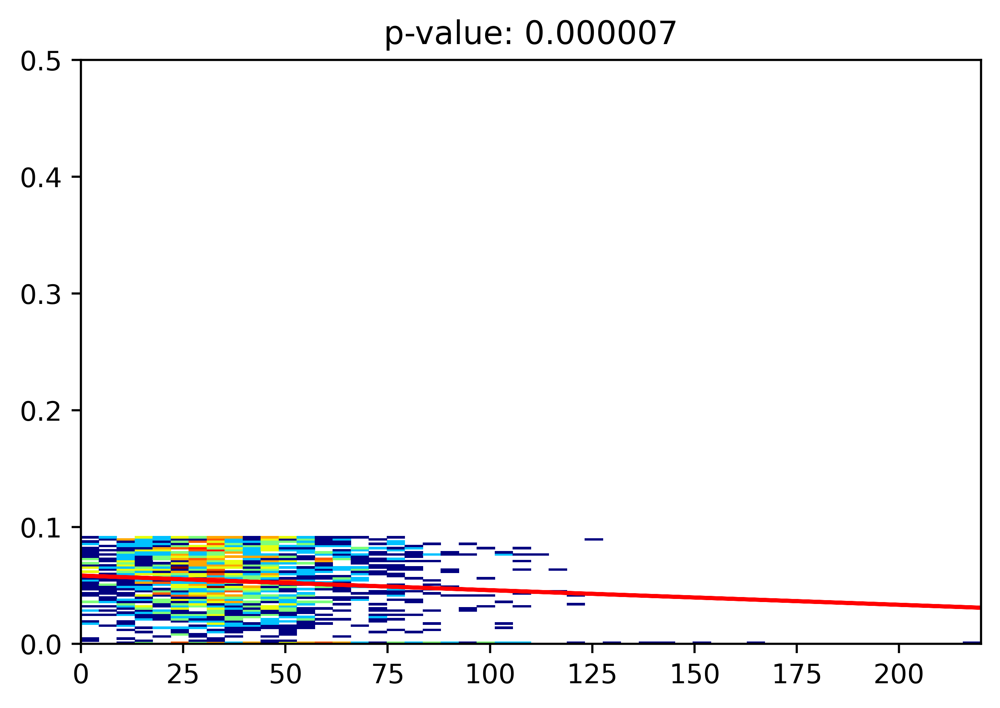

0.094682508689685
pval 9.375236930677778e-06
rval -0.11315994574815216


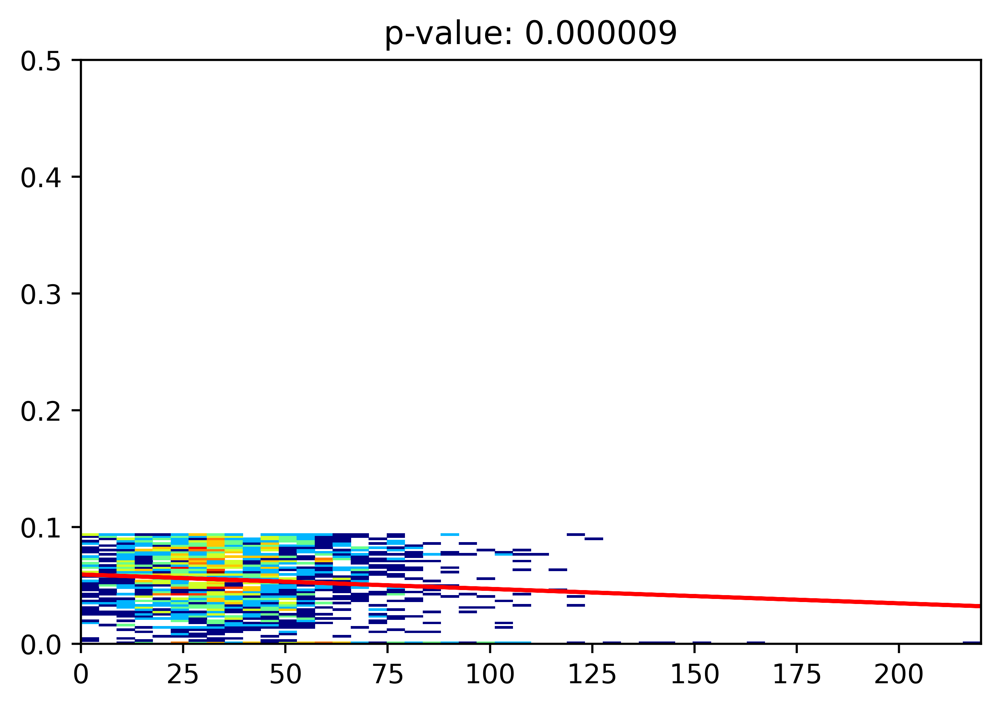

0.09678326150167499
pval 3.1398707966195556e-06
rval -0.11751760182433997


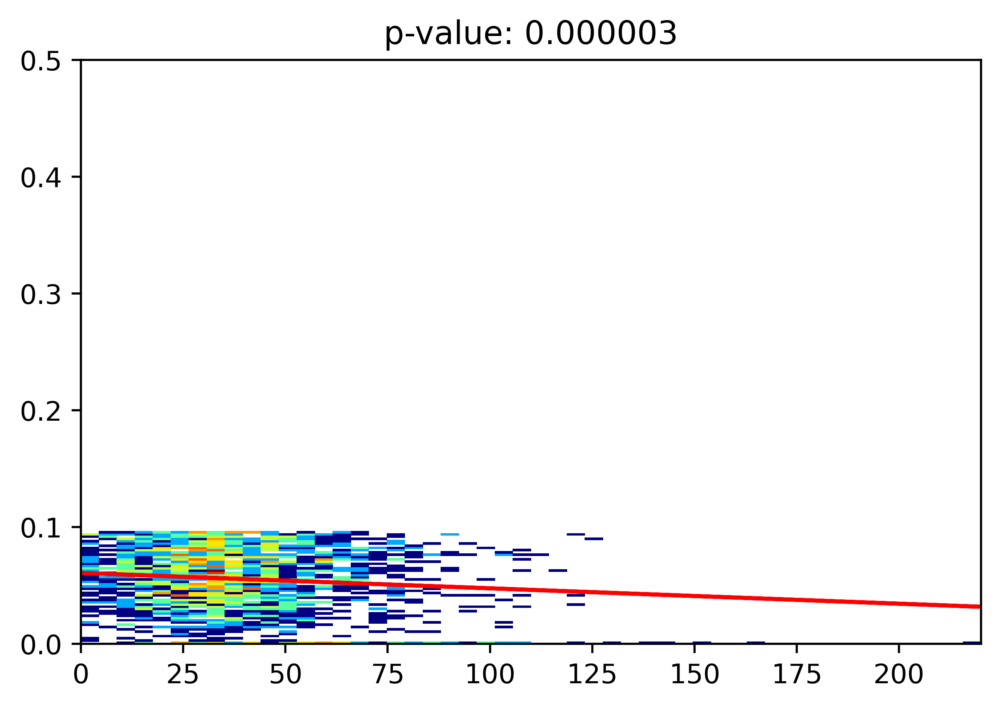

0.09942785404218897
pval 1.5456796237847438e-06
rval -0.11964312925821975


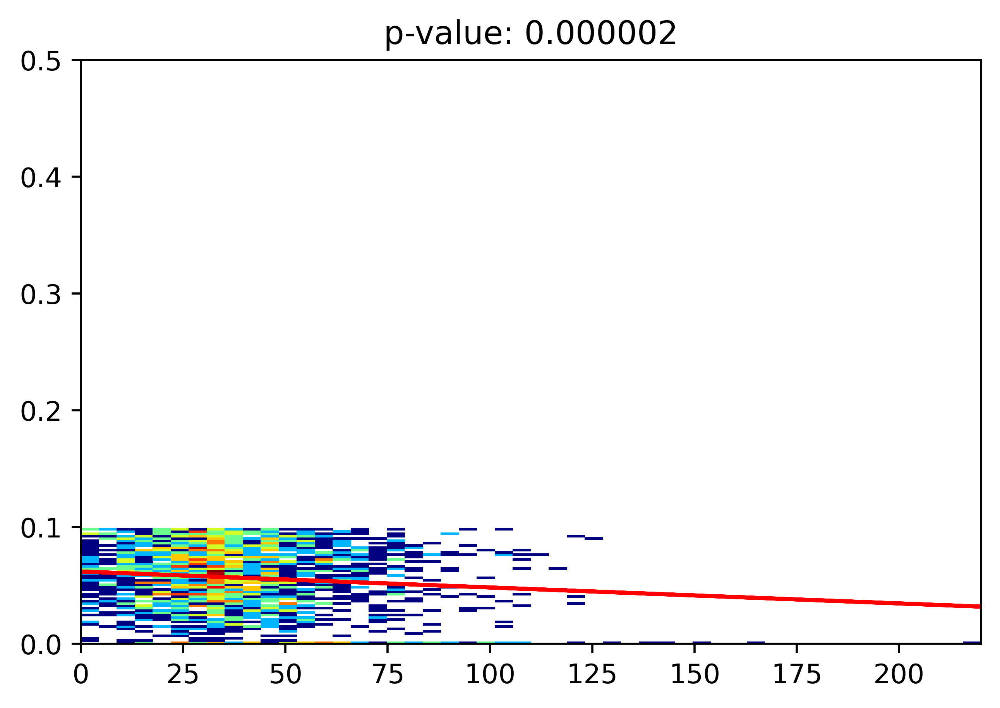

0.10179904615275487
pval 7.711577741084677e-06
rval -0.11010108977980991


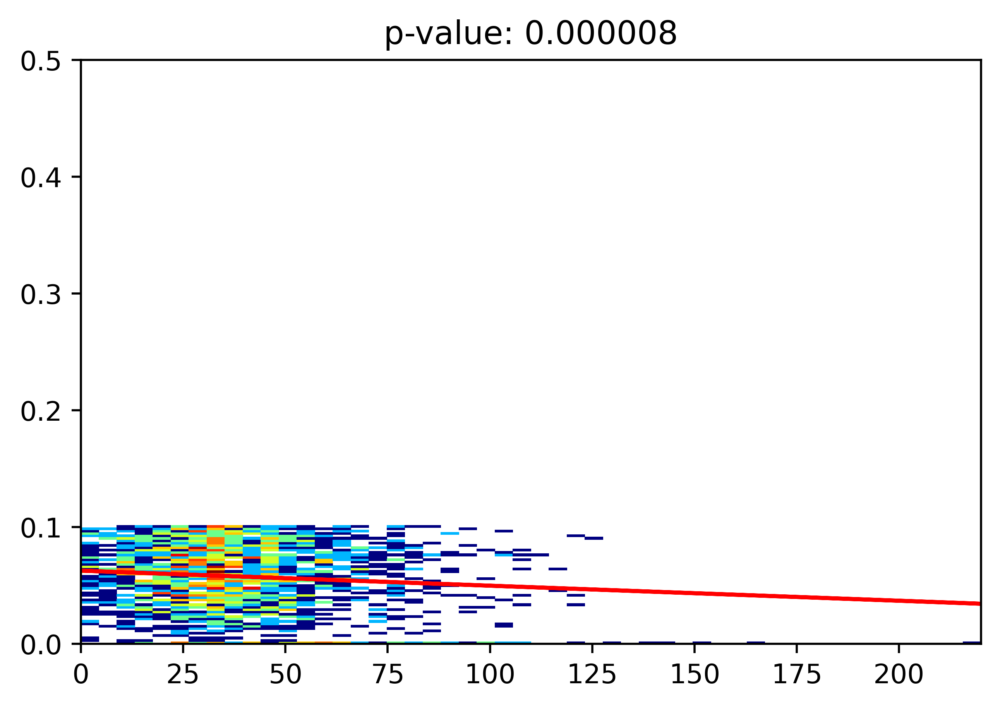

0.10442977817643709
pval 5.953189936114816e-06
rval -0.11015305548787326


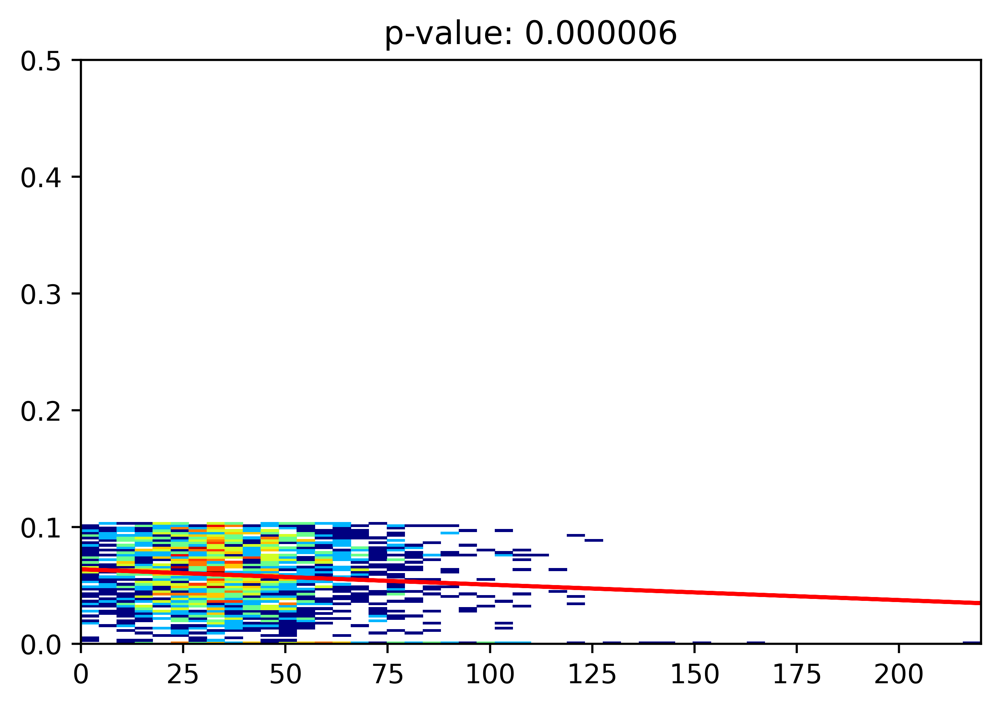

0.1070303429487273
pval 1.924204487721653e-06
rval -0.11447569604266372


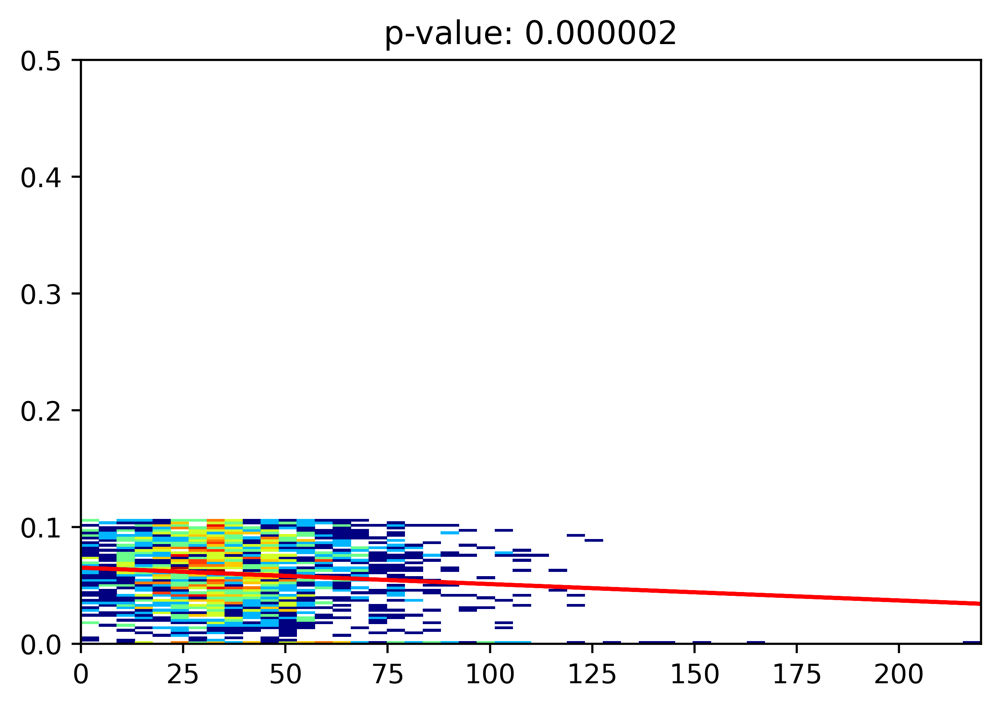

0.1095723461982482
pval 3.7081988677388077e-06
rval -0.11003729820953442


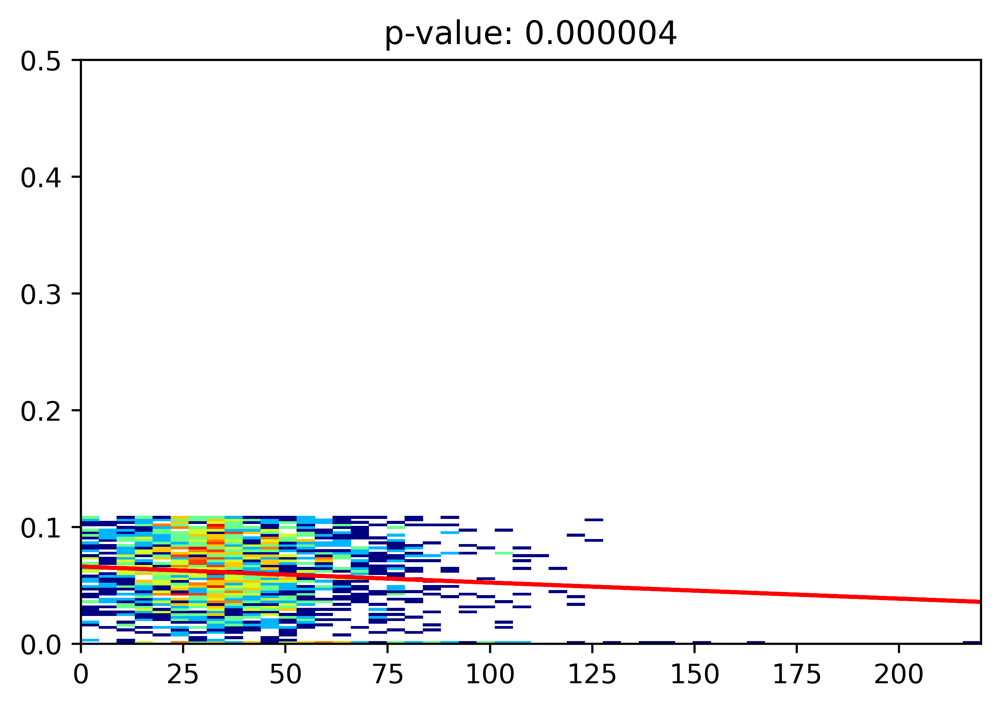

0.11210185489938204
pval 3.929048312364563e-07
rval -0.1192129975324591


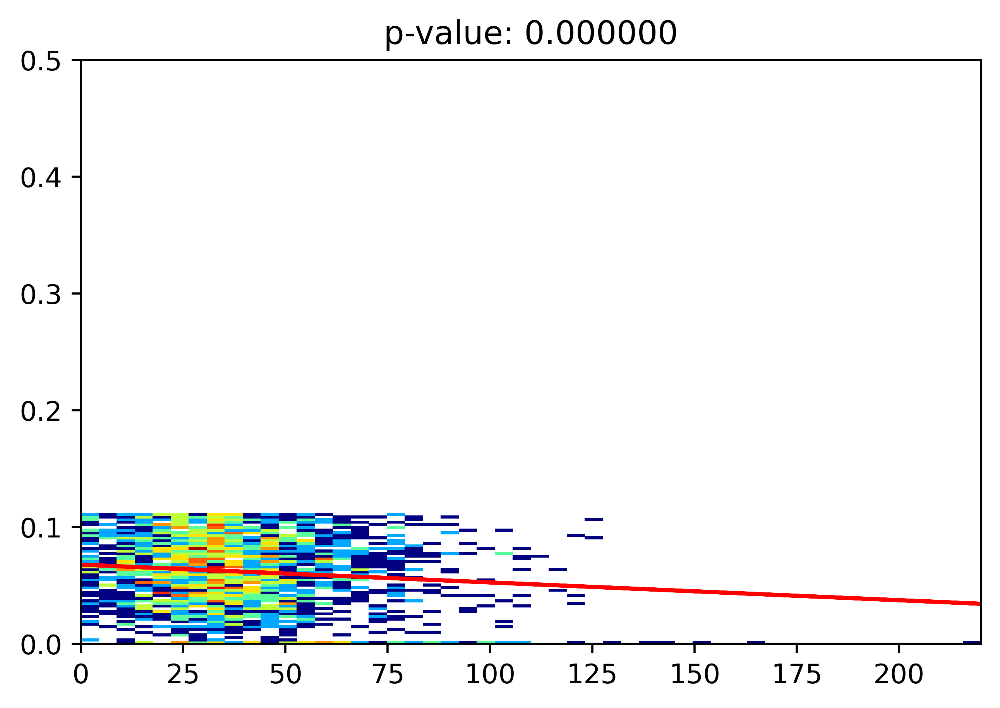

0.11431141334188817
pval 3.2682822775935457e-06
rval -0.10826225234435773


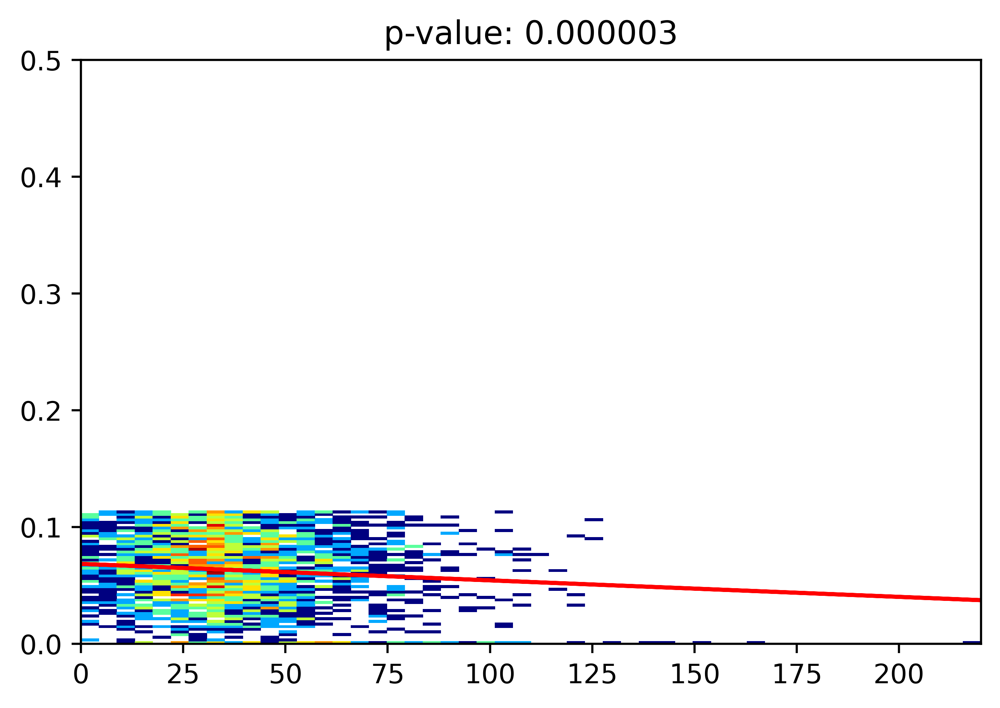

0.11655803788810873
pval 1.229594805416313e-06
rval -0.11165925647604125


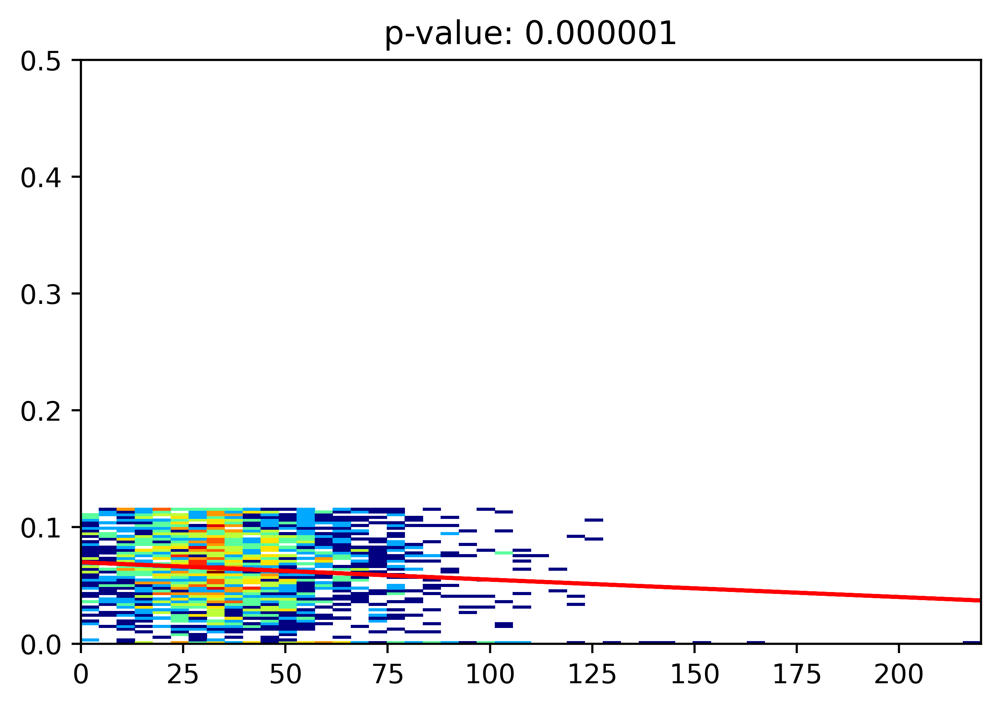

0.1187567368054618
pval 3.5935139168154946e-07
rval -0.11592168864681801


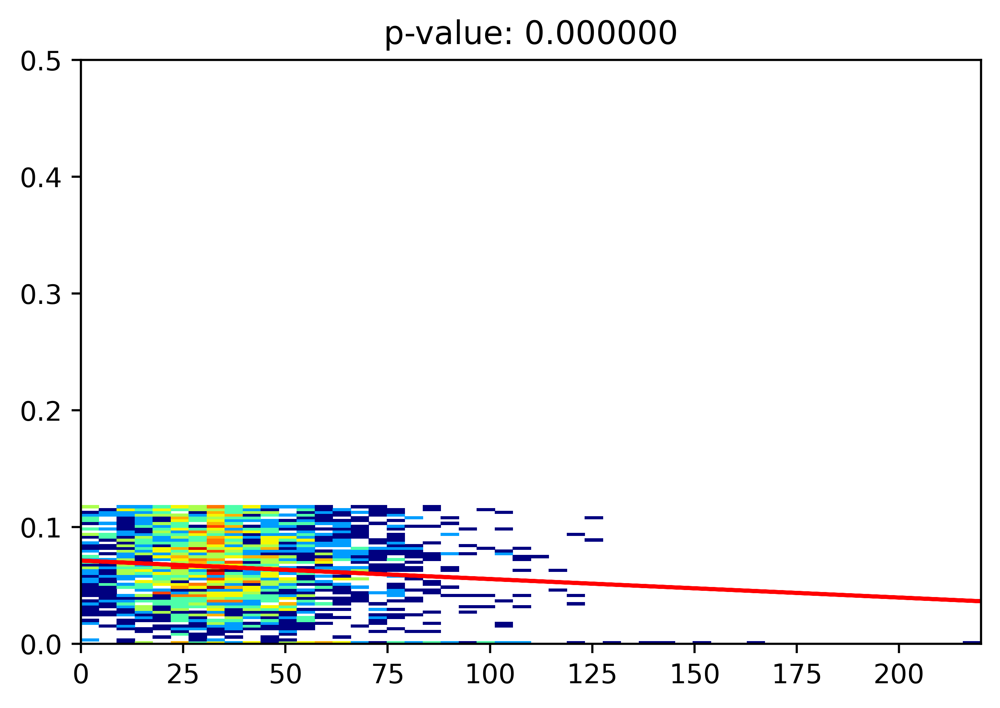

0.12073979743881422
pval 3.97540779780173e-08
rval -0.12377840215424199


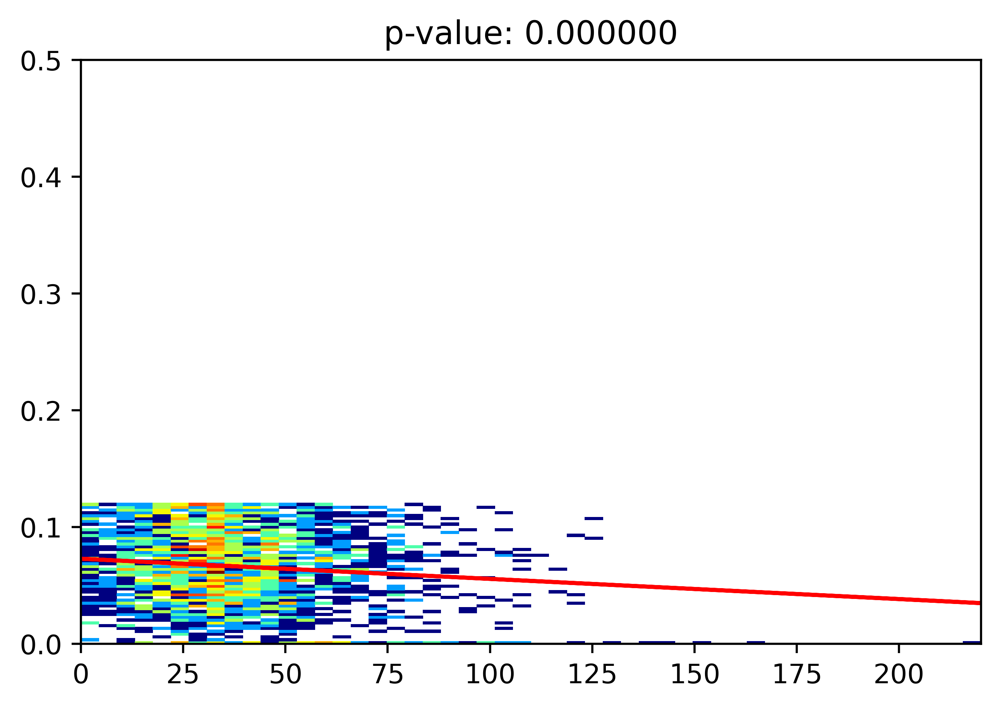

0.12296293014490625
pval 7.594126286917676e-09
rval -0.1288855106351624


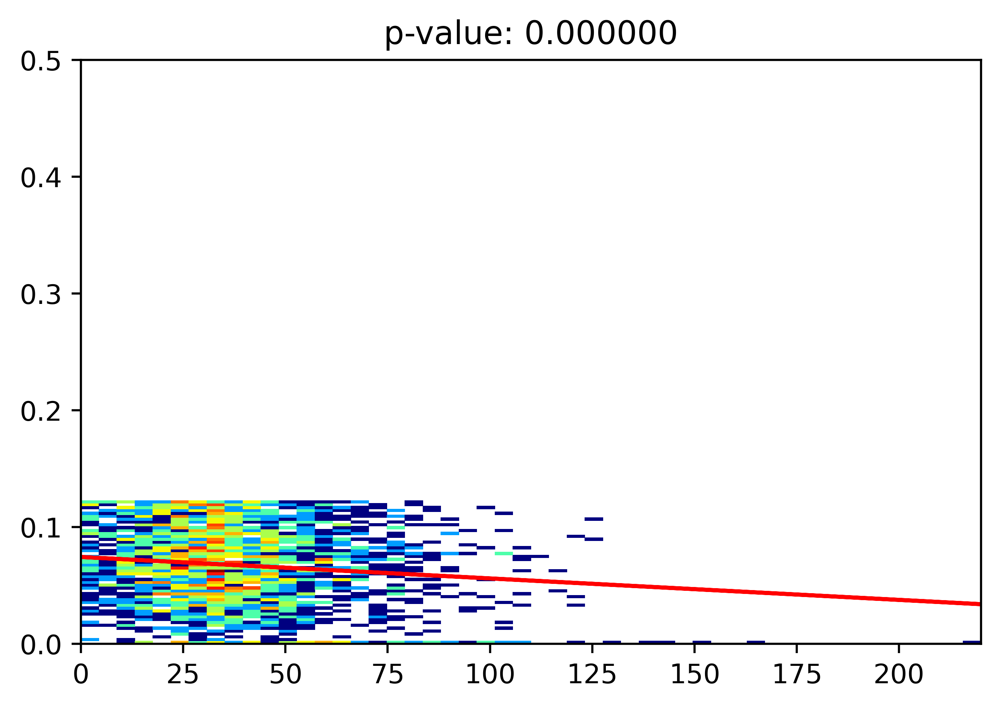

0.12486354158988462
pval 3.680054812090304e-08
rval -0.12169555405652115


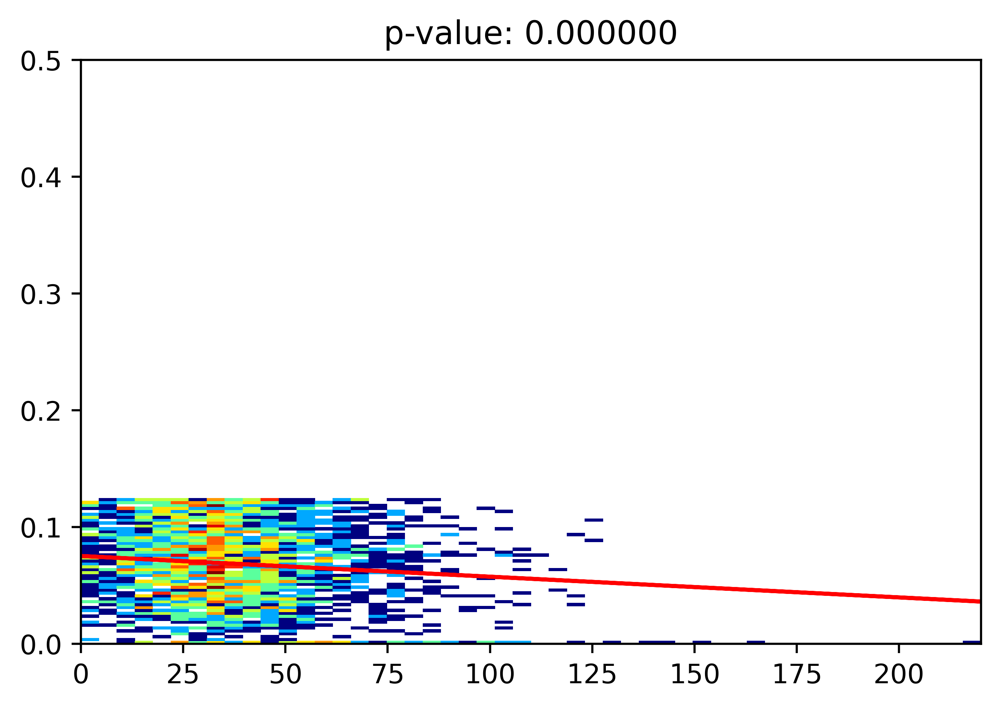

0.1272169863580766
pval 6.132781019059492e-08
rval -0.11858121404768866


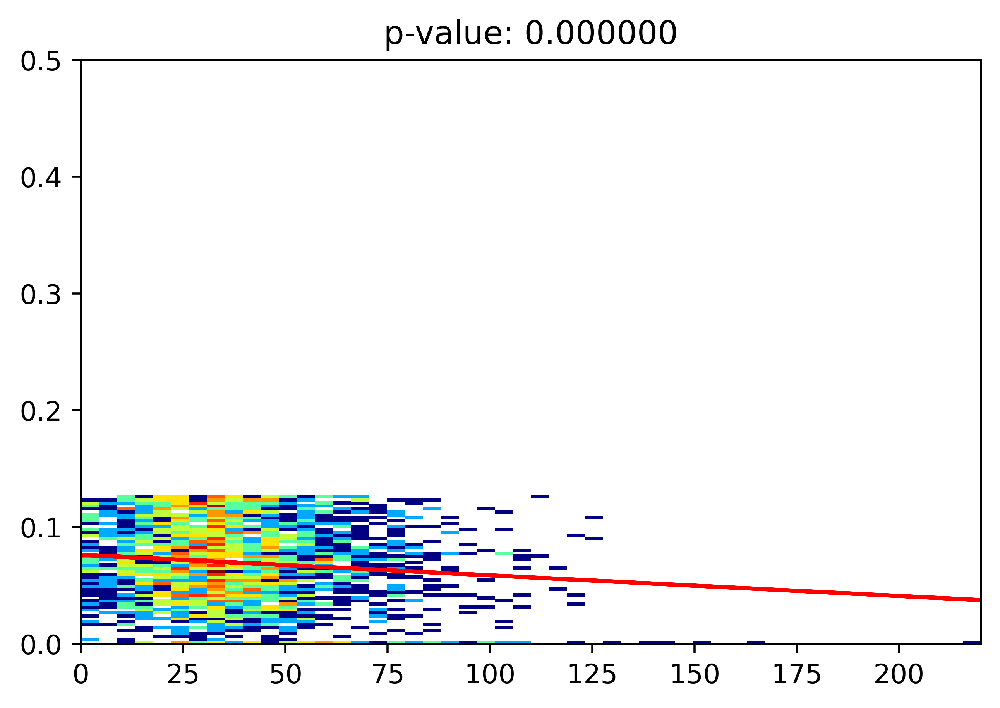

0.13015105173030606
pval 9.262573181868687e-09
rval -0.12456806641977017


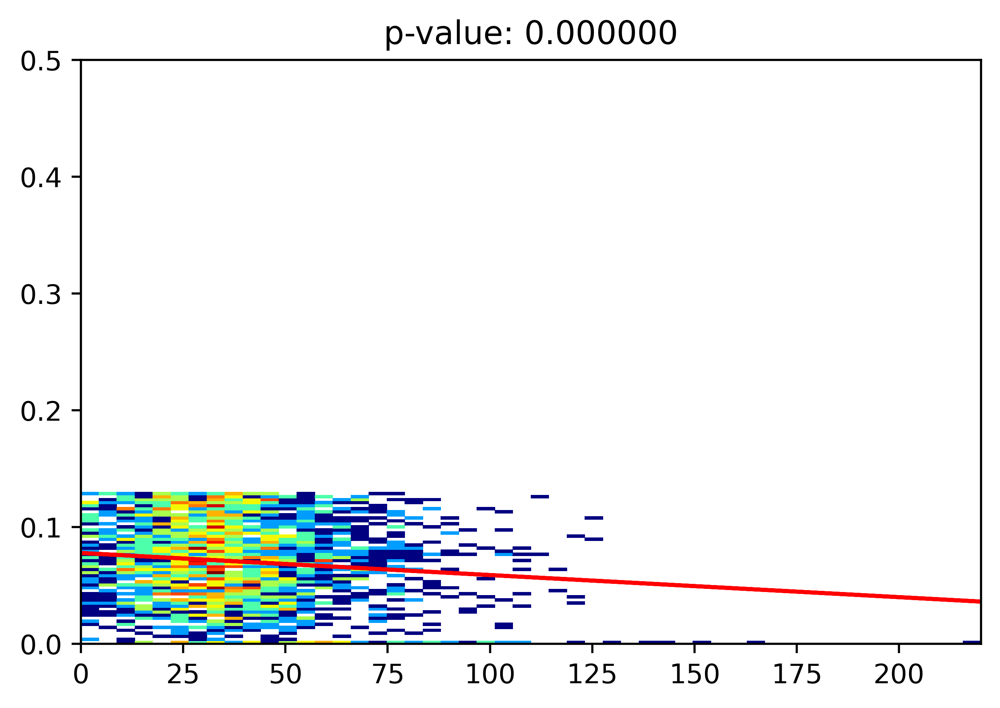

0.13226250695048444
pval 7.223796852557627e-09
rval -0.12430649116712529


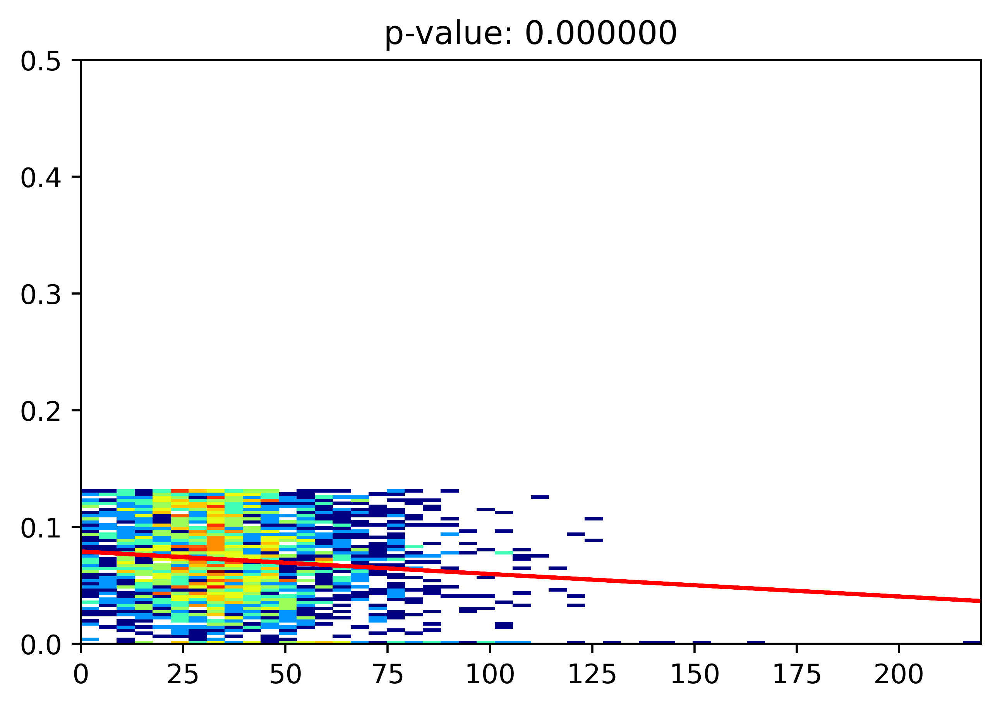

0.13450401222149014
pval 9.845928142439249e-09
rval -0.122097638624269


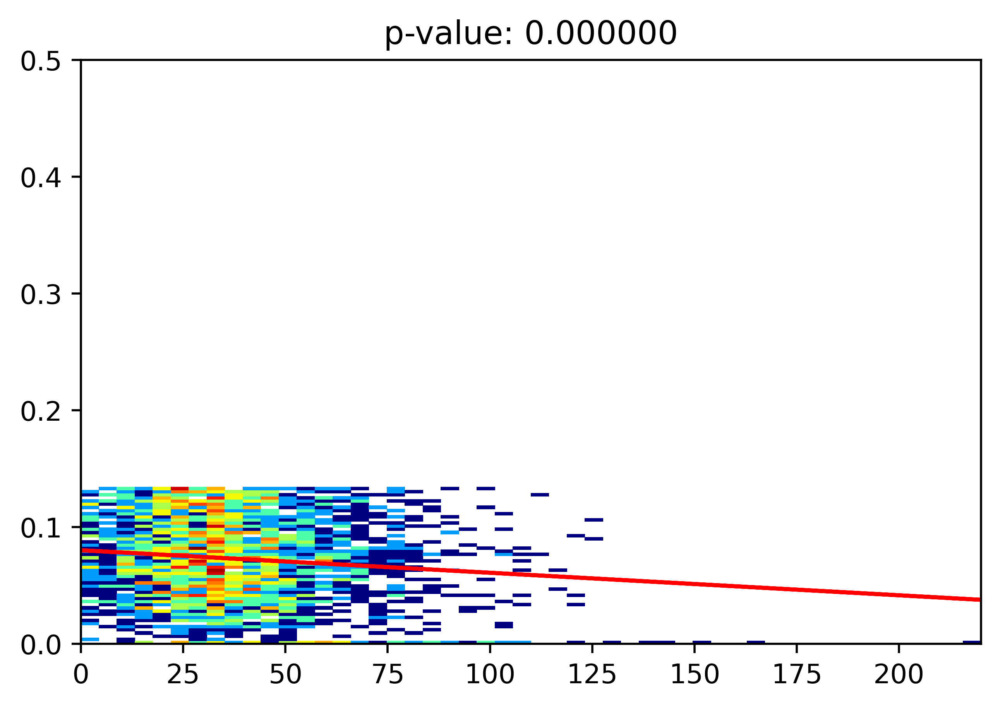

0.13656014274769304
pval 2.840606608031425e-09
rval -0.1253718857570671


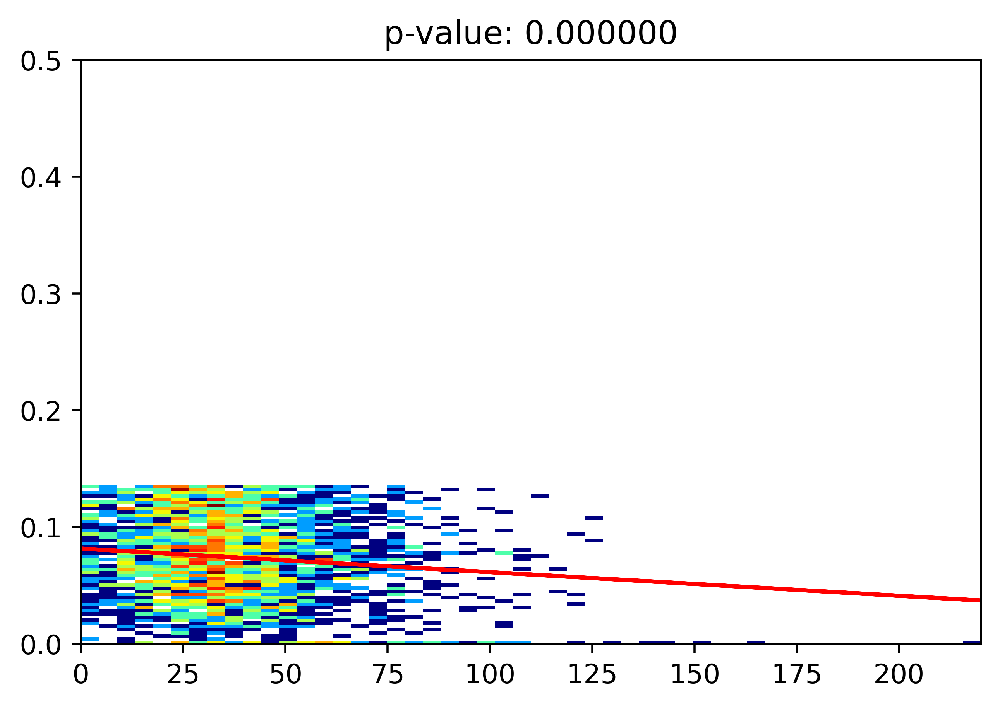

0.1389627304692621
pval 8.98854459790059e-09
rval -0.12031427103251069


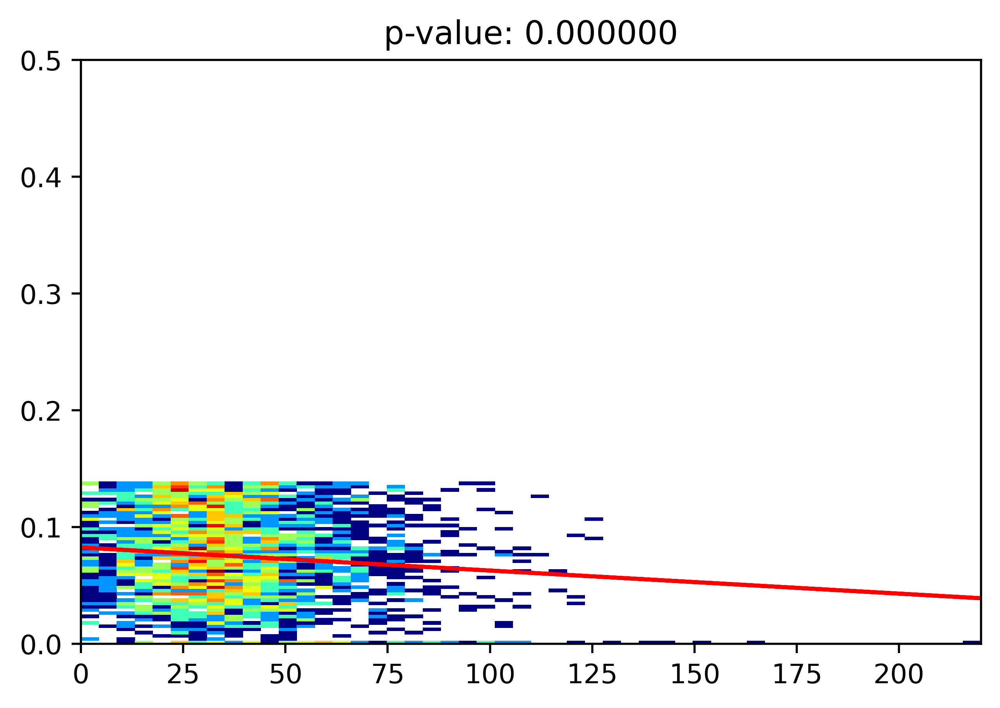

0.142063858839608
pval 3.782435477847767e-09
rval -0.12227915373099159


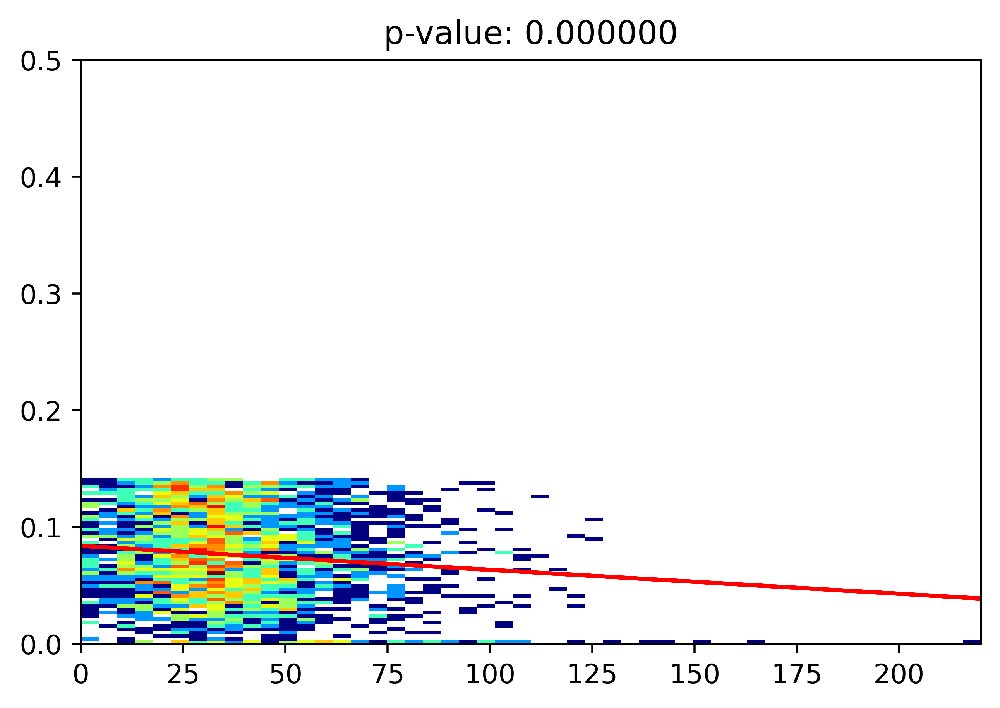

0.14469523171706947
pval 4.743927840999277e-09
rval -0.12049899415122231


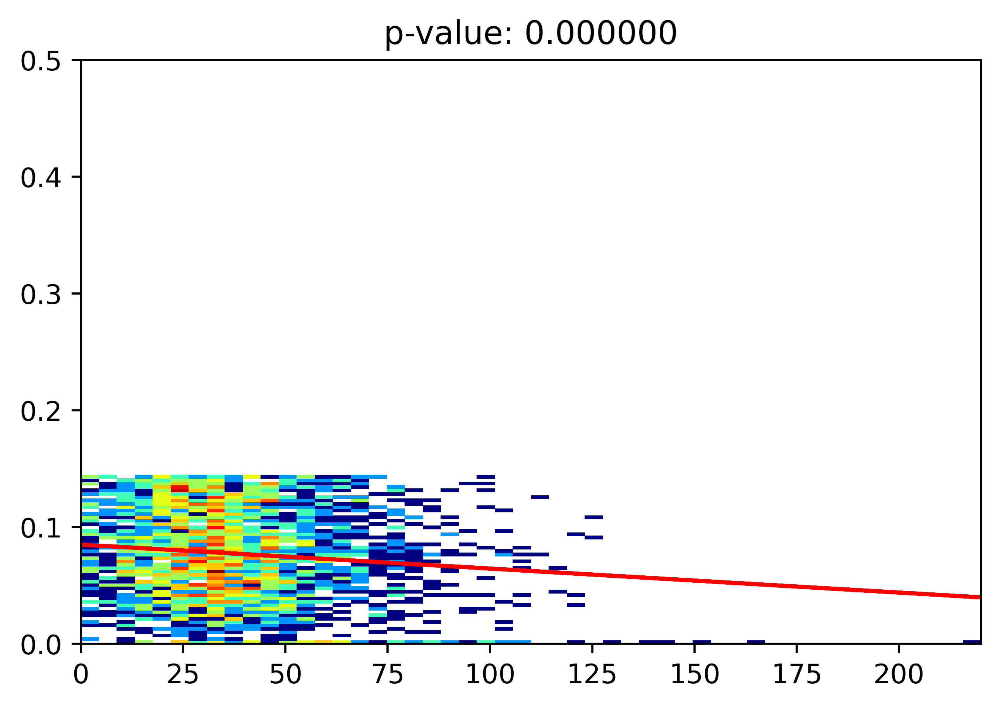

0.14850269563510238
pval 5.3287777878668085e-09
rval -0.11912415338437714


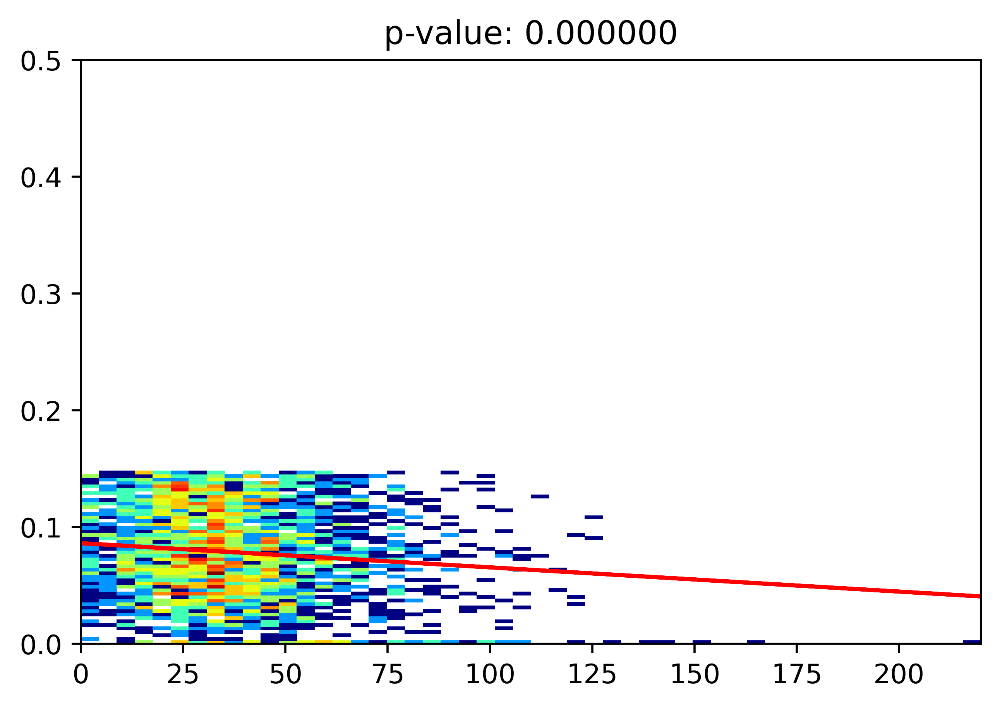

0.15176757292080445
pval 6.433434912757138e-08
rval -0.10951177138034654


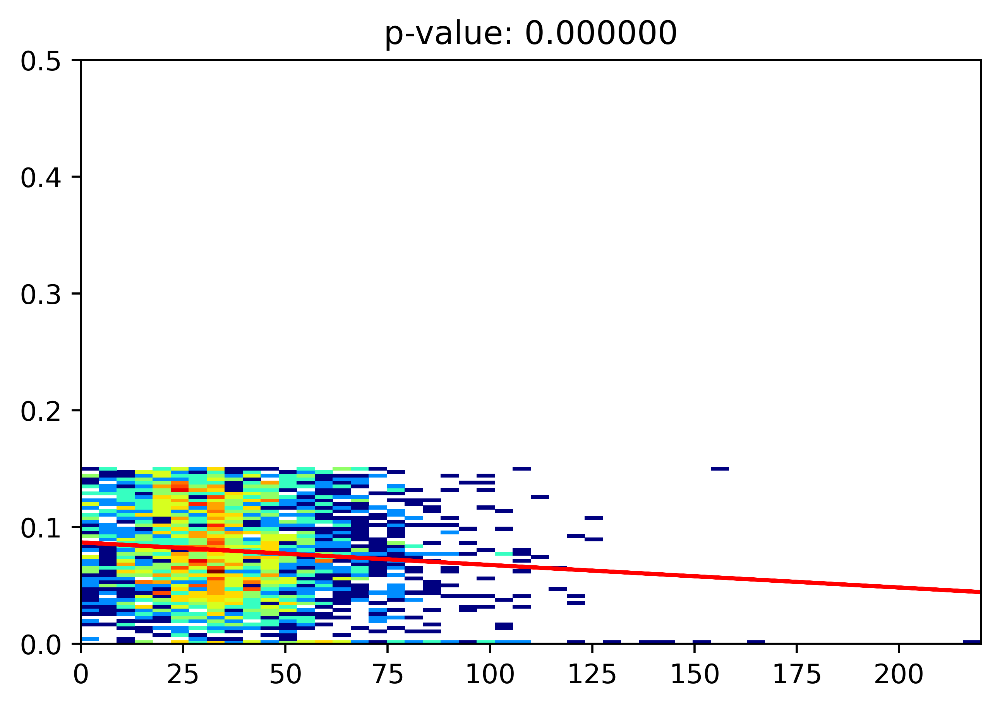

0.15514276476448213
pval 7.903266790998434e-08
rval -0.10790689179503772


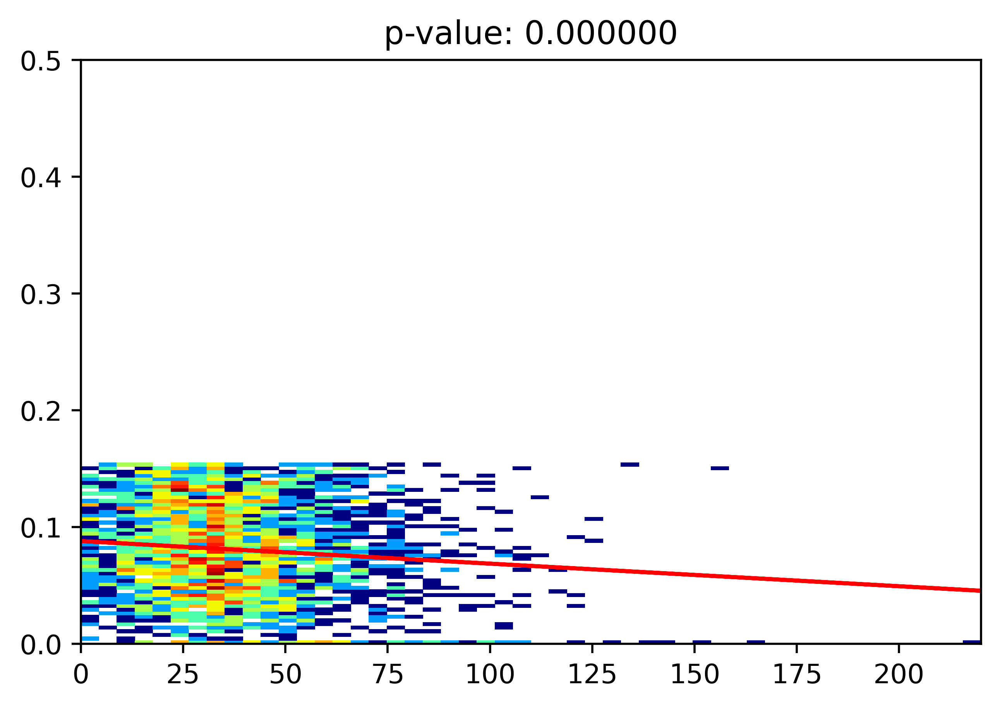

0.15837345654602528
pval 3.58129851979904e-08
rval -0.10984036610907048


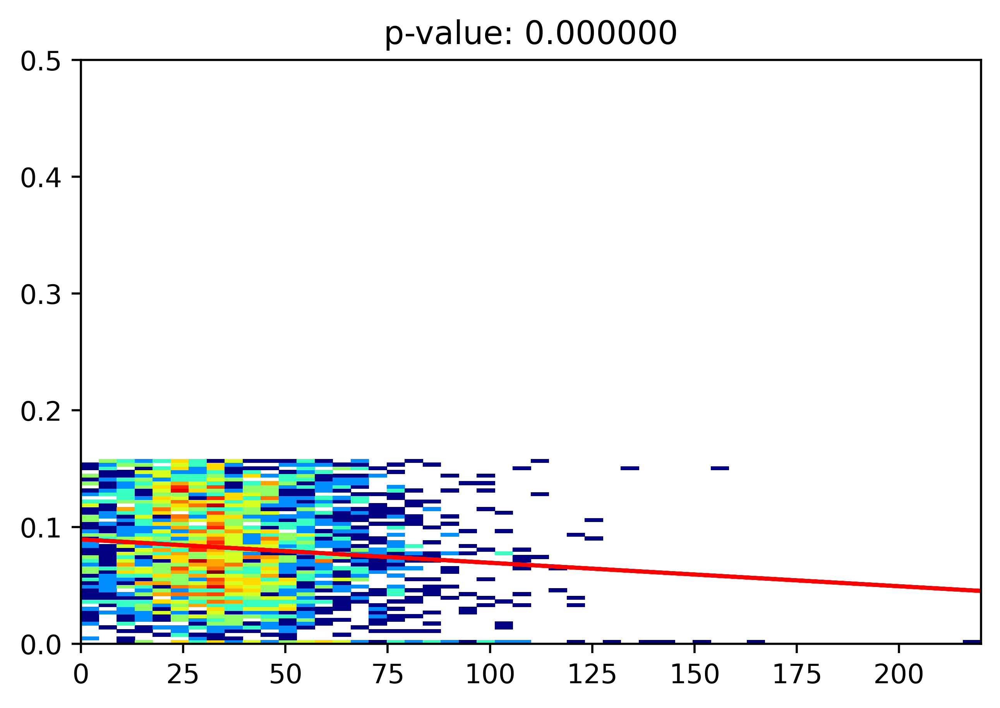

0.16171521905112402
pval 3.519684274906862e-08
rval -0.10905912093540852


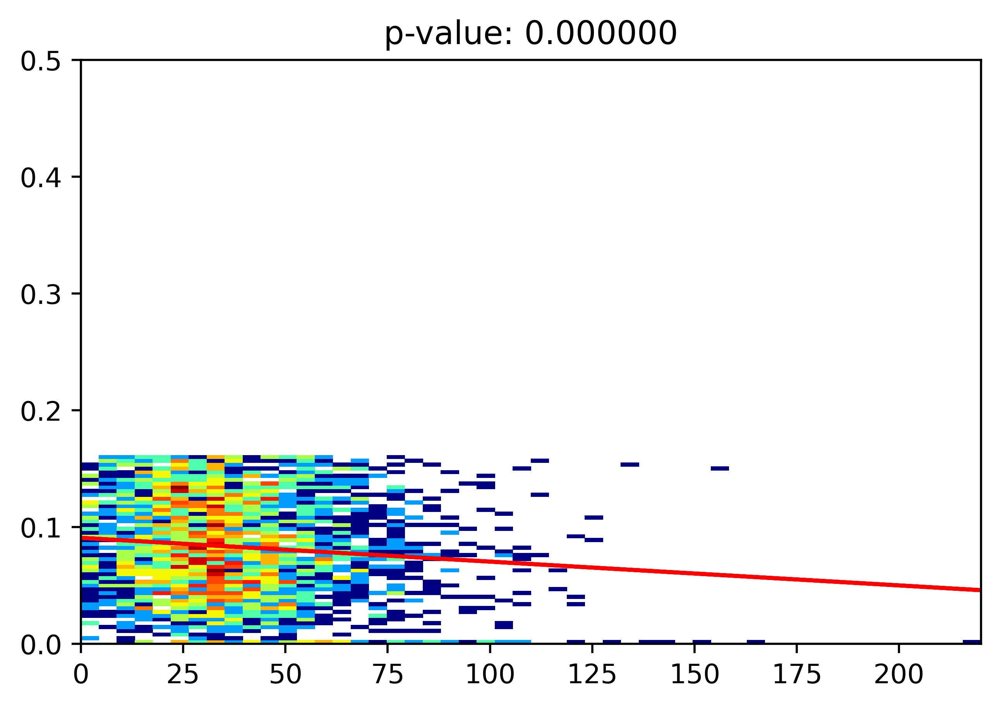

0.16603281308566806
pval 2.2355056886146668e-09
rval -0.11732976265996159


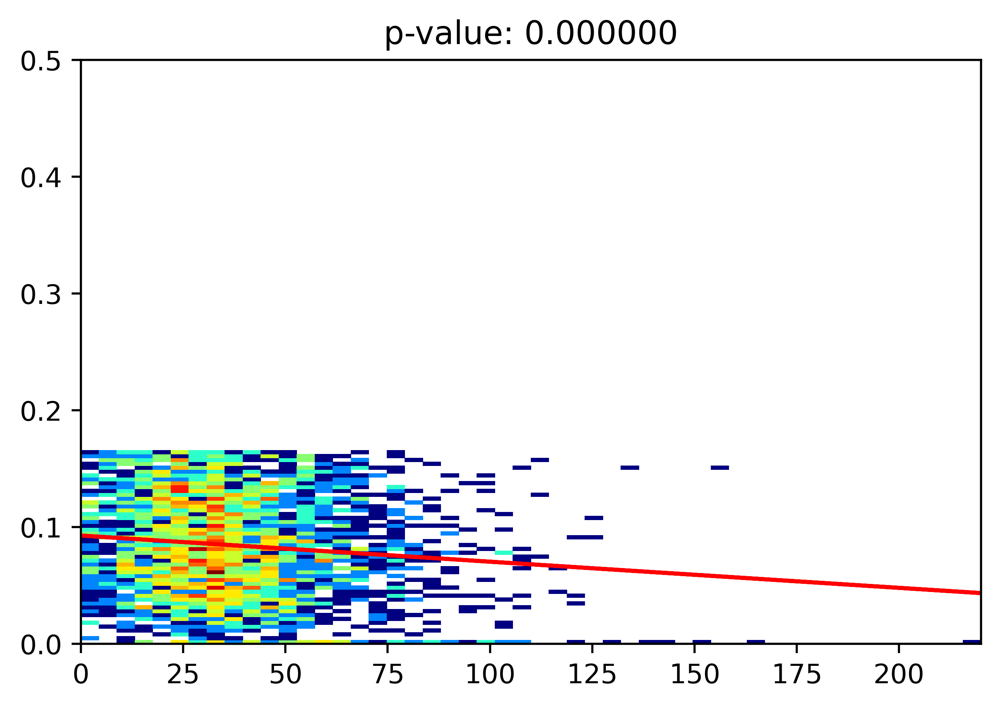

0.16939532422835762
pval 5.6815206800308025e-08
rval -0.10578799277487953


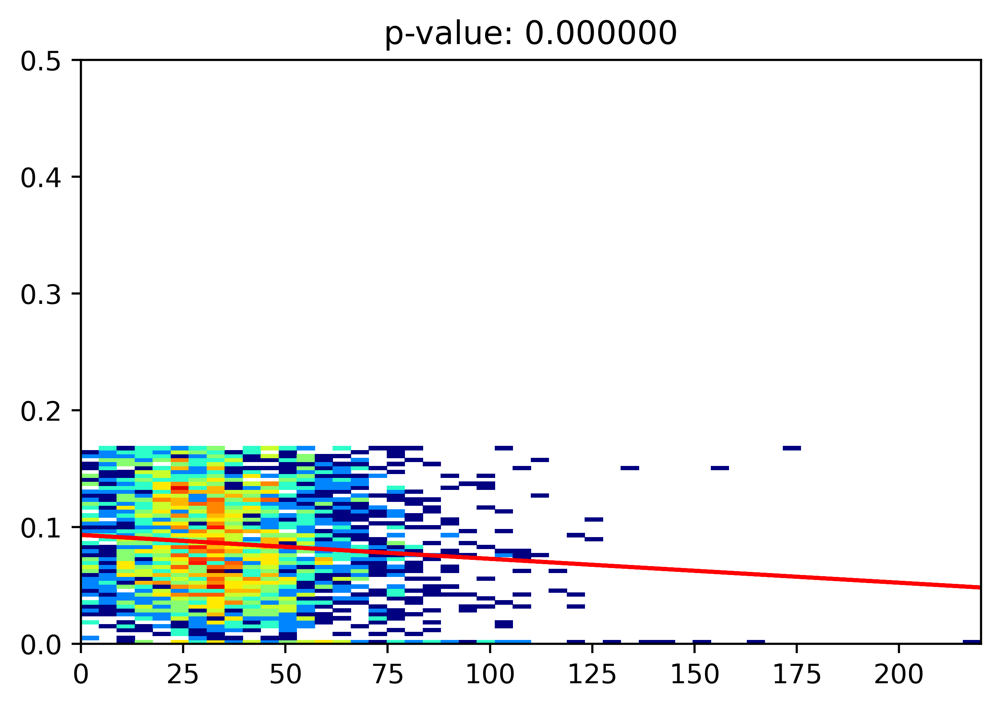

0.17272986856814576
pval 3.44728354636947e-09
rval -0.11424404354756144


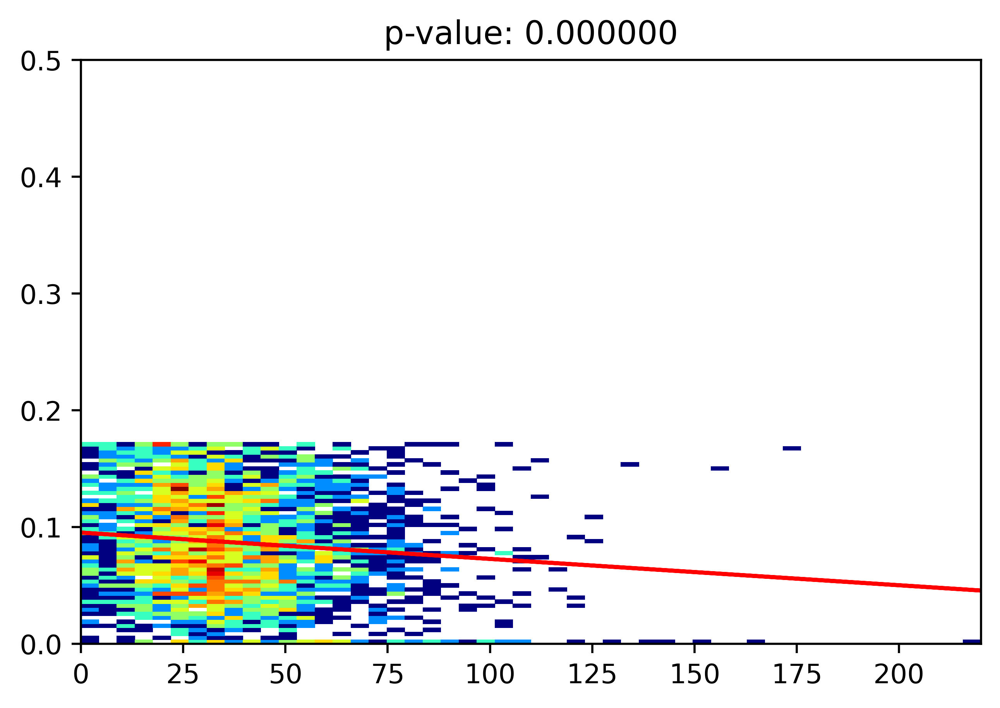

0.17688163659017658
pval 1.8434144271965487e-09
rval -0.11537078016876043


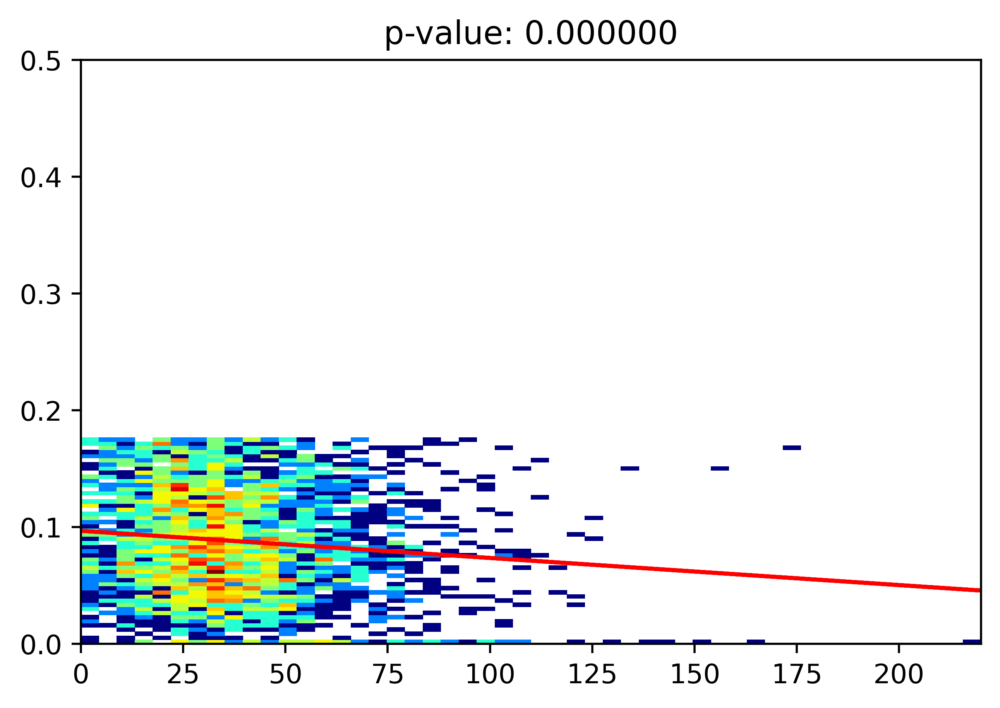

0.18080361148126314
pval 5.708412359327579e-10
rval -0.11809447814392386


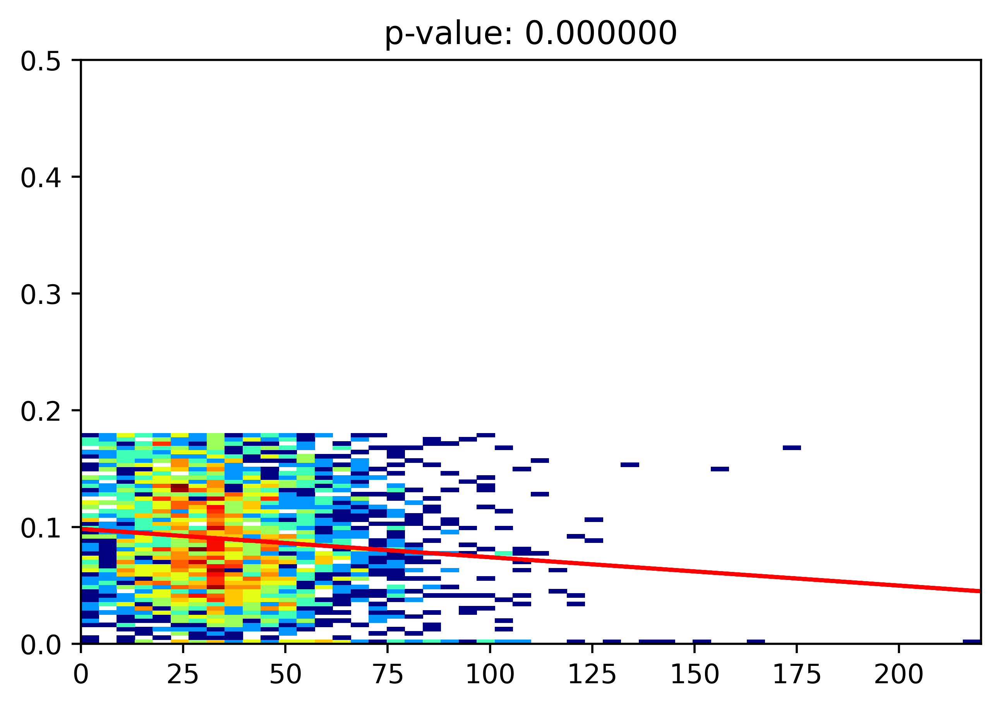

0.18439870015981932
pval 2.67870521894073e-09
rval -0.11260370503134123


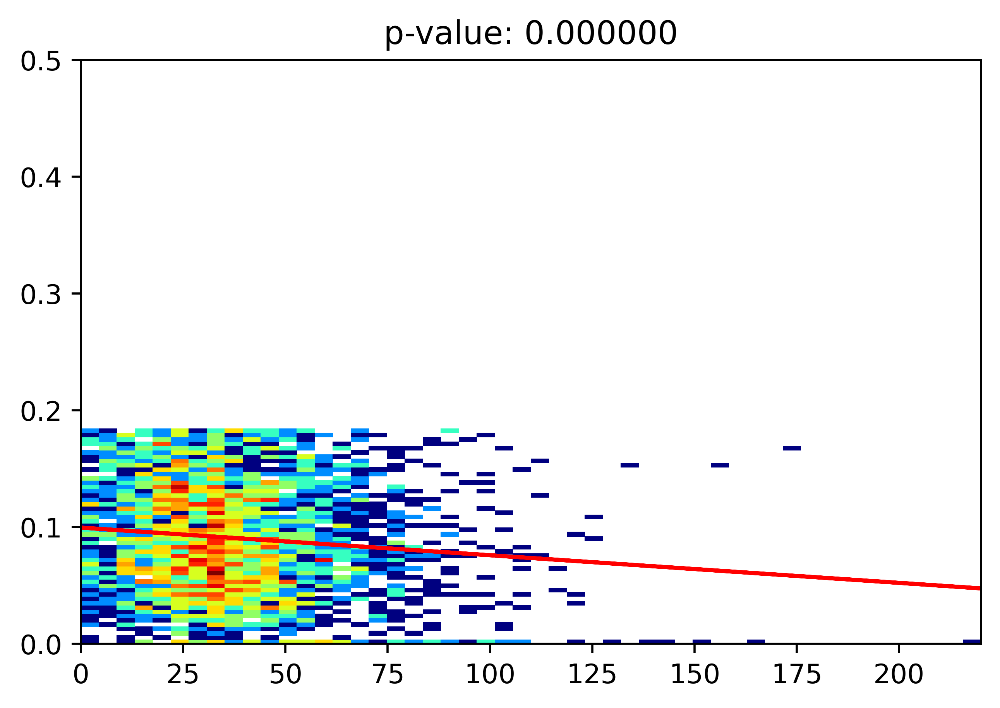

0.18750571367078836
pval 2.273270696686073e-09
rval -0.11232602070649438


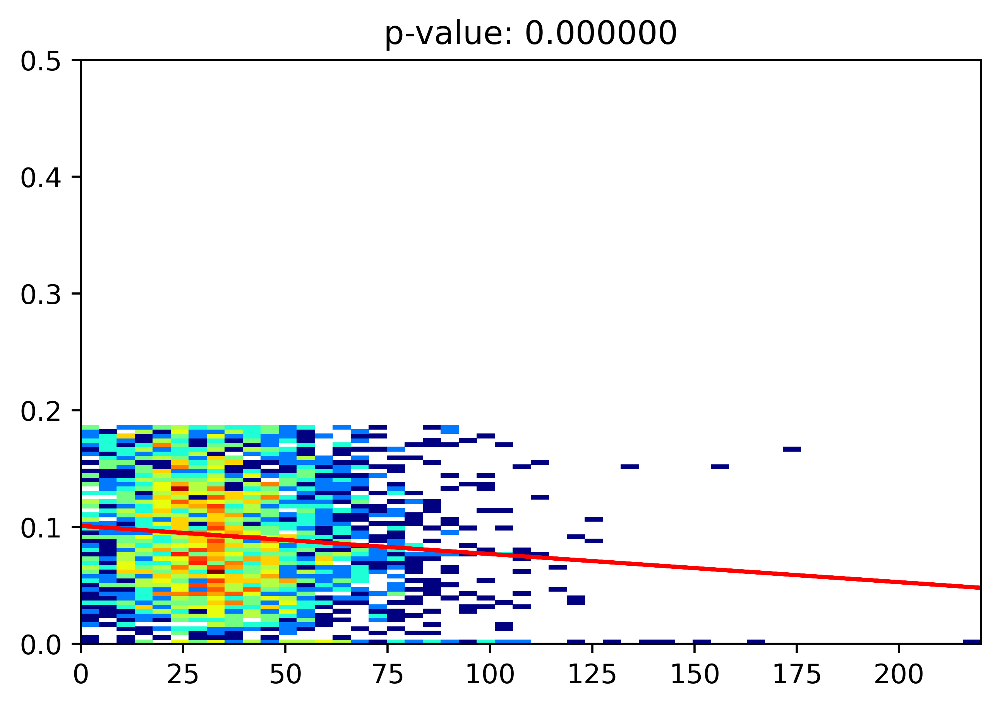

0.1916028932592245
pval 1.4433826556503817e-09
rval -0.11290560815048593


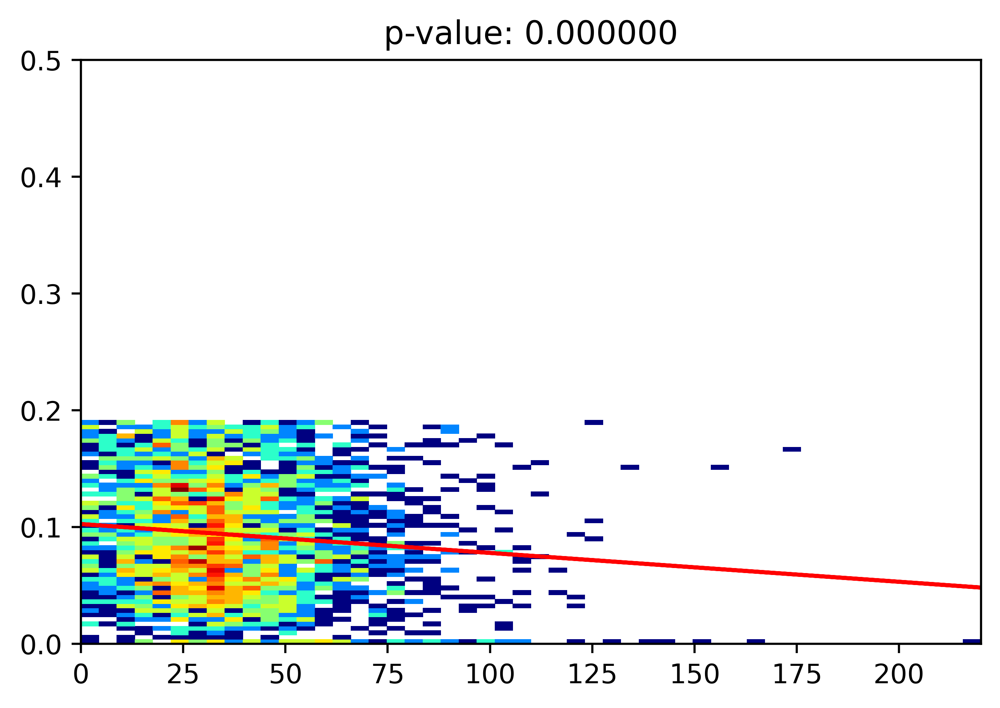

0.19508964436008383
pval 1.208656725421784e-09
rval -0.11267206063564186


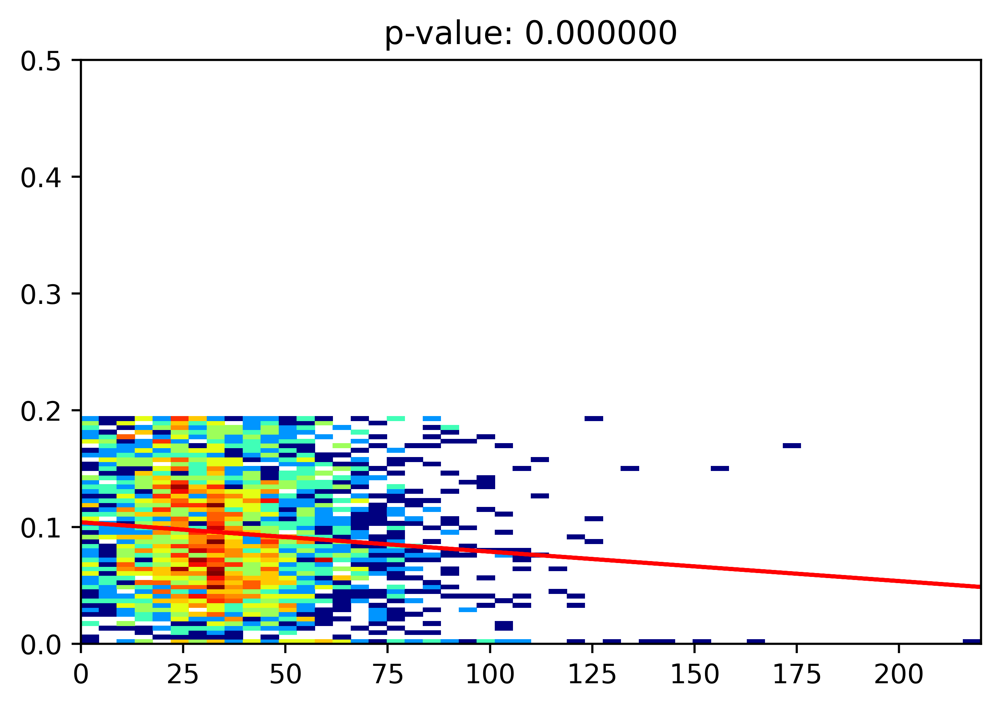

0.1988997644535666
pval 9.355835414210244e-10
rval -0.11267375165310244


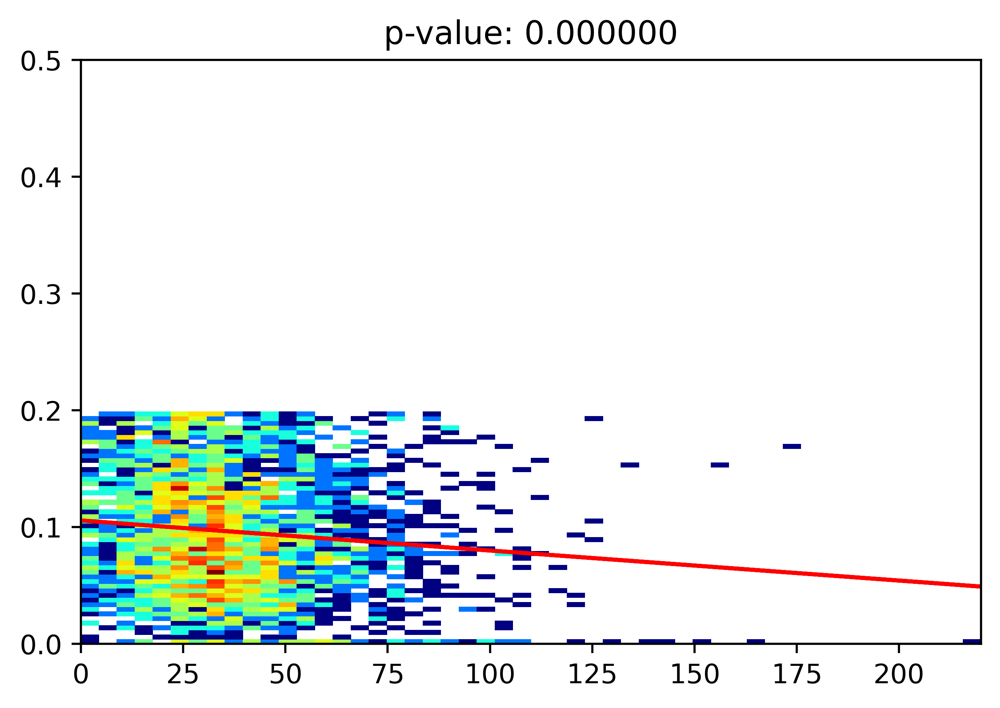

0.2042285296759713
pval 2.977637468349822e-08
rval -0.10143510051967114


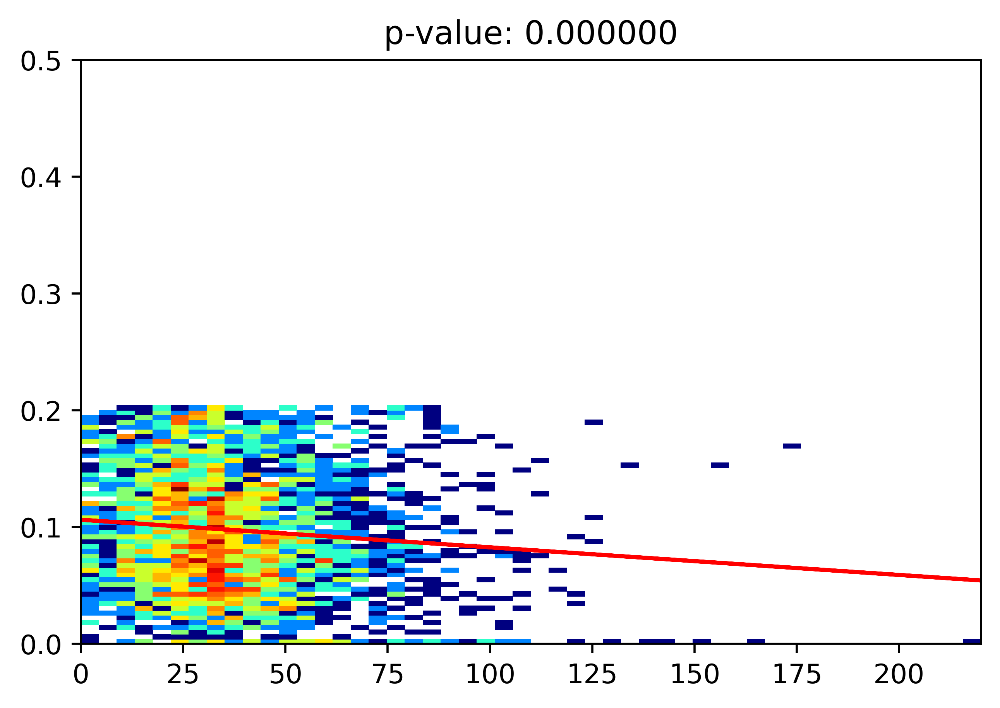

0.21074046693654364
pval 1.3117564654558071e-08
rval -0.10334330297227615


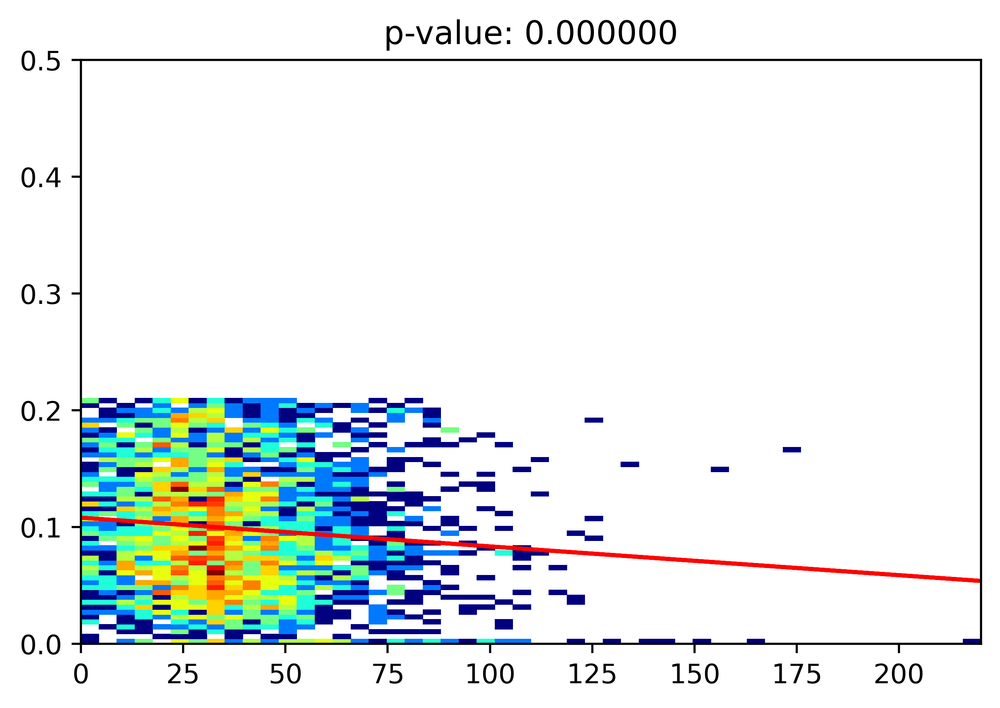

0.21476950894235877
pval 7.368904245467086e-08
rval -0.09724439776776718


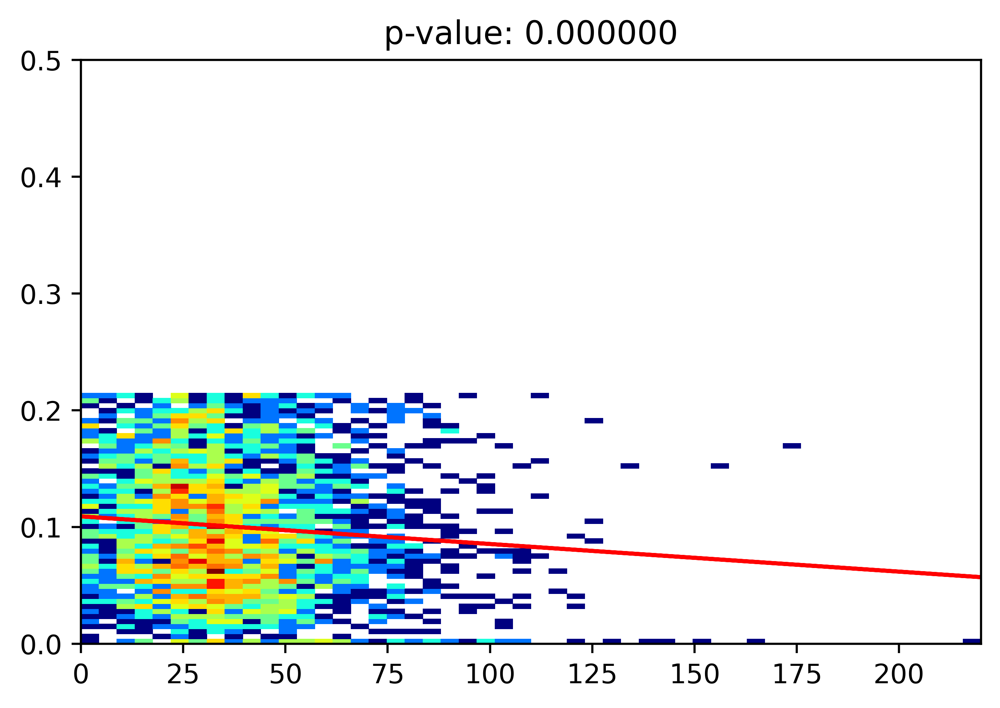

0.21891579356912755
pval 1.8239306904851926e-07
rval -0.09367304541280583


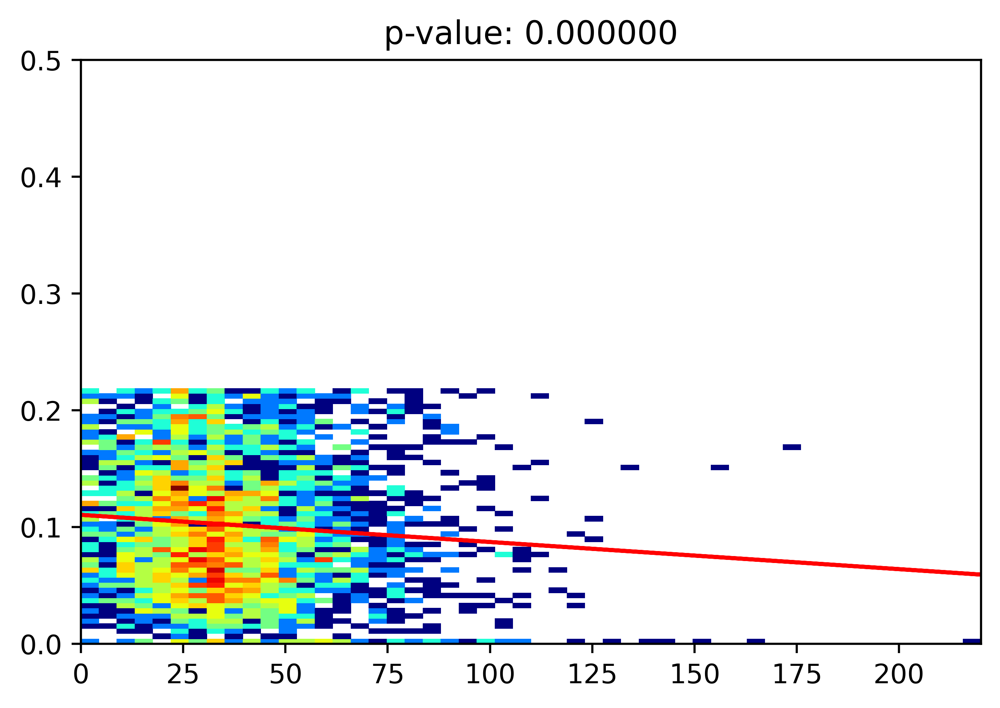

0.224531698011463
pval 2.608055409620932e-06
rval -0.08389874342422847


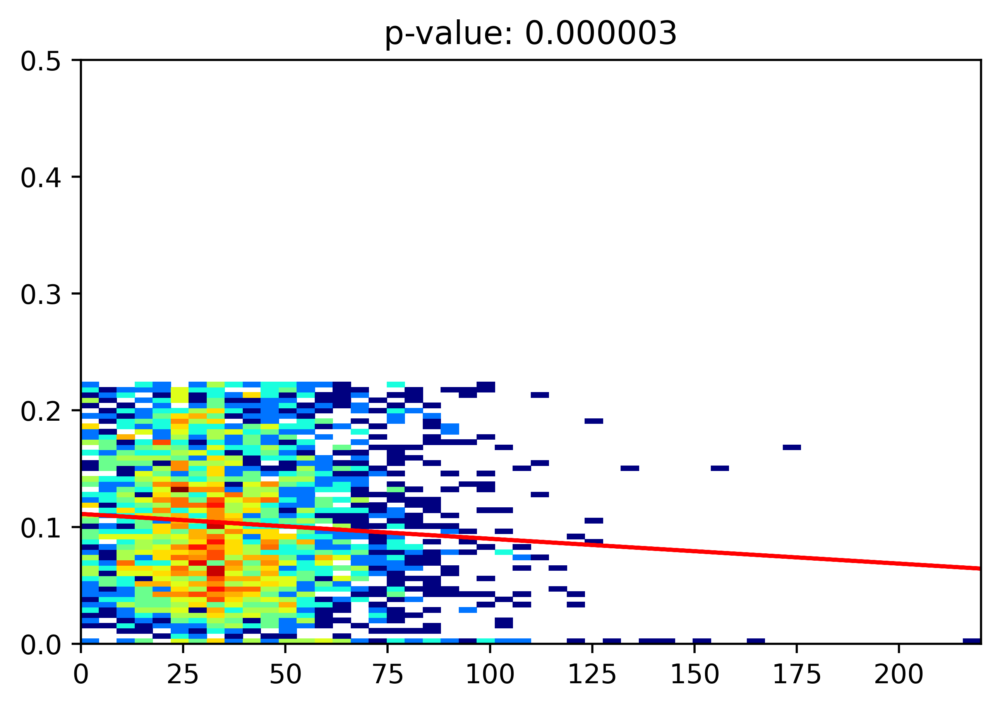

0.23025201104987436
pval 1.3262100917470818e-06
rval -0.08579149672999456


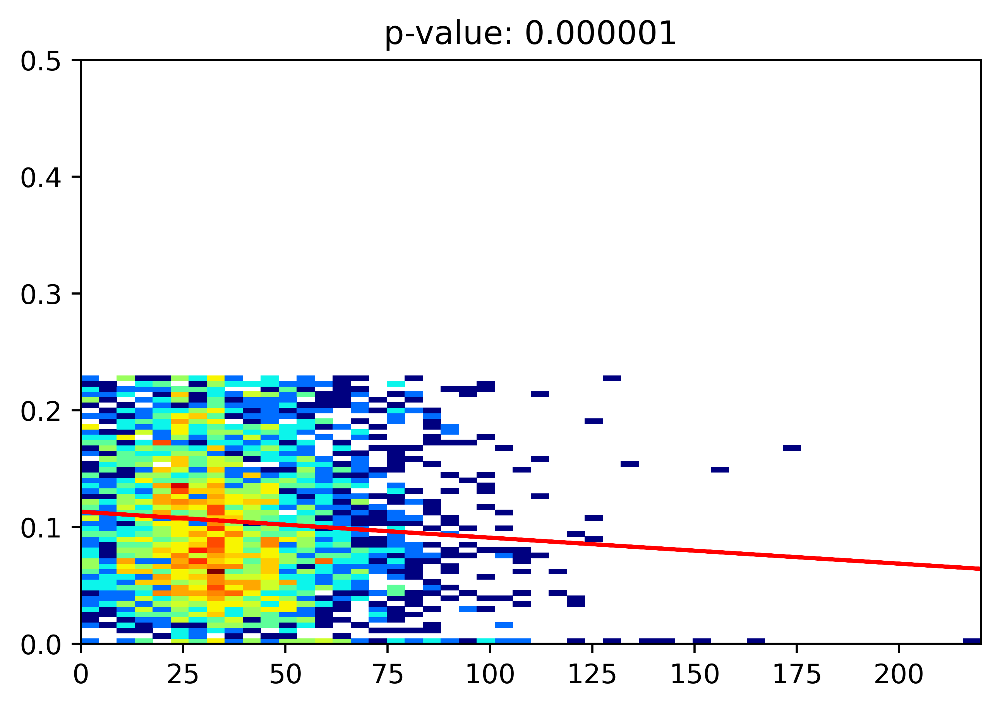

0.2385697522753065
pval 1.856181616582982e-06
rval -0.08407417673430388


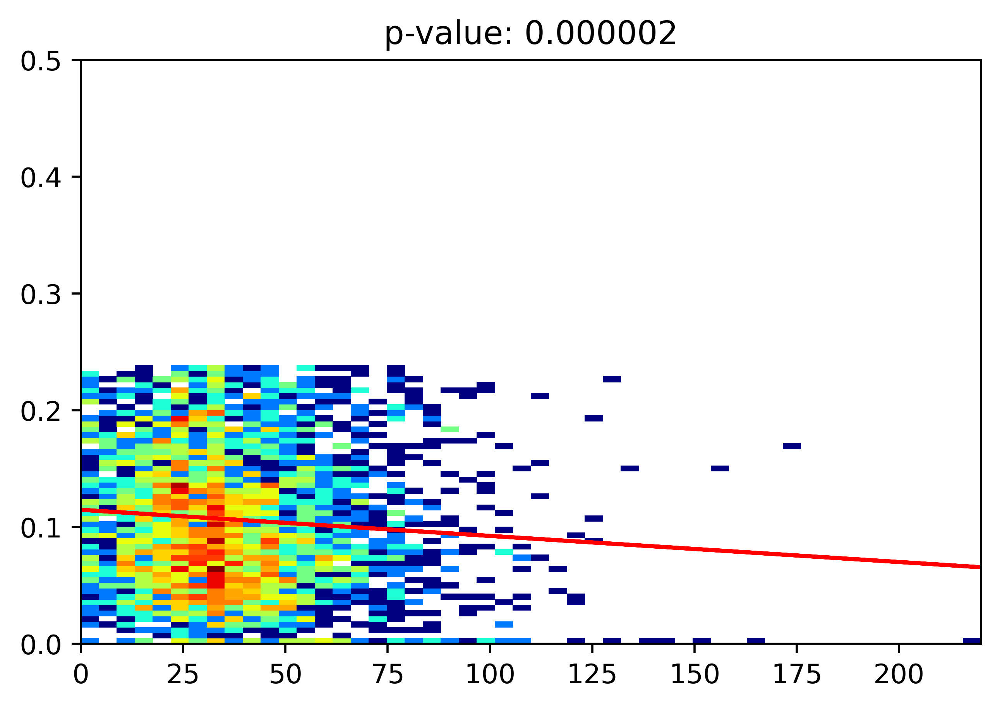

0.24550947788257685
pval 6.684701547017267e-06
rval -0.07893994121168312


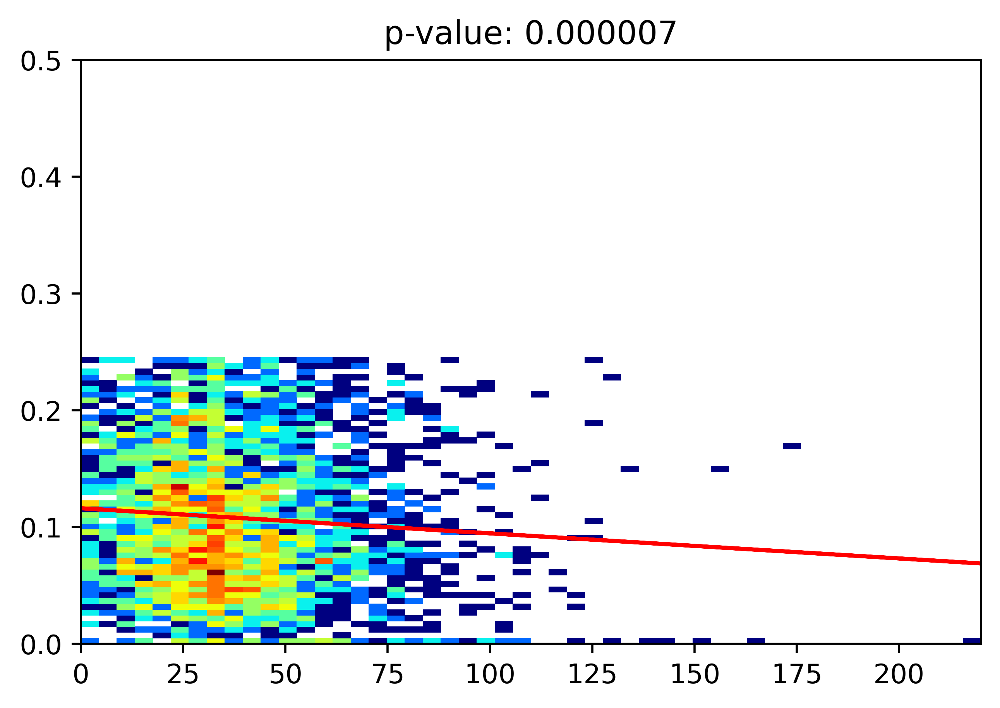

0.2517393454393144
pval 9.964975412960768e-07
rval -0.08522286881463376


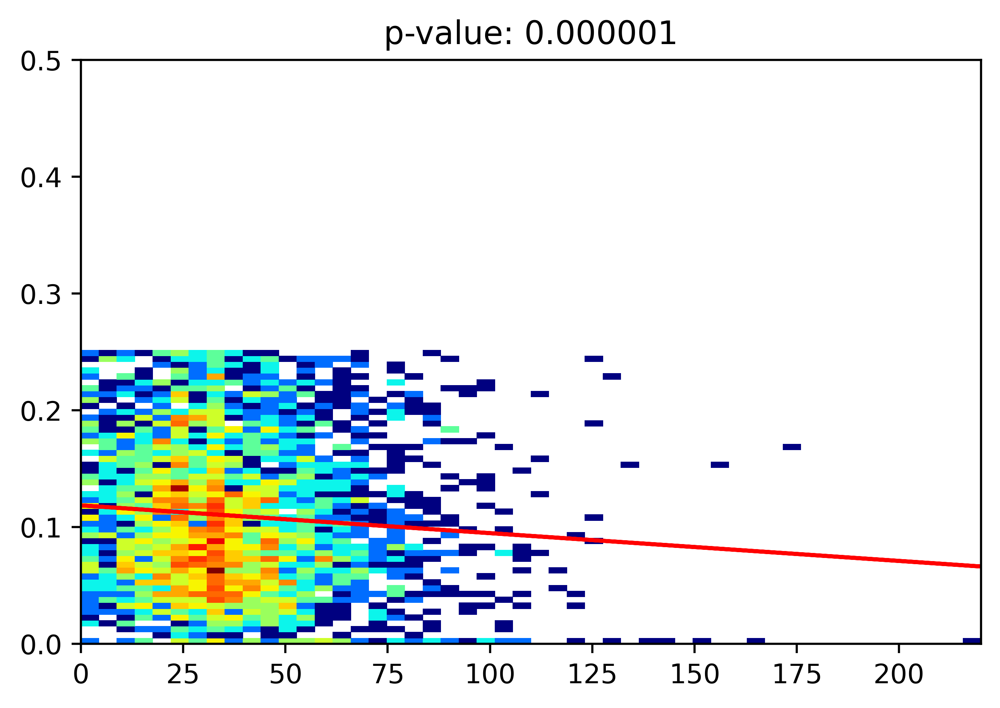

0.2608247538297003
pval 6.487986663249401e-07
rval -0.08616828917047249


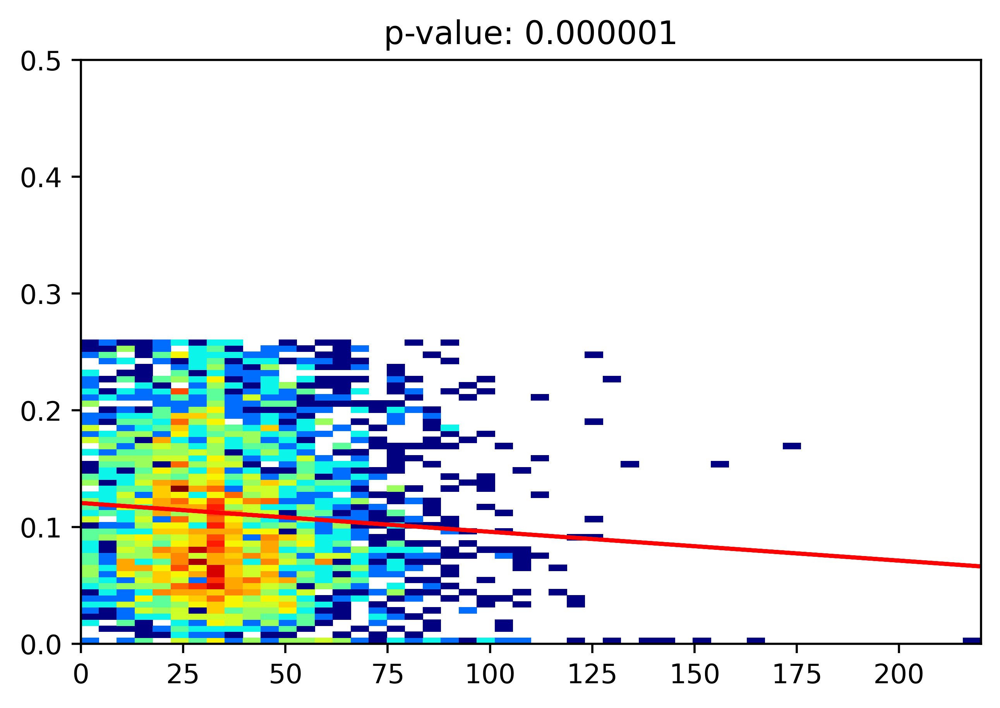

0.26972066655285554
pval 4.580631449313005e-06
rval -0.07892556049066597


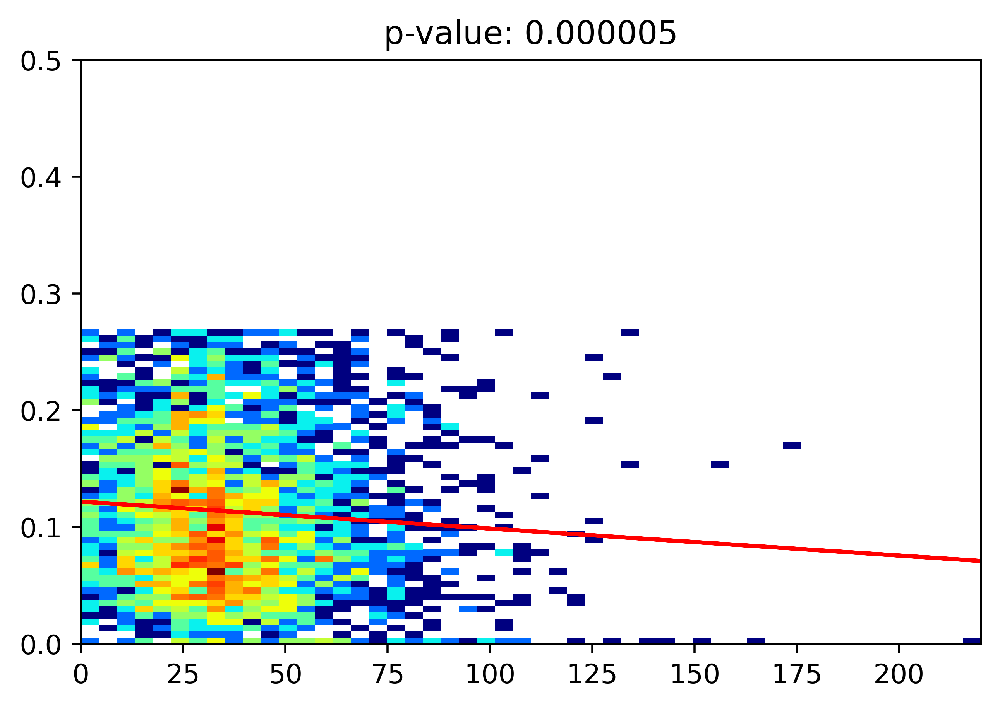

0.2795904764973073
pval 6.808184358149217e-06
rval -0.0770470935455566


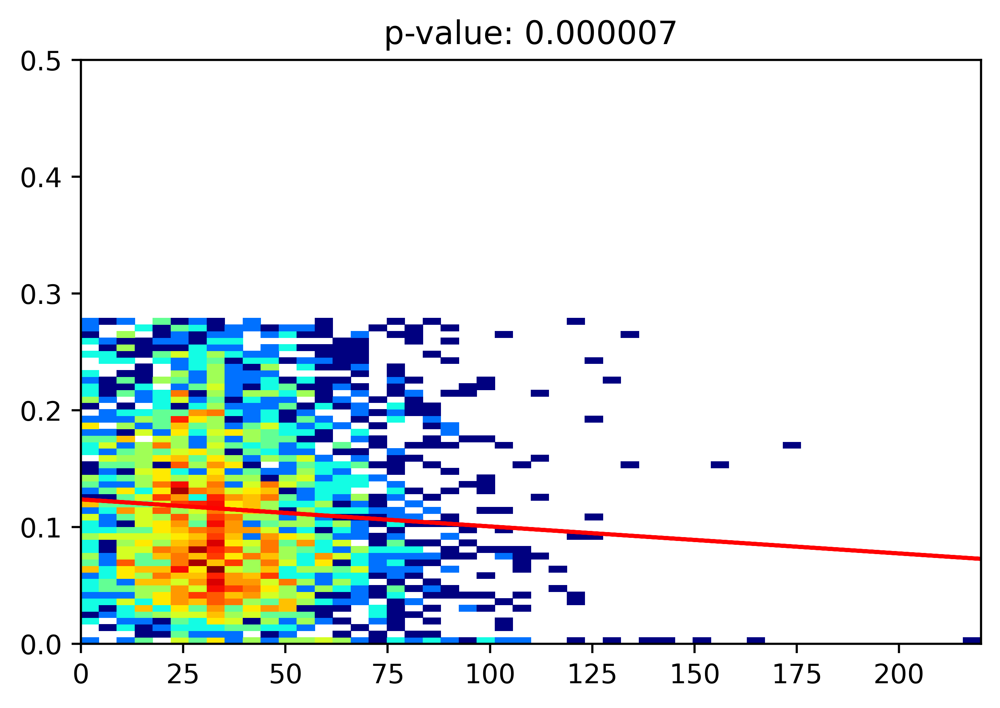

0.29092769309513655
pval 8.103080603904494e-06
rval -0.07597953458012263


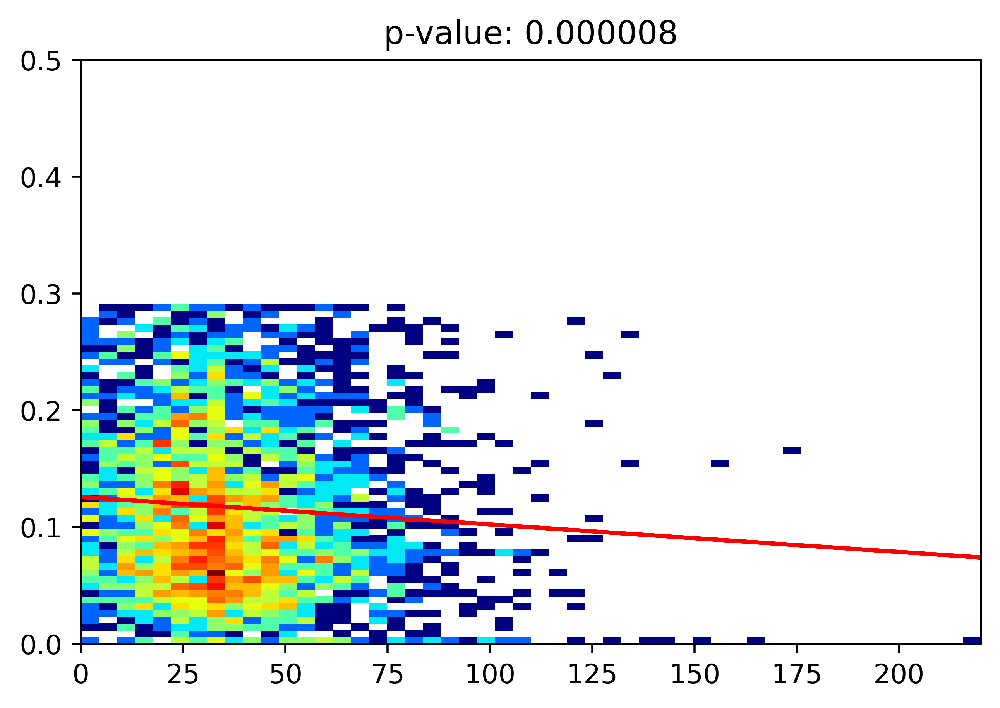

0.30491322335906634
pval 1.6281234300716587e-05
rval -0.07298976538859091


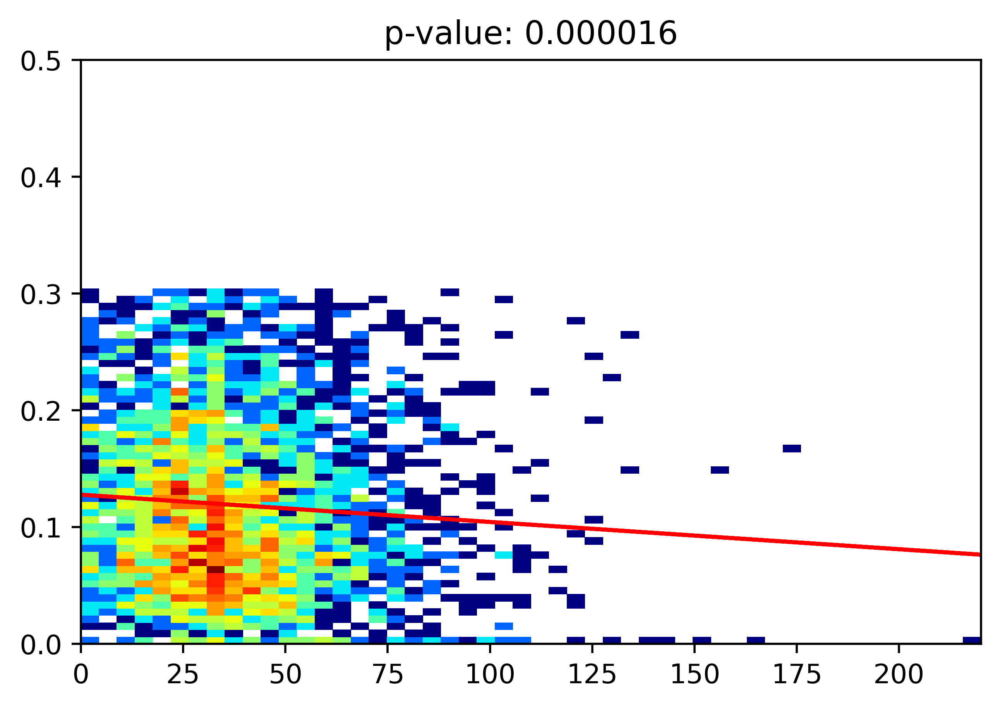

0.3190089761054872
pval 1.1399885134906837e-05
rval -0.07389762693234209


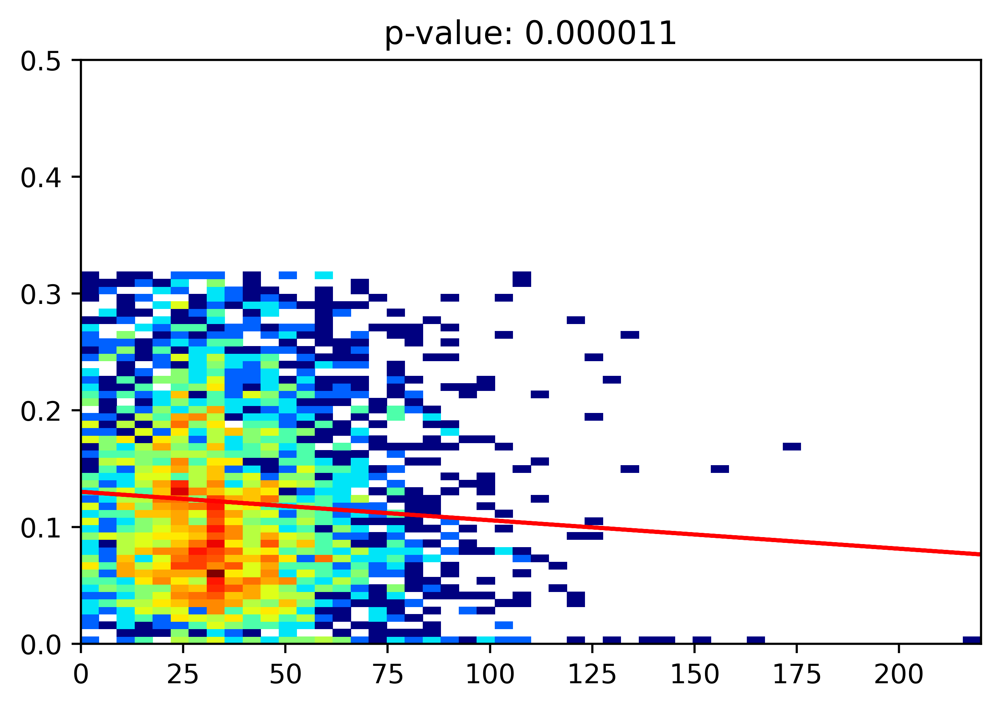

0.3348174920584364
pval 2.4536254251168587e-06
rval -0.07887703262169343


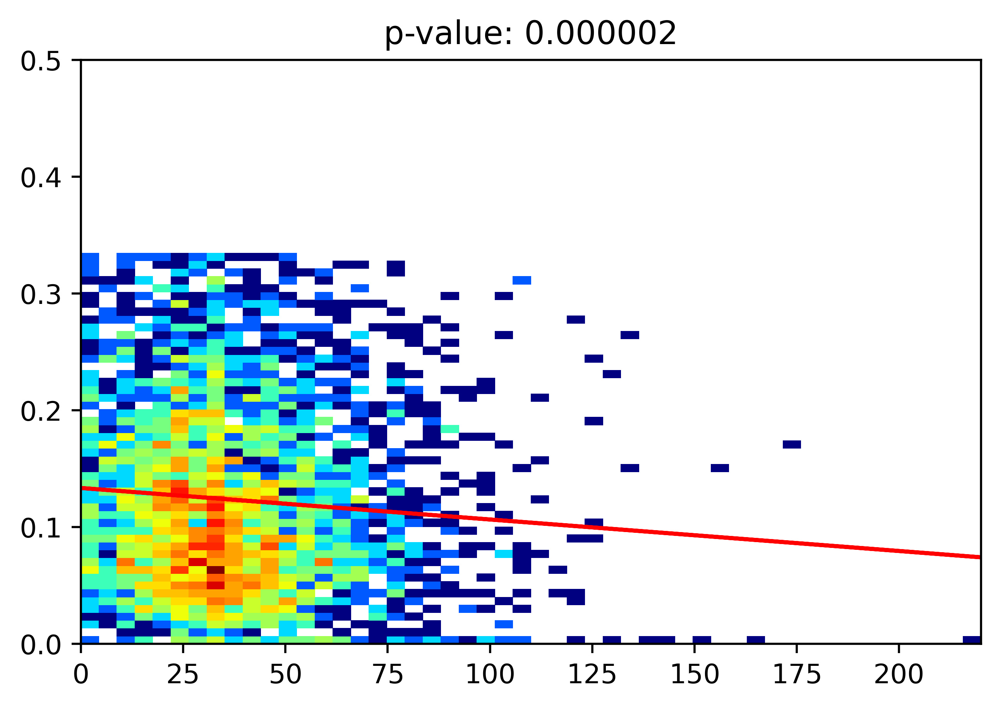

0.3551503014645181
pval 1.9892854372442785e-06
rval -0.07915596050889928


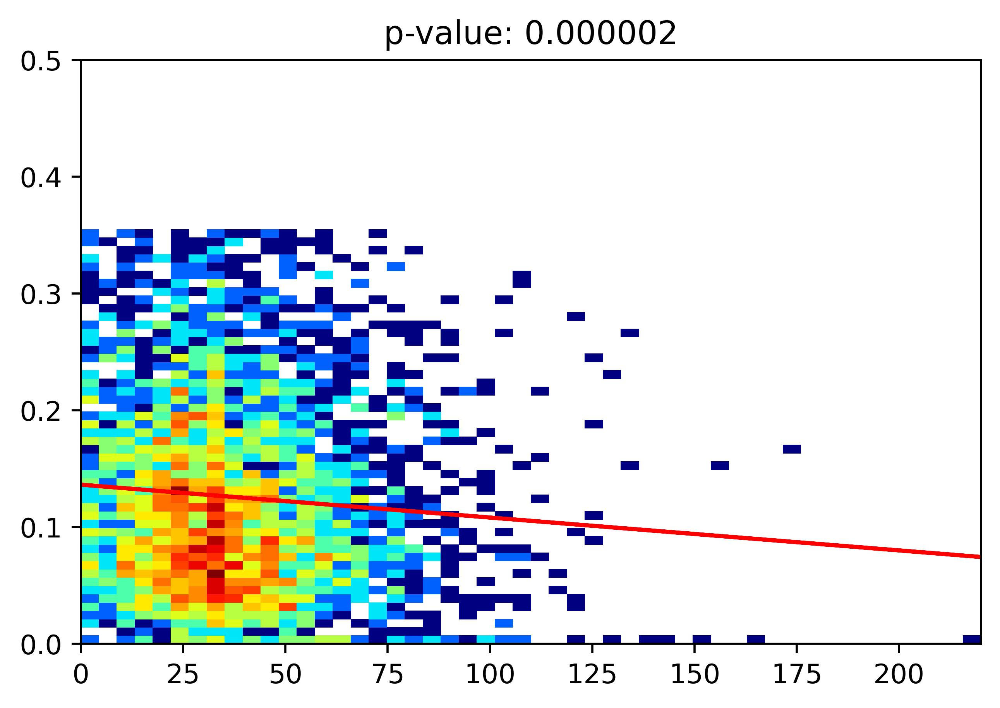

0.38094021975832043
pval 6.038997368149317e-07
rval -0.08261754305082436


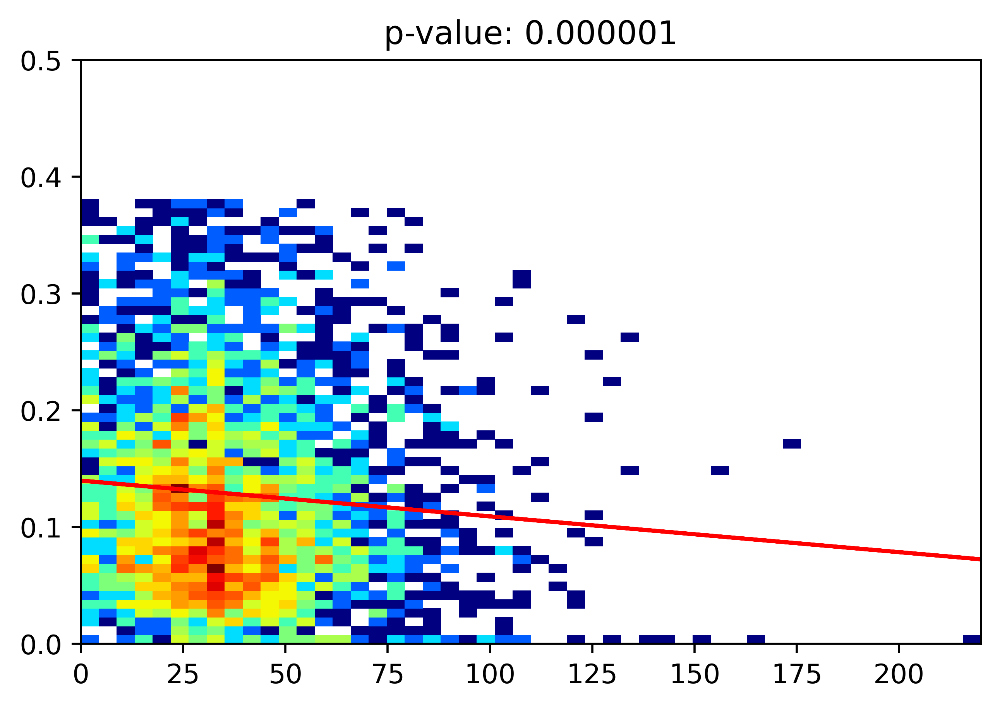

0.4111834475409704
pval 7.352118858722447e-07
rval -0.08155336866130776


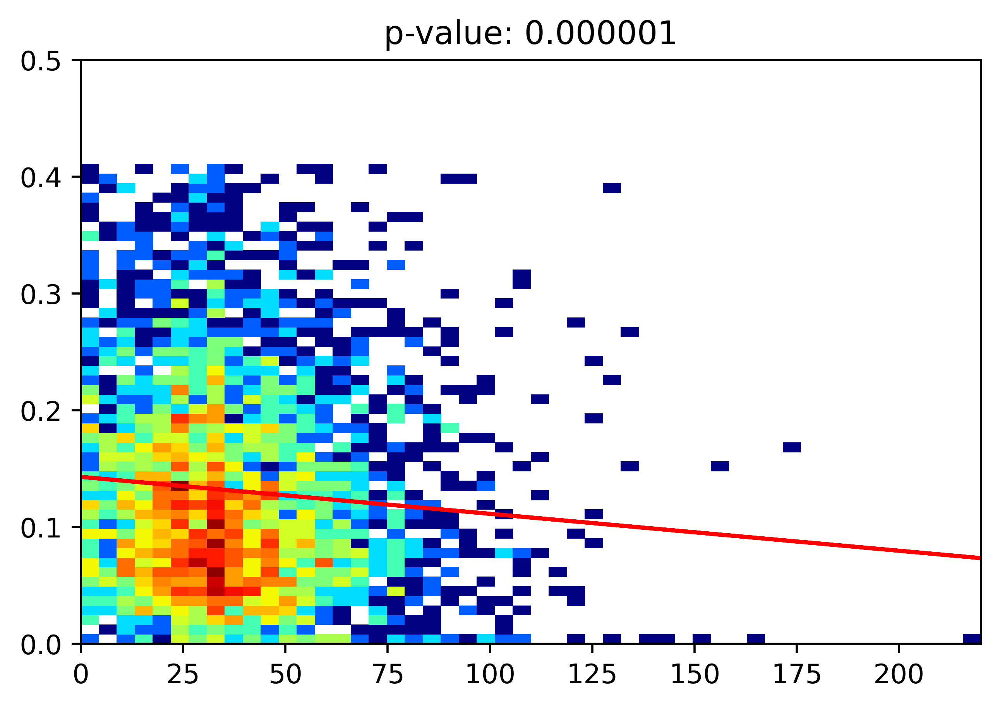

0.44834236980217684
pval 3.2668866716356466e-07
rval -0.08366477209434398


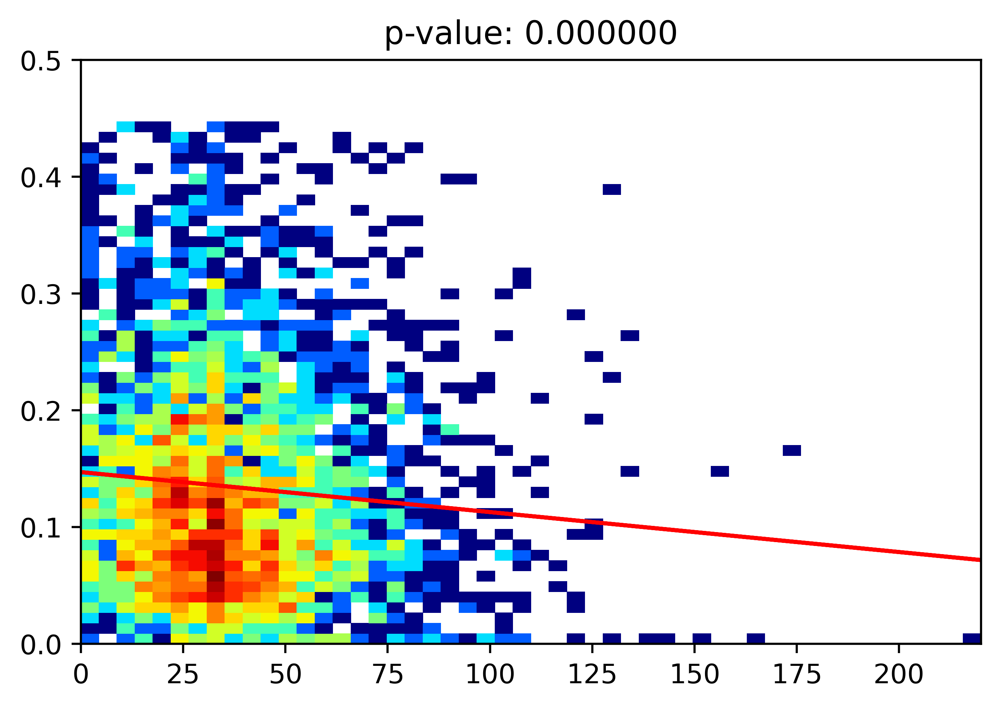

0.508140015673943
pval 2.89966781235928e-08
rval -0.09037295491463924


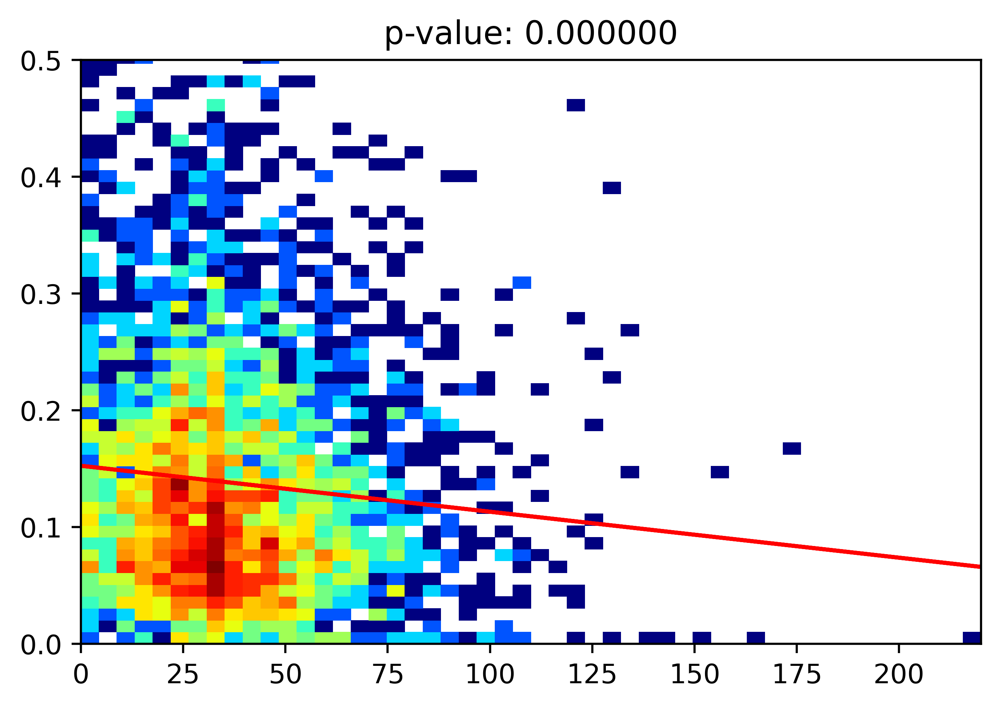

0.582539560371922
pval 2.565486262679688e-07
rval -0.08353771256967482


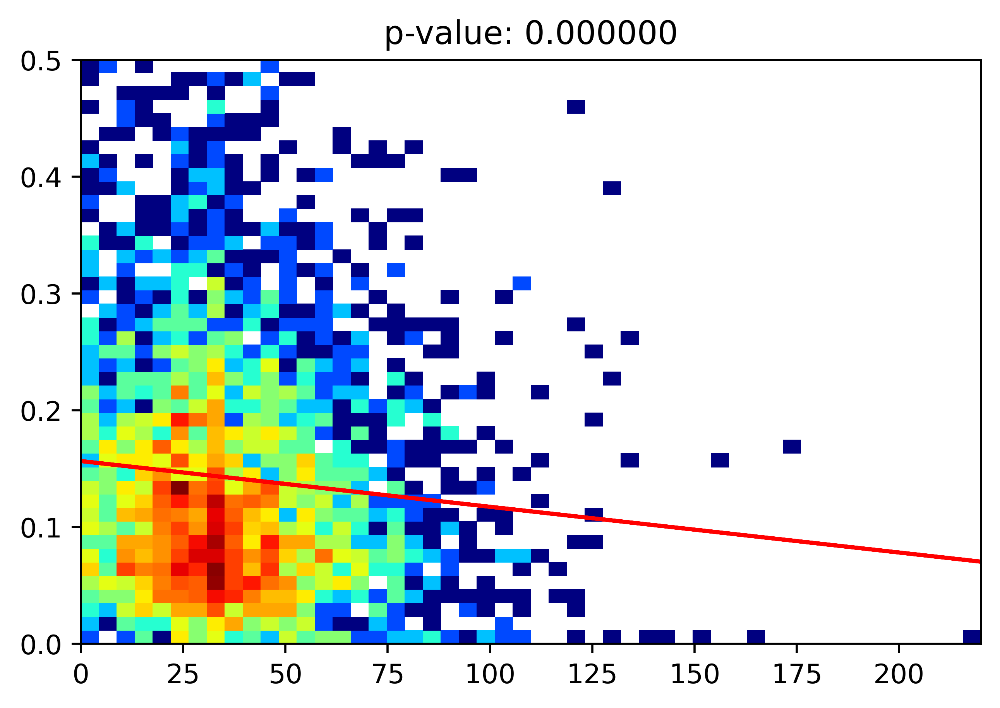

0.6719065078209356
pval 3.4500878762064445e-08
rval -0.08896232885829072


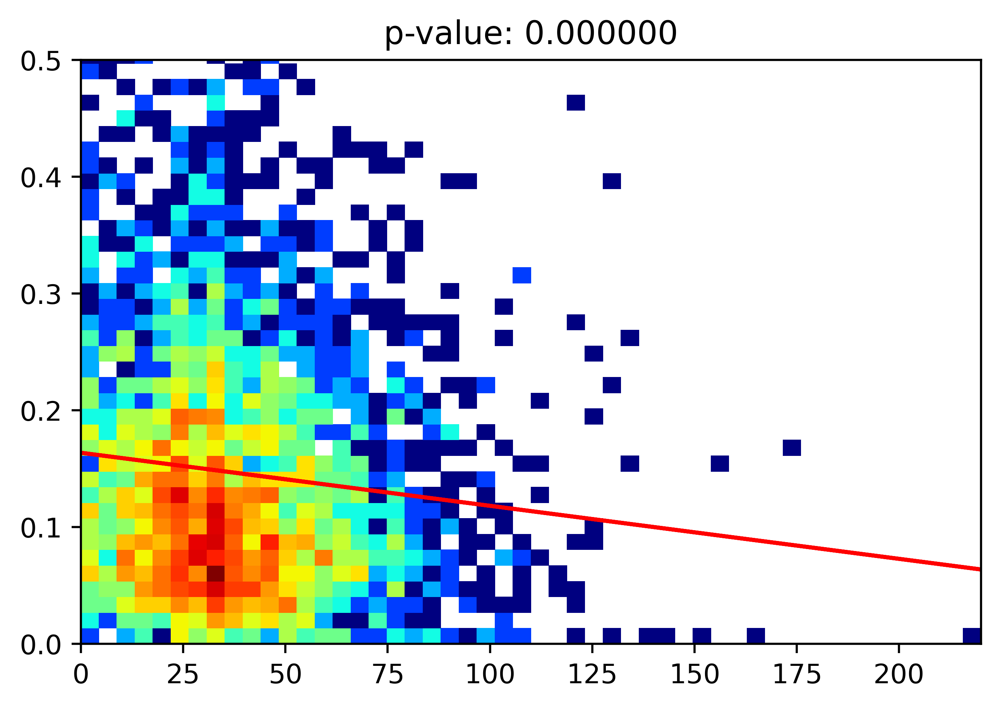

0.9543295380887861
pval 2.6935293393365286e-05
rval -0.06740848932099543


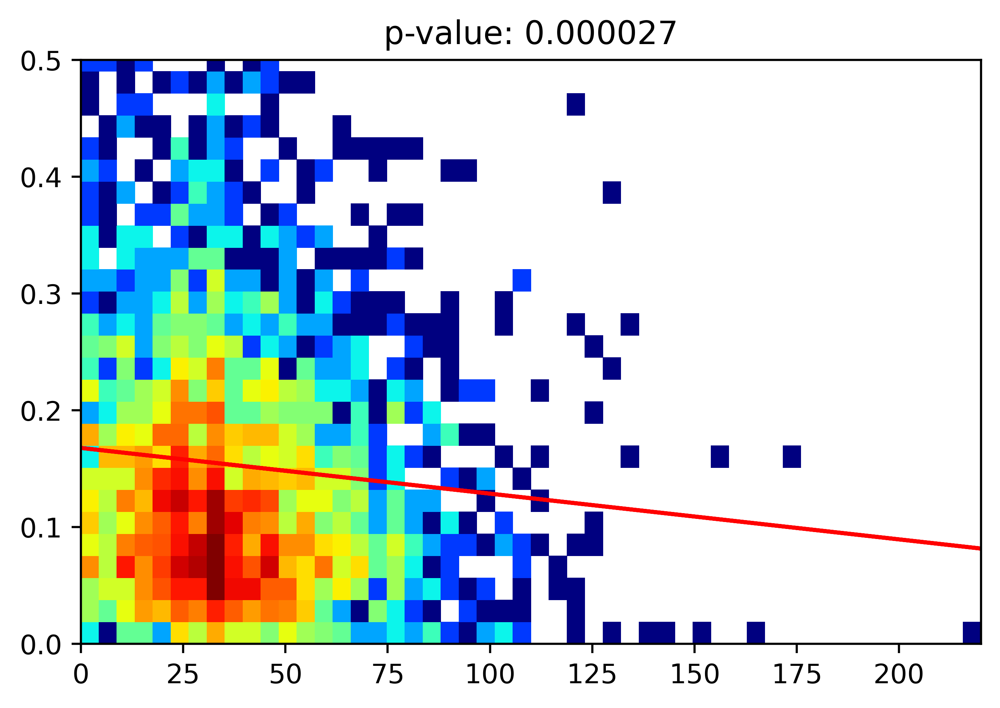

In [190]:
percentile_cutoff = np.arange(20,100,1)
int_thresh = 130

for thresh in percentile_cutoff:
    
    time_to_thresh = []
    
    percentile_value = np.percentile(separation_merged, thresh)
    print(percentile_value)
    seps_temp = []
    for i in range(len(channel_amplitudes_arpc3_positive)):
#         print(separation_merged[i])
        if separation_merged[i] <= percentile_value:
            
            seps_temp.append(separation_merged[i])
            
            dnm2_int = channel_amplitudes_arpc3_positive[i][1]

            index = next(x[0] for x in enumerate(dnm2_int) if x[1] > 100)

            time_to_thresh.append(index)
        
    res = stats.linregress(time_to_thresh, seps_temp)
    r_vals.append(res.pvalue)
    plt.hist2d(time_to_thresh,
             seps_temp,
             bins=50,
             norm=mpl.colors.LogNorm(),
             alpha=1,
             density=True,
             cmap='jet')
#     plt.scatter(time_to_thresh, separation_merged, alpha=0.2)
    plt.plot(time_to_thresh, res.intercept + res.slope*np.array(time_to_thresh), 'r', label='fitted line')
    plt.title(f"p-value: {res.pvalue:.6f}")
    print('pval', res.pvalue)
    print('rval', res.rvalue)
    plt.ylim(0,0.5)
    plt.show()




In [175]:
percentile_value

array([0.0372498 , 0.03948234, 0.04215194, 0.04361601, 0.04679468,
       0.04861197, 0.05023509, 0.05262377, 0.05464441, 0.05653834,
       0.05903405, 0.06058647, 0.06261624, 0.06426738, 0.06575711,
       0.06787701, 0.06973438, 0.07164386, 0.07347935, 0.07510573,
       0.07678801, 0.07864889, 0.0807976 , 0.08244233, 0.08411673,
       0.08637469, 0.08834085, 0.09059059, 0.09231331, 0.09468251,
       0.09678326, 0.09942785, 0.10179905, 0.10442978, 0.10703034,
       0.10957235, 0.11210185, 0.11431141, 0.11655804, 0.11875674,
       0.1207398 , 0.12296293, 0.12486354, 0.12721699, 0.13015105,
       0.13226251, 0.13450401, 0.13656014, 0.13896273, 0.14206386,
       0.14469523, 0.1485027 , 0.15176757, 0.15514276, 0.15837346,
       0.16171522, 0.16603281, 0.16939532, 0.17272987, 0.17688164,
       0.18080361, 0.1843987 , 0.18750571, 0.19160289, 0.19508964,
       0.19889976, 0.20422853, 0.21074047, 0.21476951, 0.21891579,
       0.2245317 , 0.23025201, 0.23856975, 0.24550948, 0.25173